<a href="https://colab.research.google.com/github/sungjindo/black_coal_price/blob/main/Prophet_parameter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1.모듈 불러오기**








In [1]:
# 기본 라이브러리
import pandas as pd
import numpy as np
import os

# 시각화 라이브러리
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-whitegrid')
from plotly.offline import init_notebook_mode, iplot #plotly offline mode 
init_notebook_mode(connected = True)
import plotly.graph_objs as go #plotly graphical object
%matplotlib notebook
%matplotlib inline

# 통계 및 기계학습 관련 라이브러리
from scipy import stats    # 통계 관련 라이브러리
from sklearn.model_selection import train_test_split, RandomizedSearchCV    # 데이터 셋 분류 라이브러리
from sklearn.utils import resample    # 데이터 업샘플링&다운샘플링 라이브러리
from imblearn.over_sampling import RandomOverSampler
from imblearn.combine import SMOTEENN    # 복합샘플링 라이브러리
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler    # 데이터 스케일링 라이브러리
from statsmodels.stats.outliers_influence import variance_inflation_factor    # 변수 간 다중공선성 확인(VIF) 라이브러리
from sklearn.metrics import (accuracy_score, confusion_matrix, classification_report, roc_auc_score, roc_curve, auc, plot_confusion_matrix, plot_roc_curve)    # 모델 정확도 검증 라이브러리
from sklearn.model_selection import cross_val_score, train_test_split   # validation  검증 라이브러리

import matplotlib.pyplot as plt
import matplotlib
plt.style.use('seaborn-whitegrid')
import statsmodels.api as sm    # 통계분석 관련 라이브러리
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_absolute_error


import warnings    # 경고문구 지우기
warnings.filterwarnings("ignore")

from fbprophet import Prophet
from fbprophet.plot import add_changepoints_to_plot
from fbprophet.plot import plot_plotly, plot_components_plotly
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error

from google.colab import drive
drive.mount('/content/gdrive')

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



Mounted at /content/gdrive


# **2.data**


In [2]:
df = pd.read_excel("/content/gdrive/My Drive/Black_coal/data/dataset/project_dataset.xlsx")
df = df.sort_values('date')
df['date']= pd.to_datetime(df['date'])

df = df.set_index('date')
df = df[df.index < '2019-04-01']
df = df.reset_index()
df

,date,Coal_price,iron,Brent_fut,copper_fut,WTI_fut,WTI,LNG_fut,bdi,USD/AUD(호주),...,영국지수,독일지수,S&P500지수,항셍지수,나스닥지수,코스피지수,니케이225지수,유로스톡스50지수,호주지수,캐나다지수
0,2011-01-01,122.65,168.30,94.75,9644.00,91.38,91.40,61.07,1773.0,0.98447,...,5899.899902,6914.189941,1257.640015,23035.449219,2652.870117,2051.000000,10228.919922,2807.040039,4745.200195,13443.200195
1,2011-01-02,122.65,168.30,94.75,9644.00,91.38,91.40,61.07,1773.0,0.98447,...,5899.899902,6914.189941,1257.640015,23035.449219,2652.870117,2051.000000,10228.919922,2807.040039,4745.200195,13443.200195
2,2011-01-03,136.50,170.00,94.84,9644.00,91.55,91.56,61.07,1773.0,0.97901,...,5899.899902,6989.740234,1271.869995,23436.050781,2691.520020,2070.080078,10228.919922,2839.429932,4745.200195,13443.200195
3,2011-01-04,137.30,172.10,93.53,9619.25,89.38,89.23,58.32,1693.0,0.98337,...,6013.899902,6975.350098,1270.199951,23668.480469,2681.250000,2085.139893,10398.099609,2844.169922,4742.500000,13402.299805
4,2011-01-05,130.65,174.50,95.50,9586.00,90.30,90.38,56.40,1621.0,0.99285,...,6043.899902,6939.819824,1276.560059,23757.820312,2702.199951,2082.550049,10380.769531,2833.739990,4714.899902,13396.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3007,2019-03-27,93.50,85.72,67.83,6336.00,59.41,59.12,37.47,690.0,1.40115,...,7194.200195,11419.040039,2805.370117,28728.250000,7643.379883,2145.620117,21378.730469,3322.040039,6136.000000,16132.500000
3008,2019-03-28,92.95,85.64,67.82,6368.75,59.30,59.30,36.05,692.0,1.41153,...,7234.299805,11428.160156,2815.439941,28775.210938,7669.169922,2128.100098,21033.759766,3320.290039,6176.100098,16155.500000
3009,2019-03-29,92.75,85.70,68.39,6475.75,60.14,59.98,34.61,689.0,1.41180,...,7279.200195,11526.040039,2834.399902,29051.359375,7729.319824,2140.669922,21205.810547,3351.709961,6180.700195,16102.099609
3010,2019-03-30,92.75,85.70,68.39,6475.75,60.14,59.98,34.61,689.0,1.41180,...,7279.200195,11526.040039,2834.399902,29051.359375,7729.319824,2140.669922,21205.810547,3351.709961,6180.700195,16102.099609


#3.Prameter조정 prophet model

1.   Trend

*   **changepoints**	트렌드 변화시점을 명시한 리스트값
*  **changepoint_prior_scale**	changepoint(trend) 의 유연성 조절
*   **n_changepoints**	changepoint 의 개수
*   **changepoint_range**	changepoint 설정 가능 범위. (기본적으로 데이터 중 80% 범위 내에서 changepoint를 설정합니다.)


2.   **Seasonality**
*  **yearly_seasonality**	연 계절성
*  **weekly_seasonality**	주 계절성
*  **daily_seasonality**	일 계절성
*  **seasonality_prior_scale**	계절성 반영 강도
*  **seasonality_mode**	‘additive ‘ 인지 ‘multiplicative’ 인지


##3.1 **Prophet model(all/3month)**
  -all 
  -3개월 prophet prediction


In [41]:
def prophetm(df, i, x, y, a, b ,c ,d, e) :
  
        #a = prophetm(z, x, y) 
        df1 = df.iloc[:,[0, i]]
      
    
        df1.columns = ['ds', 'y']
        df1['ds']= pd.to_datetime(df1['ds'])
        
      
        train = df1.drop(df.index[-x:])
        y_true = df1['y'][-y:].values 
        # shellscript
      
        last_1year = pd.date_range('2019-01-01', periods=90)
        last_1year = list(last_1year)
        last_1year = pd.DataFrame(last_1year, columns = ['ds'])
        last_1year['ds']= pd.to_datetime(last_1year['ds'])
        m = Prophet(
        # trend
                changepoint_prior_scale= a,
        # seasonality
                weekly_seasonality='auto',
                yearly_seasonality='auto',
              daily_seasonality='auto',
              seasonality_prior_scale=b,
              holidays_prior_scale=c)
        m.add_seasonality(name='monthly', period=d, fourier_order=e)
        forecast = m.fit(train).predict(last_1year)
        # fig = m.plot_components(forecast)
        # a = add_changepoints_to_plot(fig.gca(), m, forecast)
        y_pred = forecast['yhat'].values
       
        return y_pred, last_1year['ds']

# changepoint_prior_scale= a / 0.05
# seasonality_prior_scale=b /10
# holidays_prior_scale = c /10
# period = d /30.5
# fourier_order=e /1~5?

# def def __init__(growth='linear', changepoints=None, n_changepoints=25, changepoint_range=0.8, 
# yearly_seasonality='auto', weekly_seasonality='auto', daily_seasonality='auto', holidays=None, 
# seasonality_mode='additive', seasonality_prior_scale=10.0, holidays_prior_scale=10.0, changepoint_prior_scale=0.05, 
# mcmc_samples=0, interval_width=0.8, uncertainty_samples=1000, stan_backend=None)

# print('-------------done------------')
# print('y_pred result: {} '  .format(y_pred))


In [31]:
def prophety(df, i, y):
        df1 = df.iloc[:,[0, i]]
      
    
        df1.columns = ['ds', 'y']
        df1['ds']= pd.to_datetime(df1['ds'])
        
      
       
        y_true = df1['y'][-y:].values 
        last_1year = pd.date_range('2019-01-01', periods=90)
        last_1year = list(last_1year)
        last_1year = pd.DataFrame(last_1year, columns = ['ds'])
        last_1year['ds']= pd.to_datetime(last_1year['ds'])
        return y_true, last_1year['ds']
        

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


MAE: 6.029
MAPE: 0.071


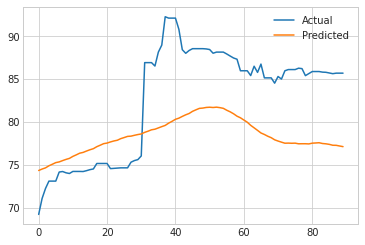

In [40]:
# # 함수에 적용과 데이터 프레임 만들어 값 넣어주기
# y_tt = prophetm(df, 2, -12, 90, 0.05, 10 ,10,30.5, 1)
# y_tt = pd.DataFrame(y_tt)
# y_tt = y_tt.T
# y_tt = y_tt.rename(columns ={0:'y_pred',1:'ds'})

# y_tr = prophety(df, 2, 90)
# y_tr = pd.DataFrame(y_tr)
# y_tr = y_tr.T
# y_tr = y_tr.rename(columns ={0:'y_true',1:'ds'})
# y_tr



# # print(y_tt)
# # print(y_true)

# # 예측하고 비교하기
# # 여기에서는 MAE를 살펴본다.

# y_pred = y_tt['y_pred'].values
# y_true = y_tr['y_true'].values
# from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
# mae = mean_absolute_error(y_true, y_pred)
# mape = mean_absolute_percentage_error(y_true, y_pred)

# print('MAE: %.3f' % mae)
# print('MAPE: %.3f' % mape)
# plt.plot(y_true, label='Actual')
# plt.plot(y_pred, label='Predicted')
# plt.legend()
# plt.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


i번째 feature:iron    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.142
MAPE: 0.072


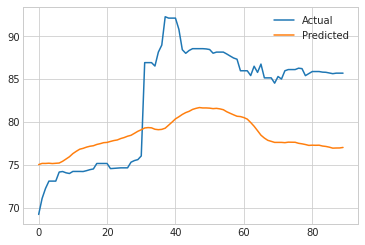

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:iron    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.449
MAPE: 0.076


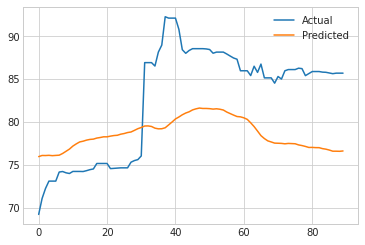

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:iron    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.420
MAPE: 0.076


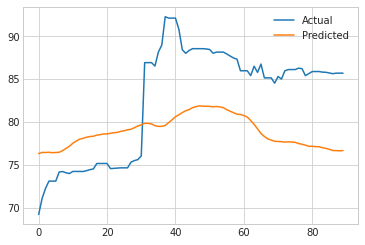

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:iron    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.402
MAPE: 0.076


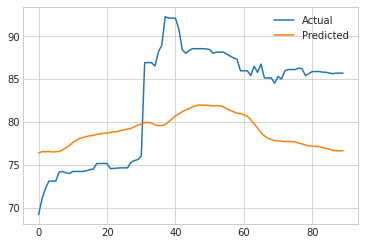

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:iron    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.376
MAPE: 0.076


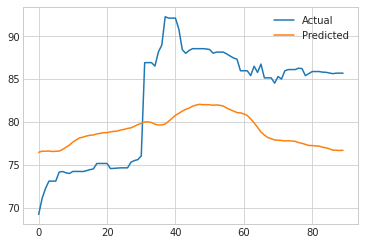

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:iron    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 6.342
MAPE: 0.075


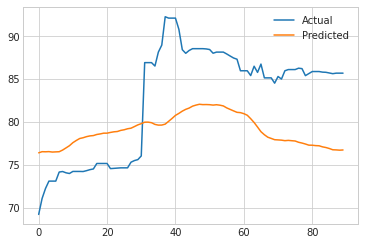

--------------------------------------------------------------------------------------------------------------
------a parameter is completed------


In [75]:
x=2
df_1= df.T
for i in range(x,x+1):
  for a in range(1,7):
    for b in range(10,11):
      for c in range(10,11):
        for d in range(4,5):


          y_tt = prophetm(df, i, 12, 90, 0.05*a, b ,c,30.5, d)
          y_tt = pd.DataFrame(y_tt)
          y_tt = y_tt.T
          y_tt = y_tt.rename(columns ={0:'y_pred',1:'ds'})

          y_tr = prophety(df, i, 90)
          y_tr = pd.DataFrame(y_tr)
          y_tr = y_tr.T
          y_tr = y_tr.rename(columns ={0:'y_true',1:'ds'})

          y_pred = y_tt['y_pred'].values
          y_true = y_tr['y_true'].values
          mae = mean_absolute_error(y_true, y_pred)
          mape = mean_absolute_percentage_error(y_true, y_pred)
          print('i번째 feature:'+str(df_1.index[i])+'    changepoint prior scale: '+str(a))
          print('seasonality_prior_scale: '+str(b)+'    holidays_prior_scale'+str(c)+'    fourier_order: '+str(d))
          print('MAE: %.3f' % mae)
          print('MAPE: %.3f' % mape)
          plt.plot(y_true, label='Actual')
          plt.plot(y_pred, label='Predicted')
          plt.legend()
          plt.show()
          print('--------------------------------------------------------------------------------------------------------------')
        
     
  print('------a parameter is completed------')

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


i번째 feature:Brent_fut    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.497
MAPE: 0.134


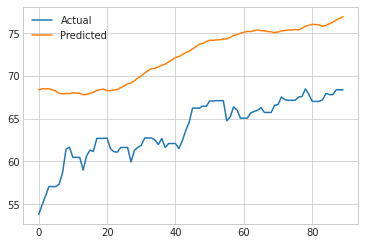

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:Brent_fut    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.684
MAPE: 0.137


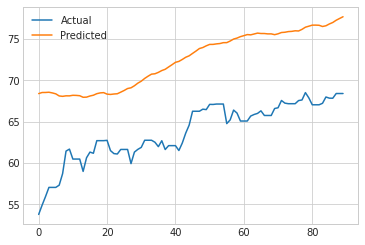

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:Brent_fut    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.400
MAPE: 0.132


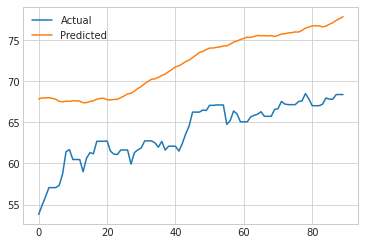

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:Brent_fut    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.153
MAPE: 0.128


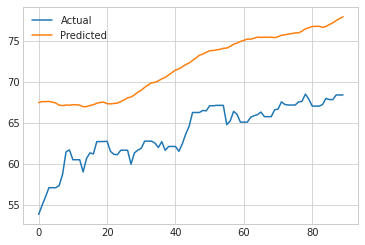

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:Brent_fut    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.072
MAPE: 0.127


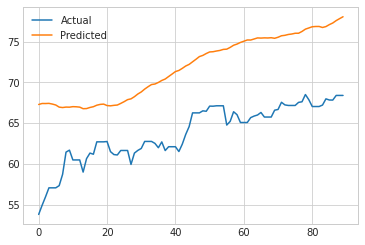

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:Brent_fut    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 7.978
MAPE: 0.125


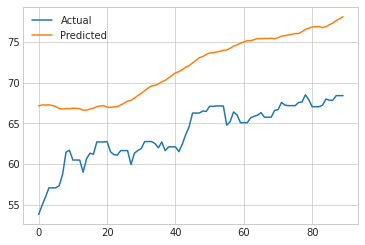

--------------------------------------------------------------------------------------------------------------
------a parameter is completed------


In [76]:
x=3
df_1= df.T
for i in range(x,x+1):
  for a in range(1,7):
    for b in range(10,11):
      for c in range(10,11):
        for d in range(4,5):


          y_tt = prophetm(df, i, 12, 90, 0.05*a, b ,c,30.5, d)
          y_tt = pd.DataFrame(y_tt)
          y_tt = y_tt.T
          y_tt = y_tt.rename(columns ={0:'y_pred',1:'ds'})

          y_tr = prophety(df, i, 90)
          y_tr = pd.DataFrame(y_tr)
          y_tr = y_tr.T
          y_tr = y_tr.rename(columns ={0:'y_true',1:'ds'})

          y_pred = y_tt['y_pred'].values
          y_true = y_tr['y_true'].values
          mae = mean_absolute_error(y_true, y_pred)
          mape = mean_absolute_percentage_error(y_true, y_pred)
          print('i번째 feature:'+str(df_1.index[i])+'    changepoint prior scale: '+str(a))
          print('seasonality_prior_scale: '+str(b)+'    holidays_prior_scale'+str(c)+'    fourier_order: '+str(d))
          print('MAE: %.3f' % mae)
          print('MAPE: %.3f' % mape)
          plt.plot(y_true, label='Actual')
          plt.plot(y_pred, label='Predicted')
          plt.legend()
          plt.show()
          print('--------------------------------------------------------------------------------------------------------------')
        
     
  print('------a parameter is completed------')

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


i번째 feature:copper_fut    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 205.445
MAPE: 0.034


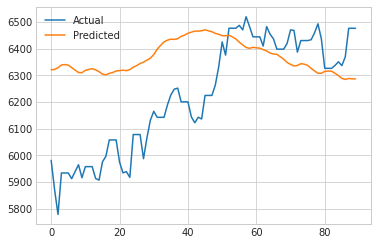

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 206.717
MAPE: 0.034


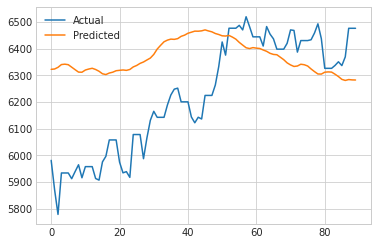

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 205.512
MAPE: 0.034


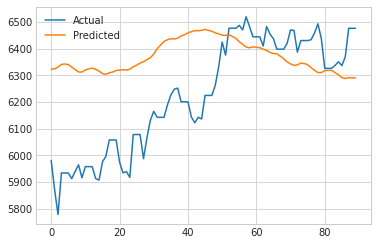

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 207.378
MAPE: 0.034


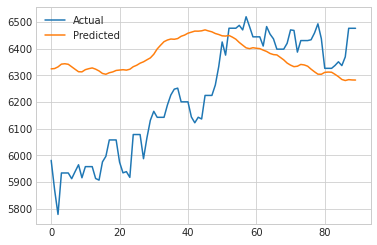

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 202.961
MAPE: 0.033


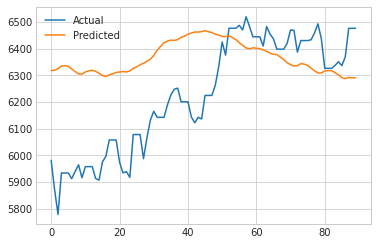

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:copper_fut    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 201.050
MAPE: 0.033


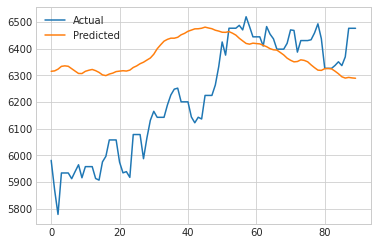

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 199.125
MAPE: 0.033


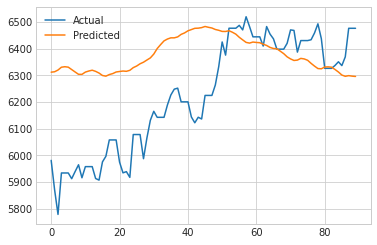

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 202.831
MAPE: 0.033


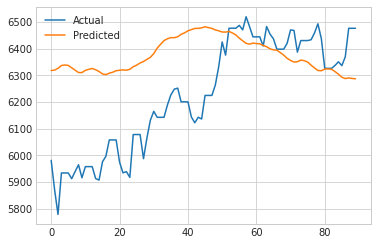

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 201.285
MAPE: 0.033


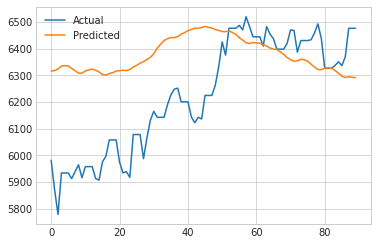

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 202.703
MAPE: 0.033


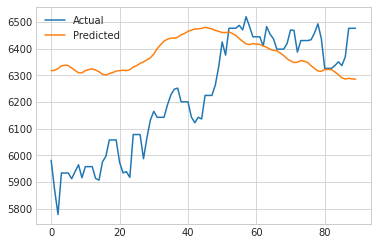

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:copper_fut    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 192.167
MAPE: 0.032


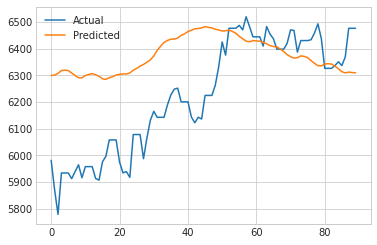

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 186.257
MAPE: 0.031


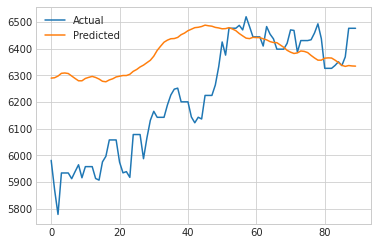

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 187.459
MAPE: 0.031


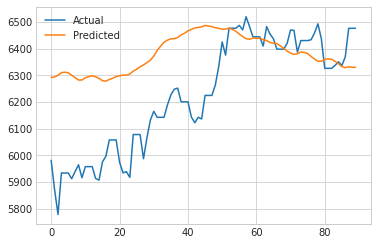

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 187.799
MAPE: 0.031


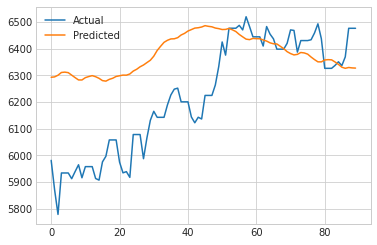

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 192.768
MAPE: 0.032


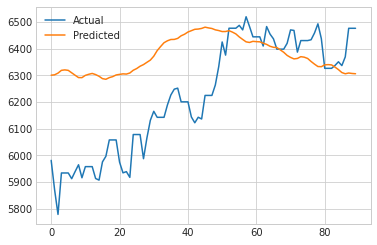

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:copper_fut    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 182.257
MAPE: 0.030


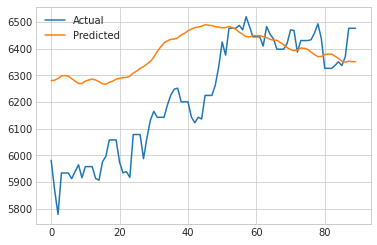

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 182.317
MAPE: 0.030


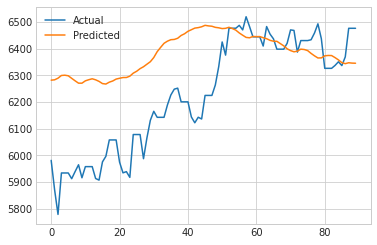

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 183.659
MAPE: 0.030


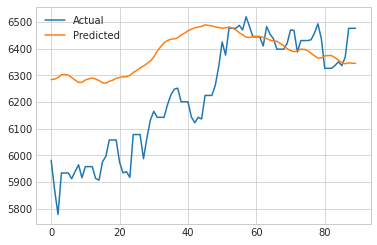

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 181.338
MAPE: 0.030


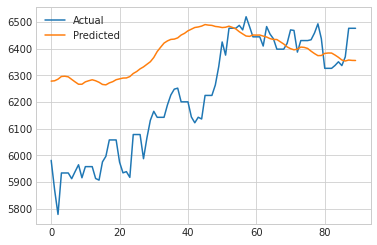

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 181.969
MAPE: 0.030


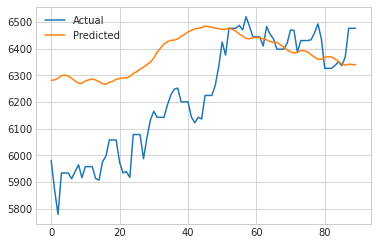

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:copper_fut    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 180.579
MAPE: 0.030


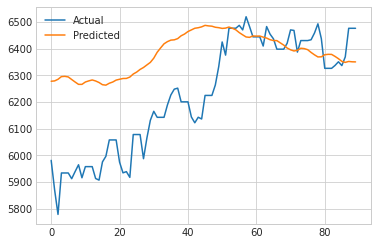

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 178.895
MAPE: 0.029


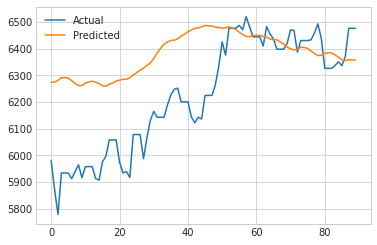

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 180.301
MAPE: 0.030


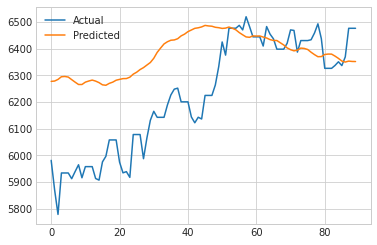

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 180.761
MAPE: 0.030


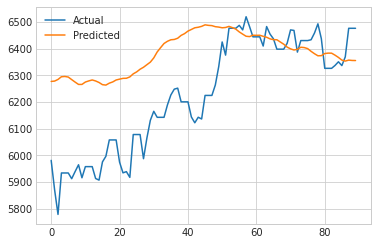

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 180.983
MAPE: 0.030


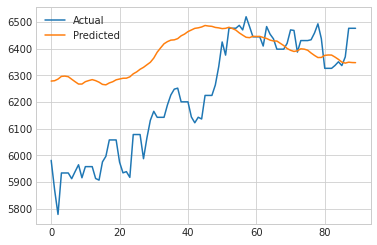

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:copper_fut    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 178.842
MAPE: 0.029


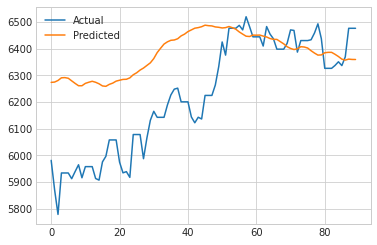

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 176.298
MAPE: 0.029


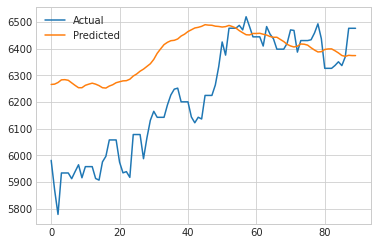

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 178.249
MAPE: 0.029


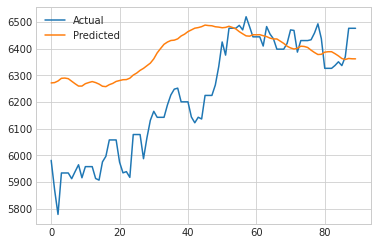

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 178.098
MAPE: 0.029


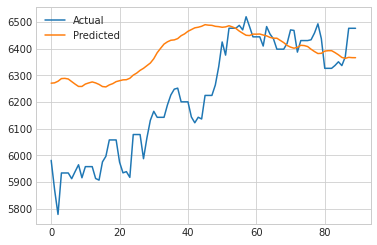

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:copper_fut    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 177.405
MAPE: 0.029


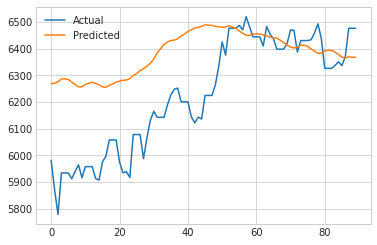

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.350
MAPE: 0.154


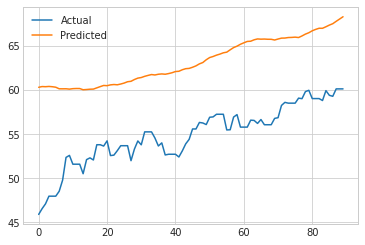

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.352
MAPE: 0.154


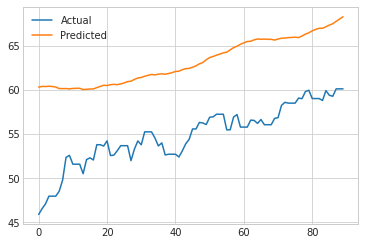

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.401
MAPE: 0.155


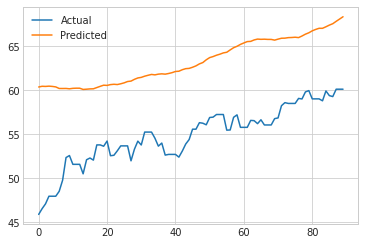

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.344
MAPE: 0.154


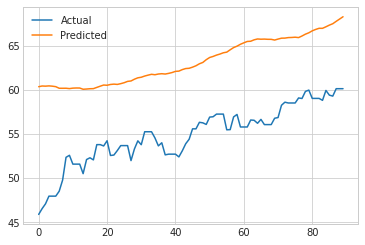

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.305
MAPE: 0.153


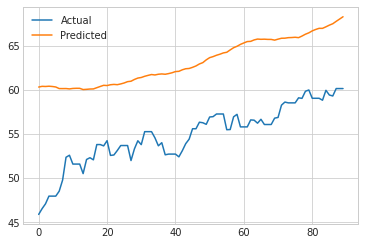

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.498
MAPE: 0.157


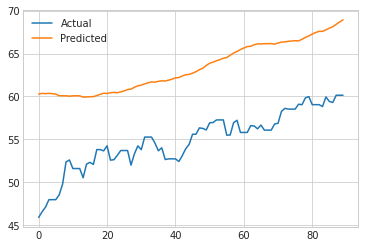

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.526
MAPE: 0.157


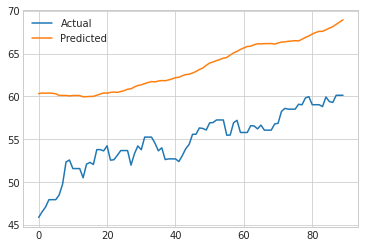

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.496
MAPE: 0.157


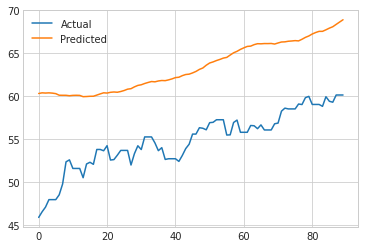

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.479
MAPE: 0.156


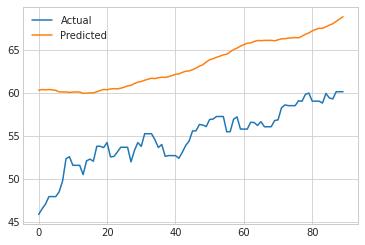

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.508
MAPE: 0.157


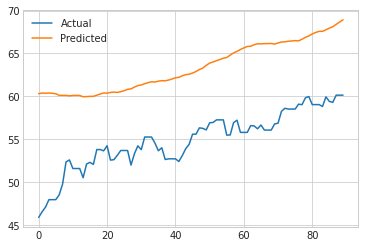

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.315
MAPE: 0.153


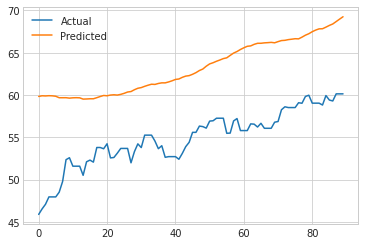

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.264
MAPE: 0.152


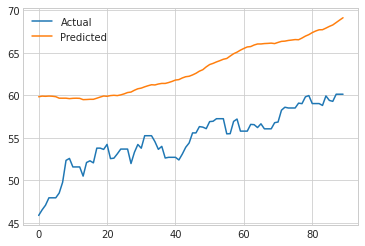

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.272
MAPE: 0.152


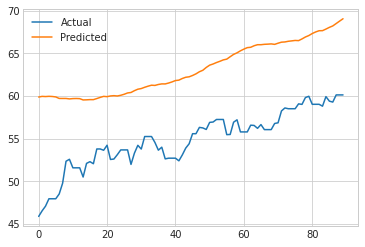

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.302
MAPE: 0.153


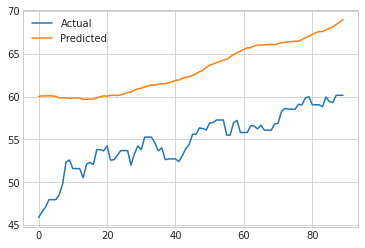

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.304
MAPE: 0.153


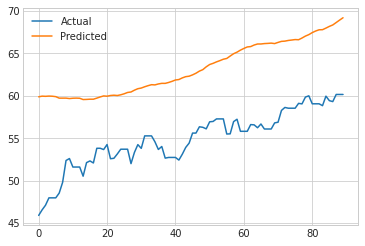

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.206
MAPE: 0.151


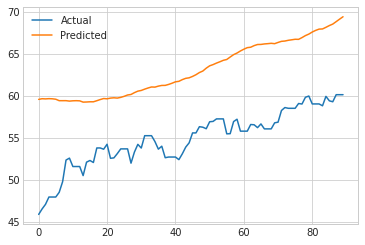

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.203
MAPE: 0.151


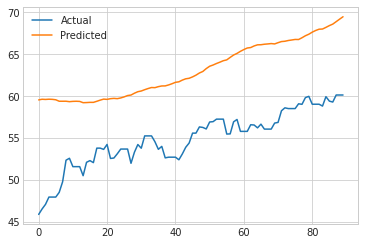

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.195
MAPE: 0.150


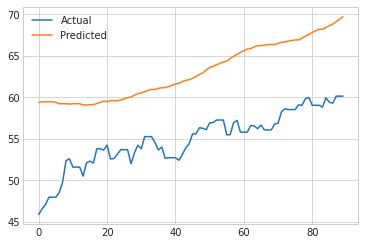

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.195
MAPE: 0.151


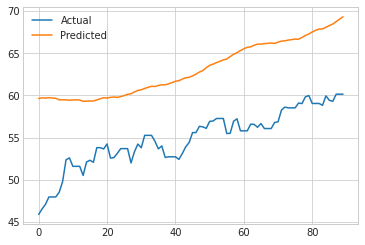

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.184
MAPE: 0.150


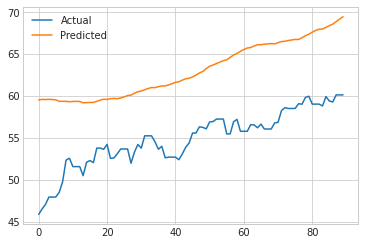

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.121
MAPE: 0.149


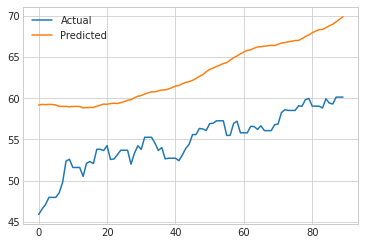

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.088
MAPE: 0.149


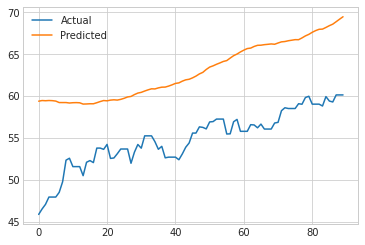

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.118
MAPE: 0.149


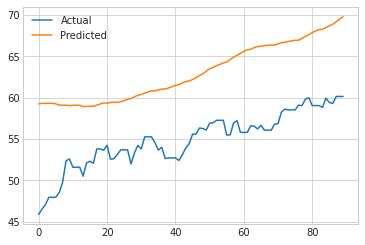

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.121
MAPE: 0.149


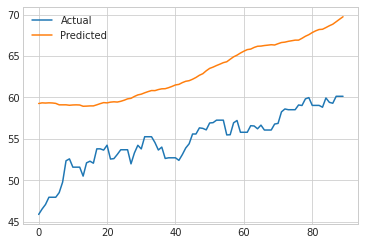

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.115
MAPE: 0.149


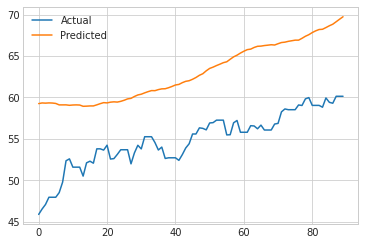

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI_fut    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.088
MAPE: 0.148


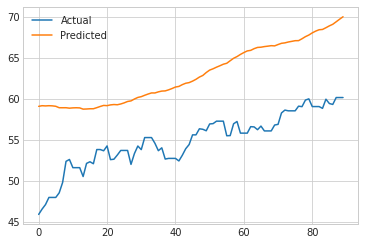

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.034
MAPE: 0.148


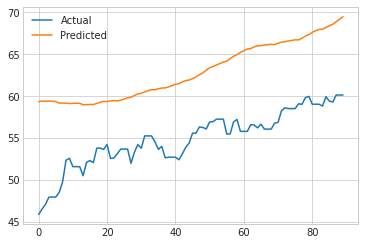

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.062
MAPE: 0.148


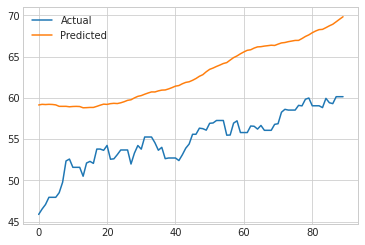

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.044
MAPE: 0.148


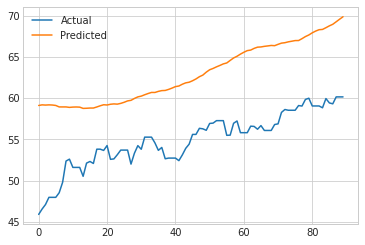

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI_fut    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.060
MAPE: 0.148


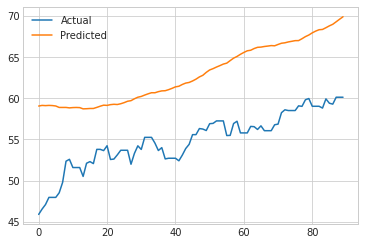

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:WTI    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.564
MAPE: 0.158


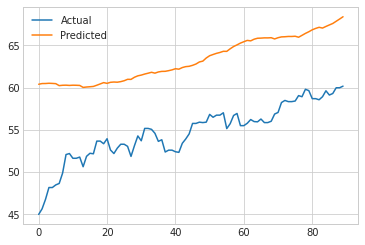

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.536
MAPE: 0.158


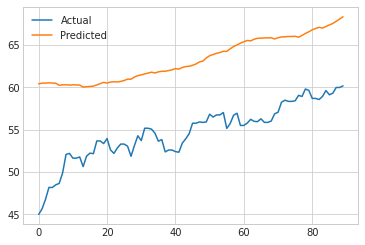

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.529
MAPE: 0.158


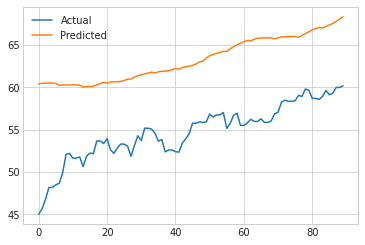

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.620
MAPE: 0.159


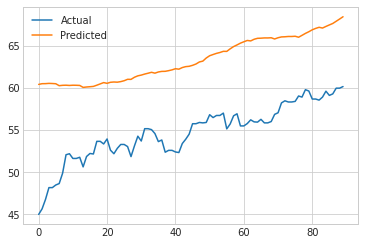

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.553
MAPE: 0.158


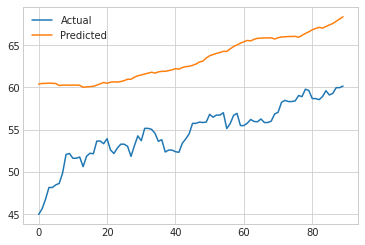

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.680
MAPE: 0.160


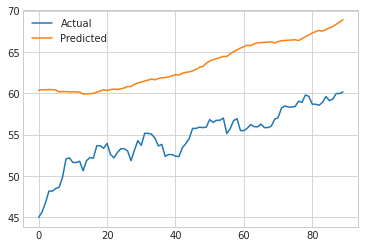

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.653
MAPE: 0.160


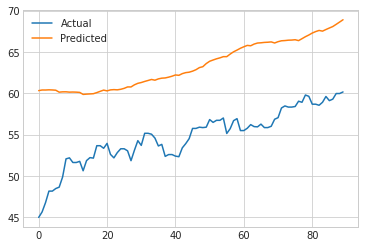

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.680
MAPE: 0.160


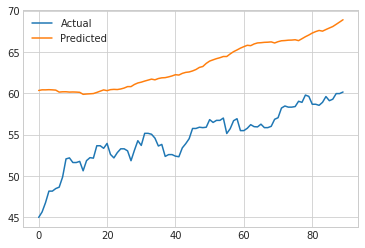

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.714
MAPE: 0.161


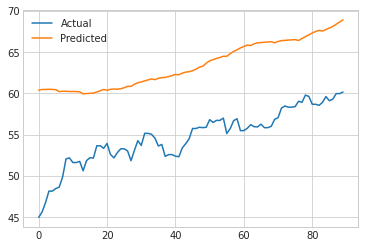

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.688
MAPE: 0.161


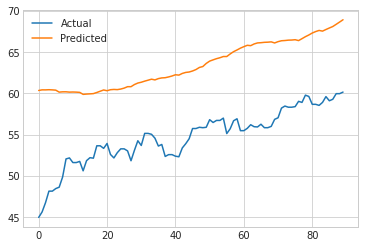

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.460
MAPE: 0.156


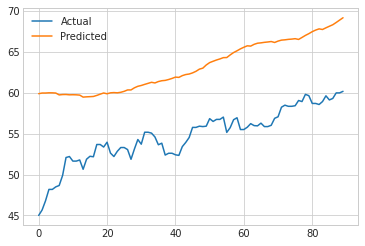

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.469
MAPE: 0.156


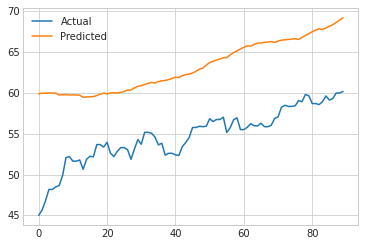

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.460
MAPE: 0.156


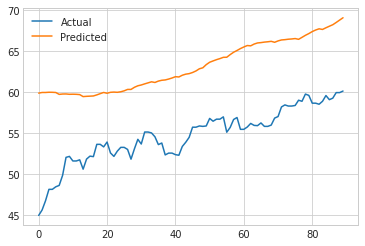

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.465
MAPE: 0.156


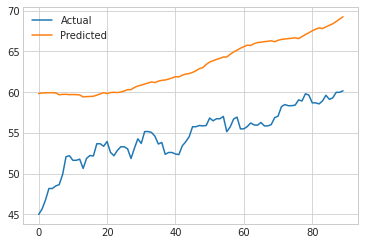

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.466
MAPE: 0.156


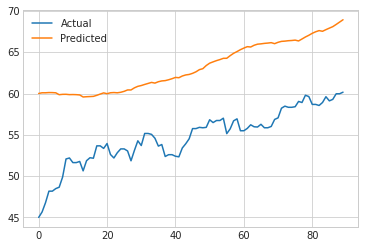

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.346
MAPE: 0.154


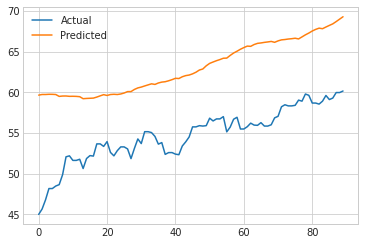

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.361
MAPE: 0.154


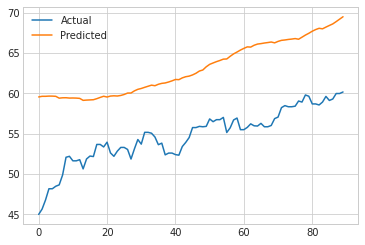

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.355
MAPE: 0.154


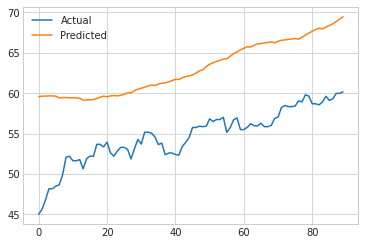

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.364
MAPE: 0.154


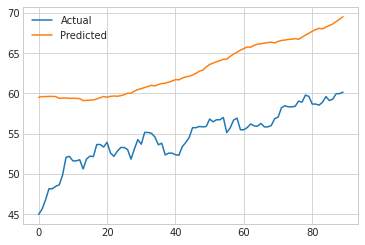

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.360
MAPE: 0.154


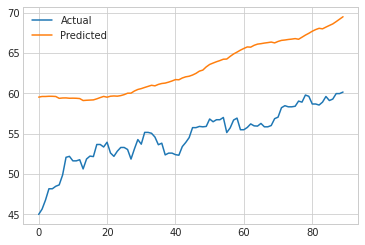

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.265
MAPE: 0.152


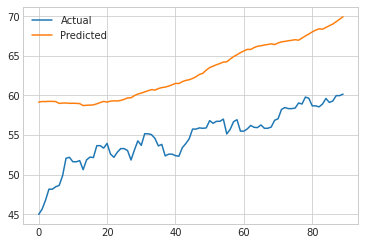

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.296
MAPE: 0.153


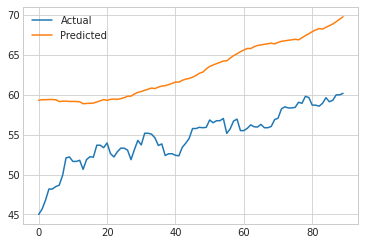

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.274
MAPE: 0.152


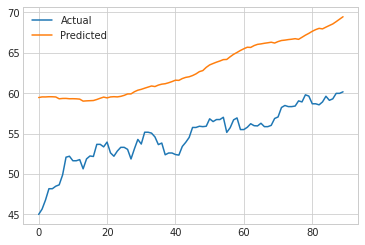

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.259
MAPE: 0.152


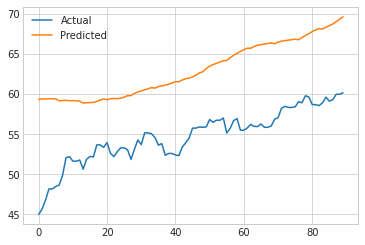

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.290
MAPE: 0.153


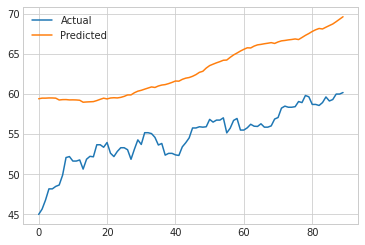

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:WTI    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 8.248
MAPE: 0.152


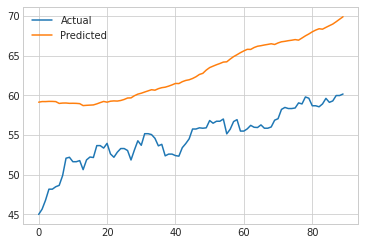

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 8.219
MAPE: 0.151


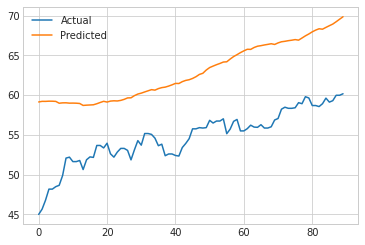

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 8.198
MAPE: 0.151


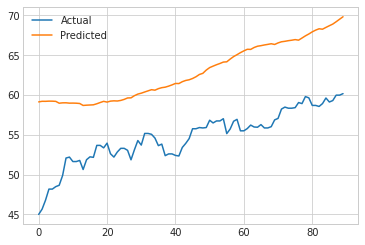

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 8.226
MAPE: 0.151


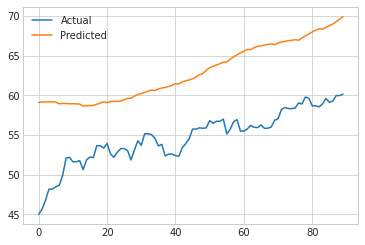

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:WTI    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 8.221
MAPE: 0.151


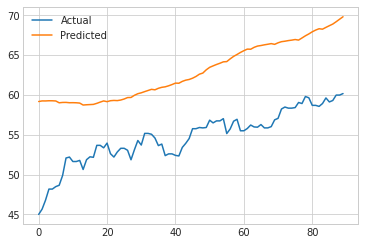

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 13.066
MAPE: 0.312


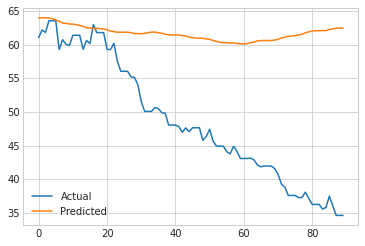

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 13.113
MAPE: 0.313


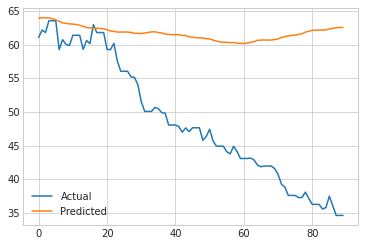

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 13.059
MAPE: 0.312


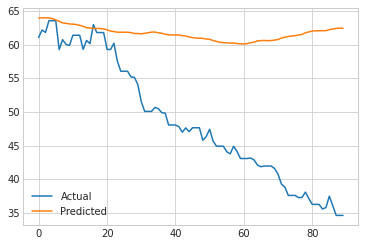

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 13.064
MAPE: 0.312


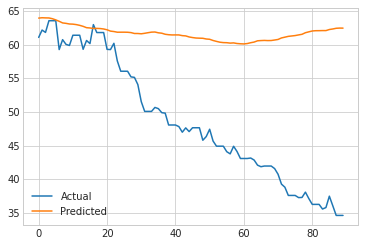

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 13.146
MAPE: 0.314


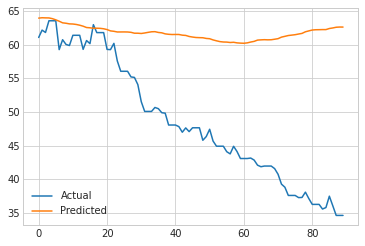

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 13.220
MAPE: 0.315


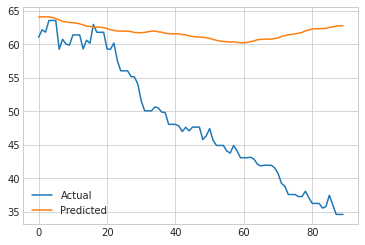

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 13.196
MAPE: 0.315


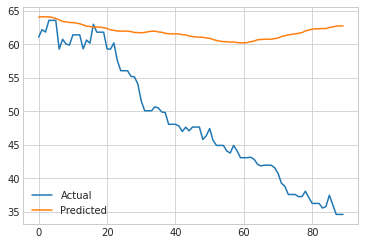

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 13.151
MAPE: 0.314


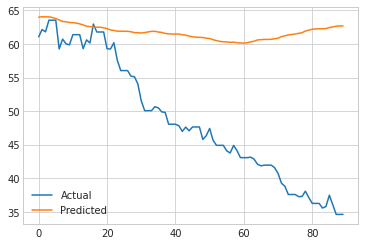

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 13.227
MAPE: 0.315


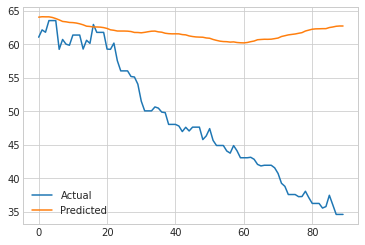

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 13.203
MAPE: 0.315


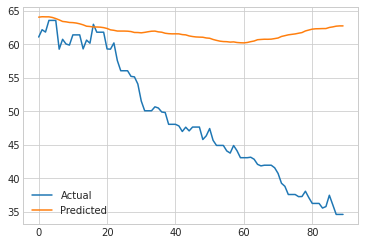

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 12.677
MAPE: 0.304


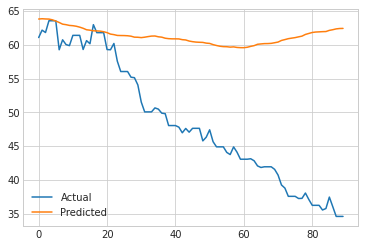

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 12.655
MAPE: 0.303


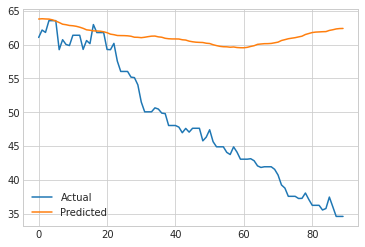

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 12.655
MAPE: 0.303


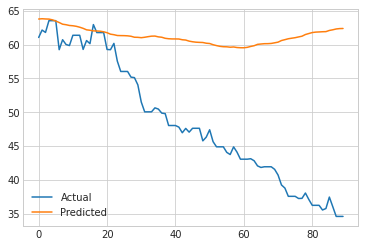

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 12.653
MAPE: 0.303


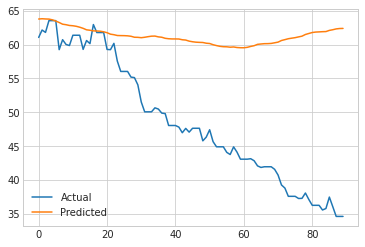

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 12.753
MAPE: 0.305


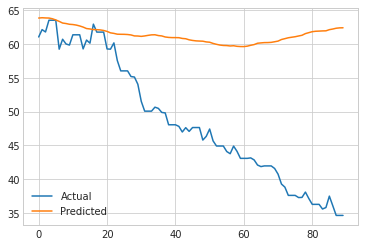

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 12.521
MAPE: 0.300


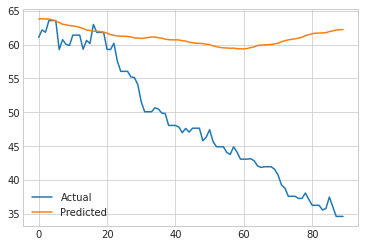

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 12.528
MAPE: 0.300


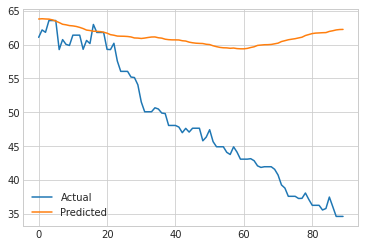

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 12.498
MAPE: 0.300


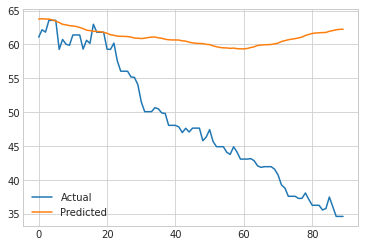

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 12.507
MAPE: 0.300


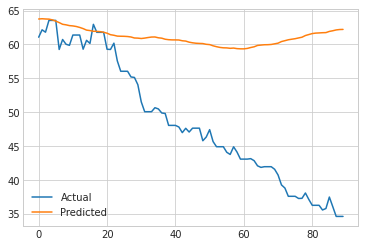

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 12.479
MAPE: 0.299


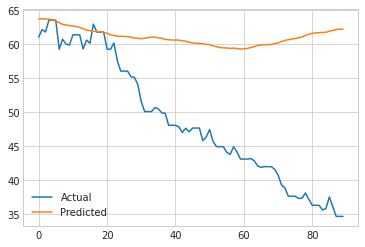

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 12.263
MAPE: 0.295


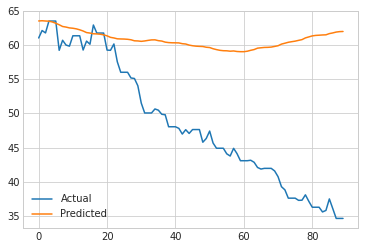

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 12.246
MAPE: 0.294


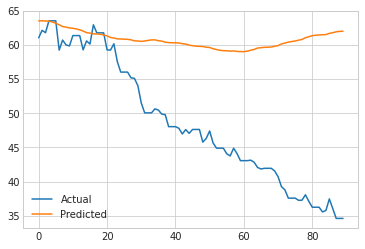

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 12.285
MAPE: 0.295


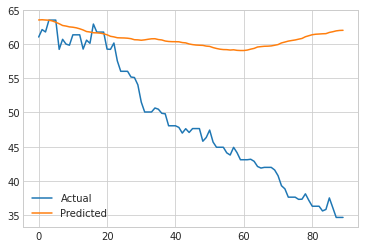

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 12.281
MAPE: 0.295


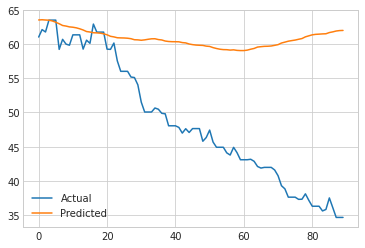

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 12.279
MAPE: 0.295


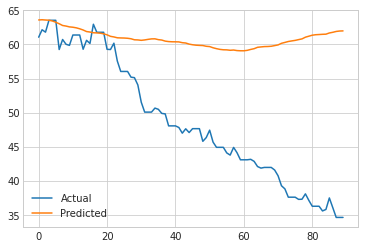

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:LNG_fut    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 12.100
MAPE: 0.291


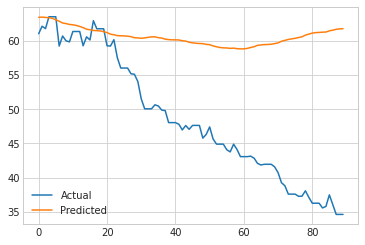

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 12.075
MAPE: 0.290


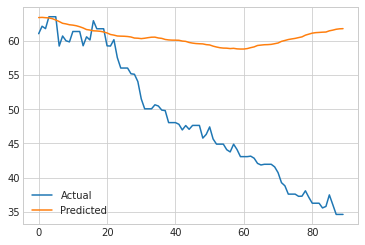

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 12.076
MAPE: 0.290


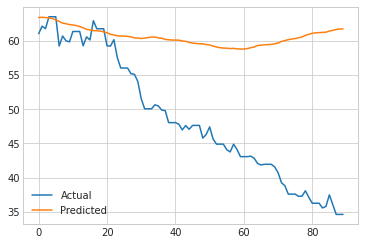

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 12.069
MAPE: 0.290


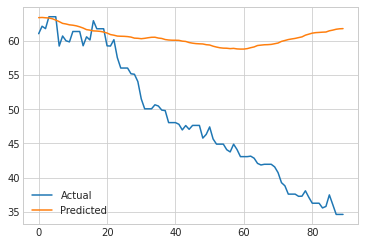

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:LNG_fut    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 12.103
MAPE: 0.291


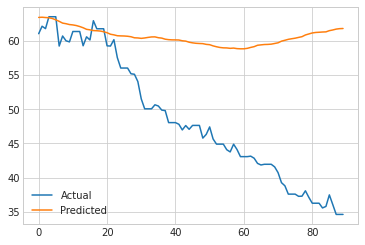

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:bdi    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 276.069
MAPE: 0.407


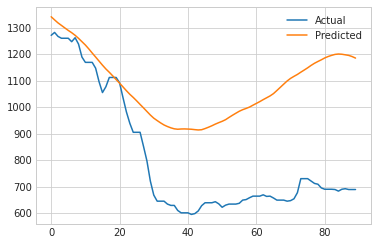

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 277.308
MAPE: 0.409


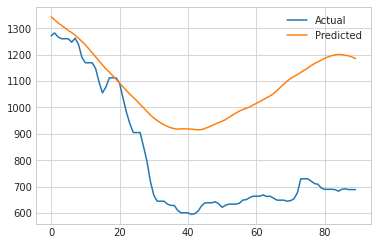

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 277.832
MAPE: 0.410


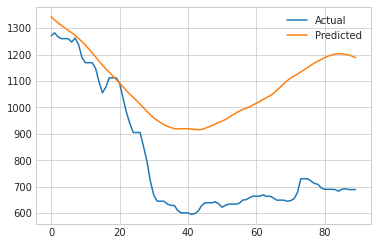

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 276.635
MAPE: 0.408


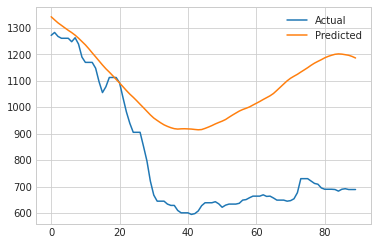

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 277.073
MAPE: 0.409


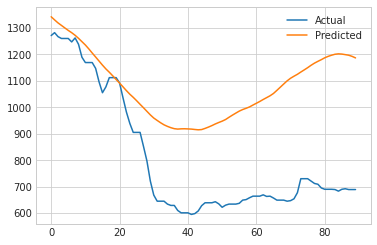

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:bdi    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 265.177
MAPE: 0.392


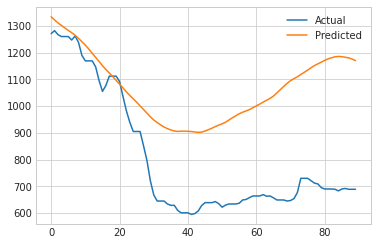

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 265.549
MAPE: 0.393


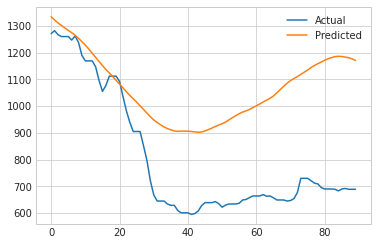

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 264.418
MAPE: 0.391


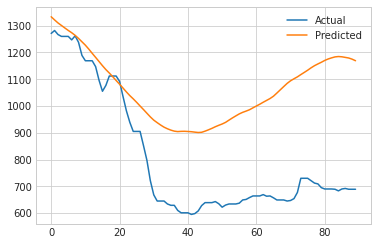

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 266.138
MAPE: 0.393


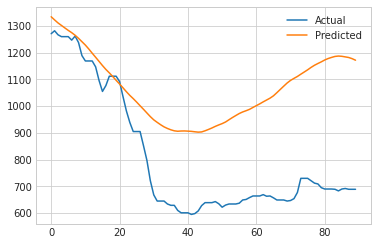

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 264.459
MAPE: 0.391


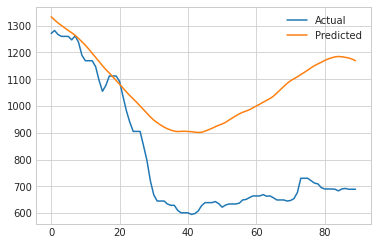

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:bdi    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 262.618
MAPE: 0.389


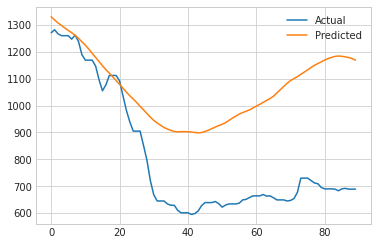

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 264.410
MAPE: 0.391


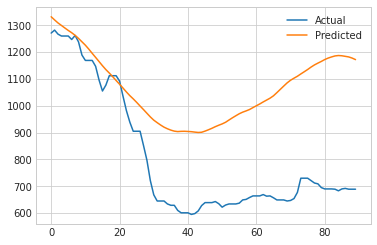

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 263.971
MAPE: 0.391


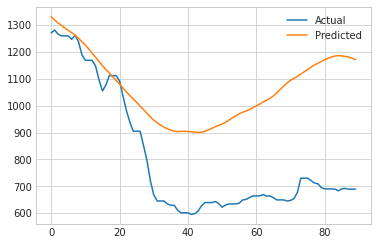

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 263.346
MAPE: 0.390


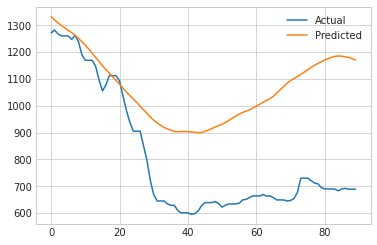

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 262.889
MAPE: 0.389


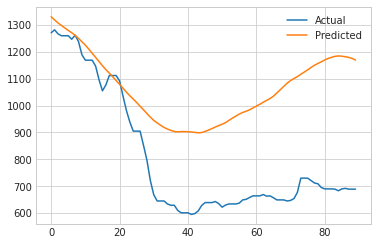

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:bdi    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 267.688
MAPE: 0.396


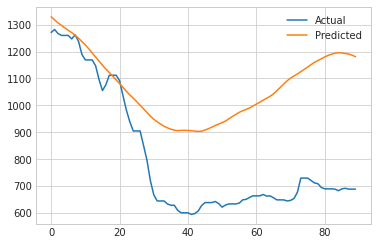

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 267.751
MAPE: 0.396


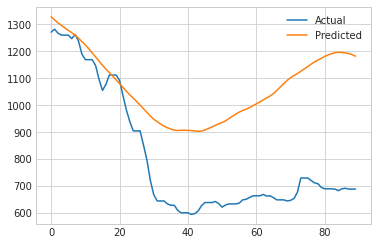

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 267.473
MAPE: 0.396


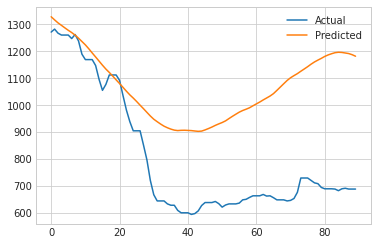

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 268.928
MAPE: 0.398


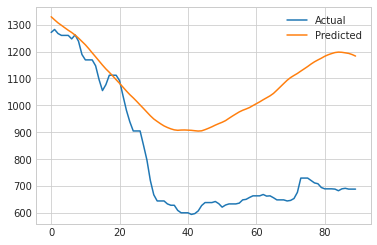

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 268.226
MAPE: 0.397


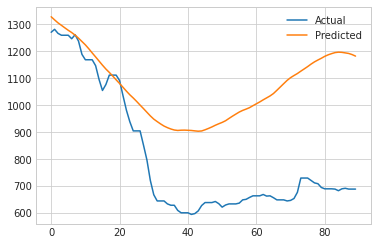

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:bdi    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 268.153
MAPE: 0.397


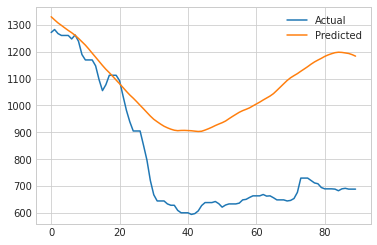

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 267.749
MAPE: 0.396


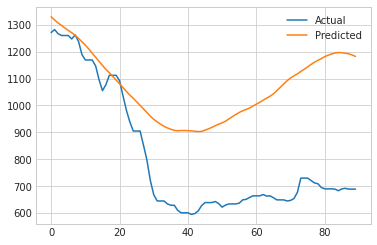

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 268.391
MAPE: 0.397


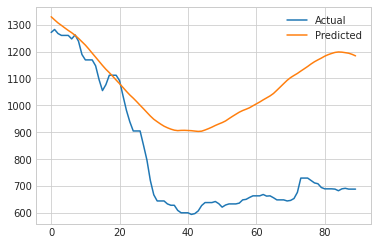

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 267.887
MAPE: 0.396


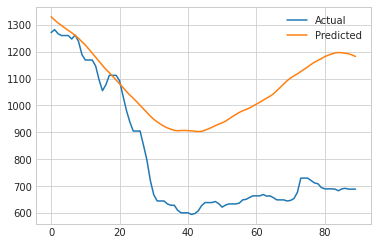

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 268.329
MAPE: 0.397


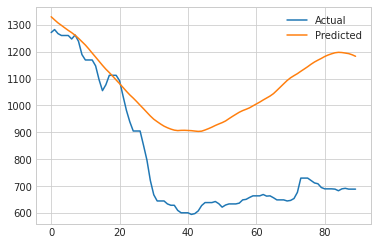

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:bdi    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 265.111
MAPE: 0.393


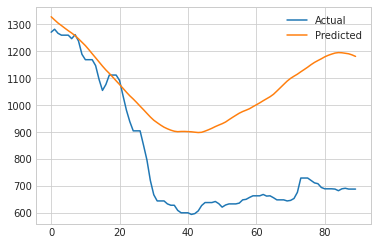

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 264.454
MAPE: 0.391


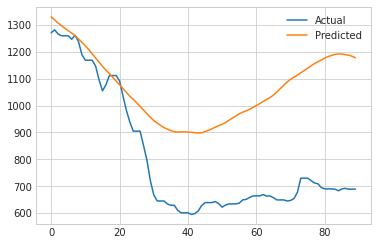

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 264.533
MAPE: 0.392


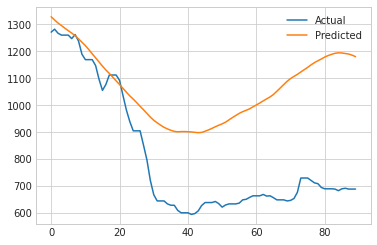

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 264.103
MAPE: 0.391


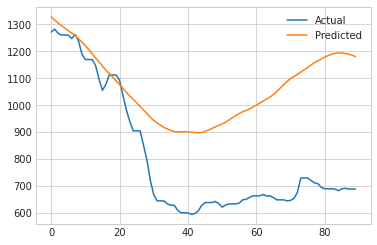

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:bdi    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 264.704
MAPE: 0.392


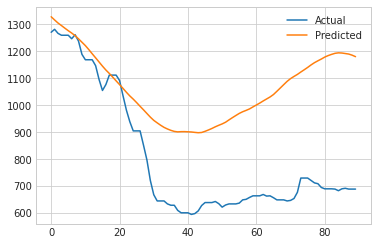

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.012
MAPE: 0.009


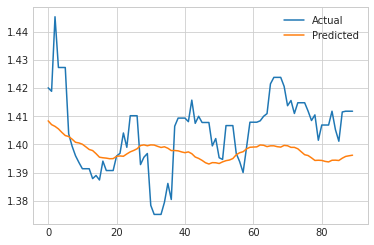

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.012
MAPE: 0.009


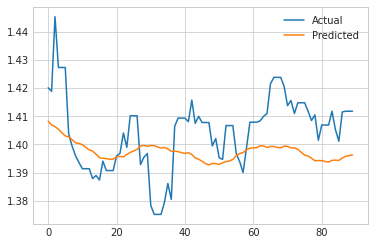

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.012
MAPE: 0.008


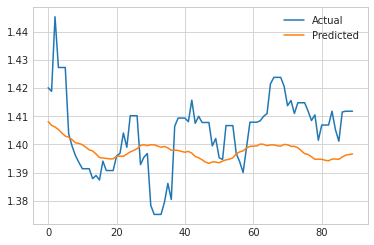

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.012
MAPE: 0.009


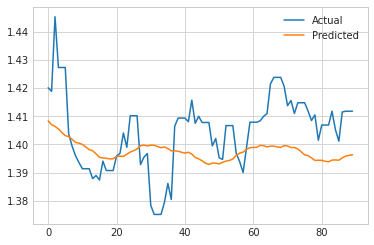

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.012
MAPE: 0.009


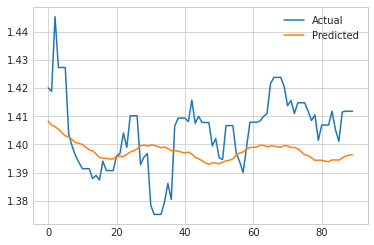

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.013
MAPE: 0.009


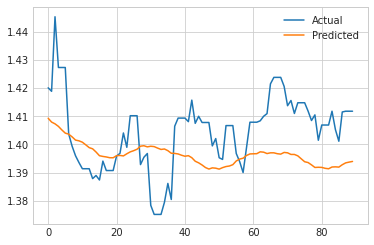

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.013
MAPE: 0.009


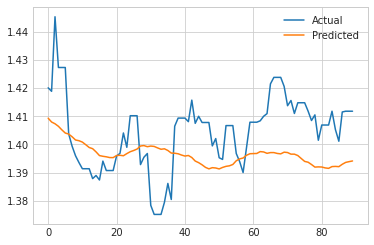

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.013
MAPE: 0.009


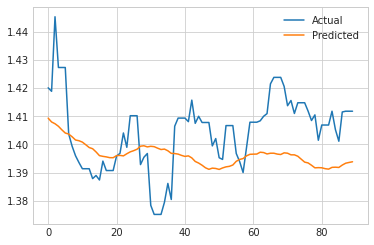

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.013
MAPE: 0.009


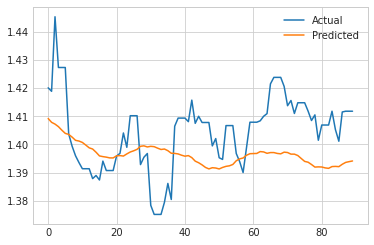

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.013
MAPE: 0.009


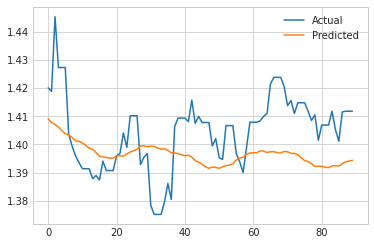

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


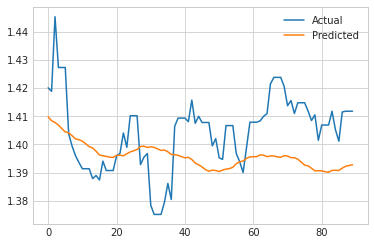

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


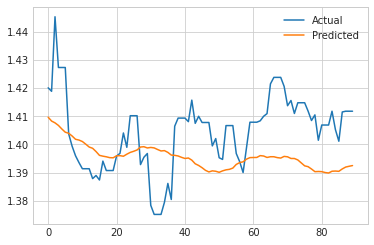

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


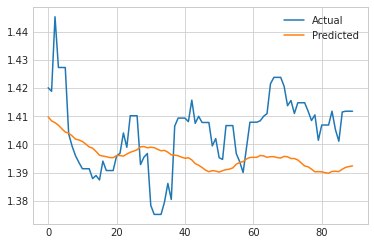

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


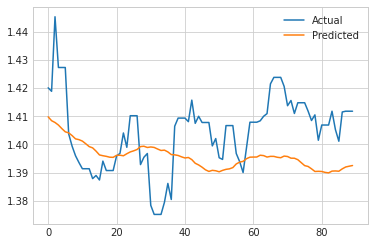

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


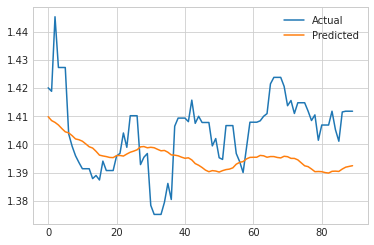

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


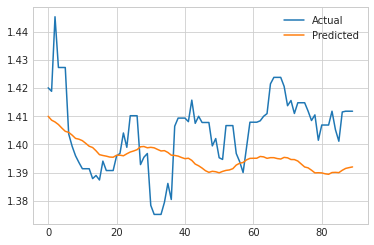

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


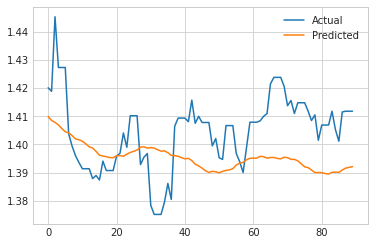

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


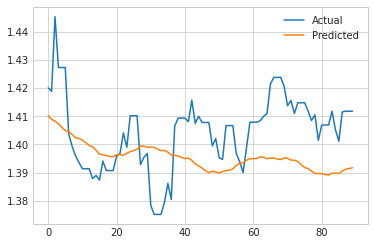

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


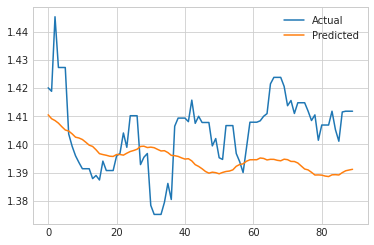

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


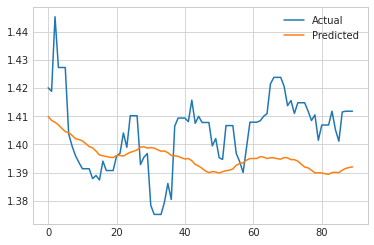

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


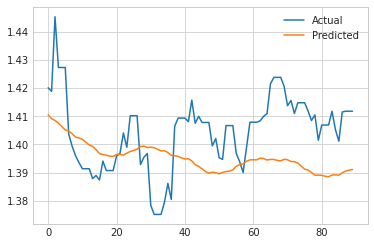

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


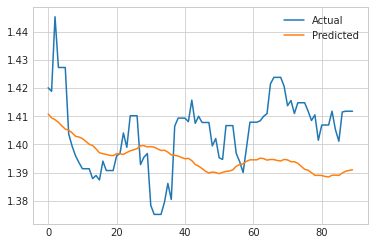

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


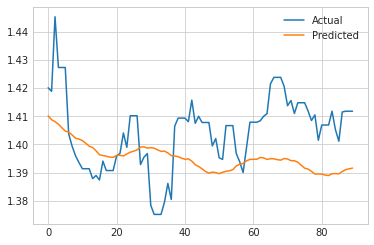

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


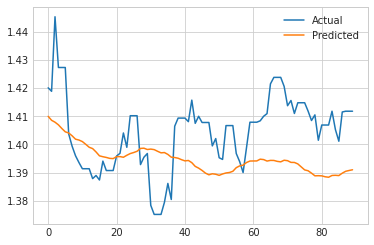

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


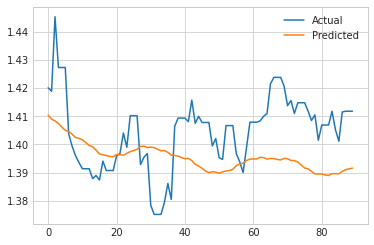

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


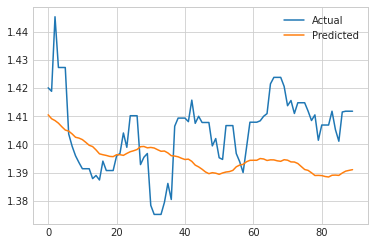

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


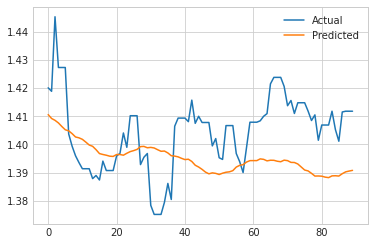

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


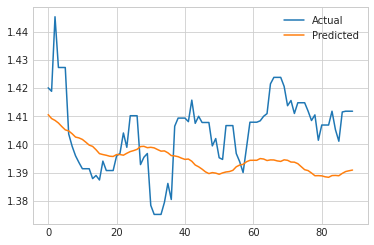

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


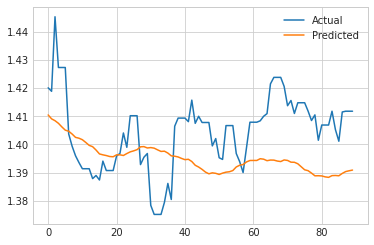

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/AUD(호주)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.014
MAPE: 0.010


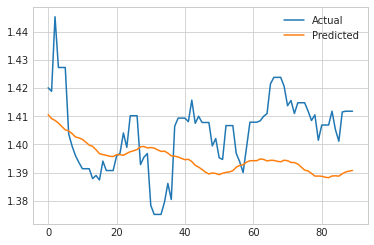

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


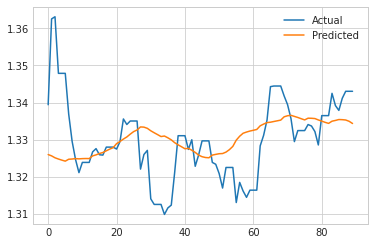

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


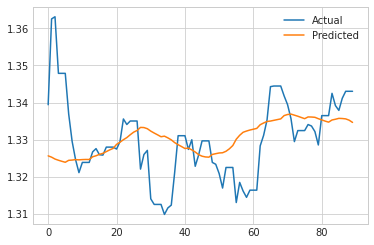

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


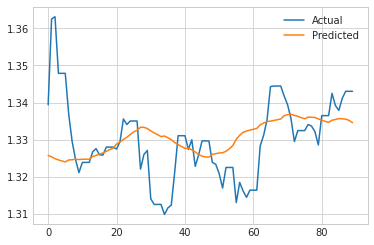

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


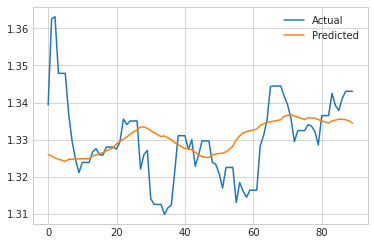

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


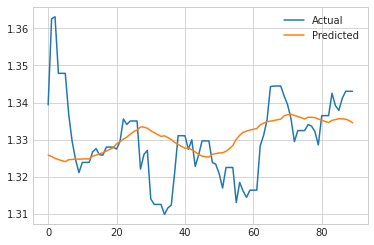

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


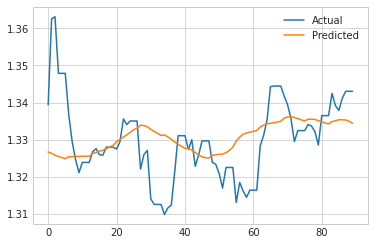

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


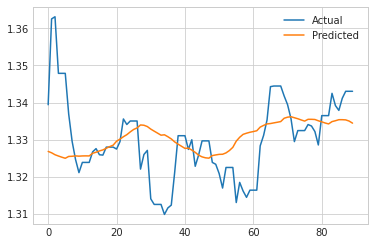

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


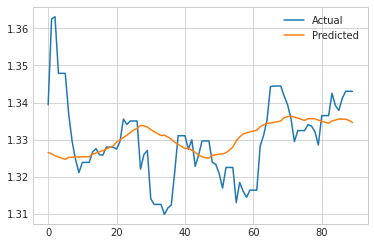

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


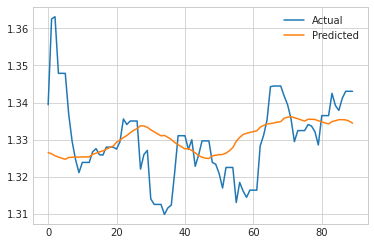

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


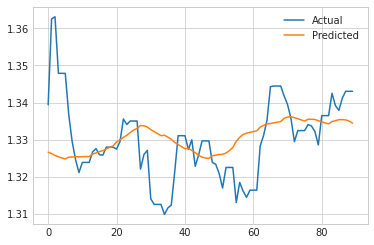

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.007
MAPE: 0.006


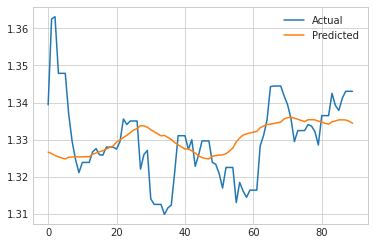

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


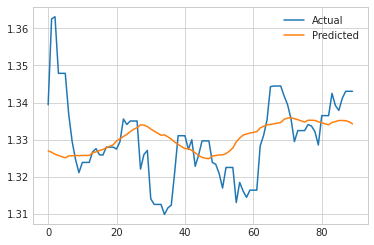

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


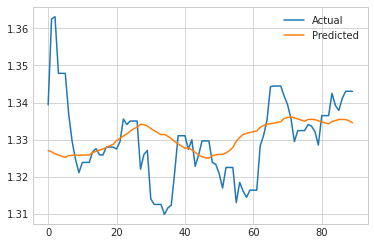

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


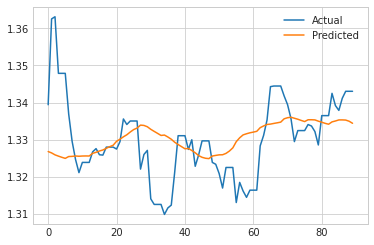

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


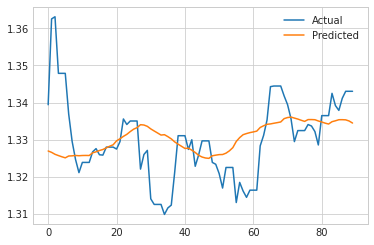

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


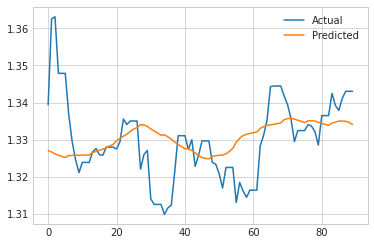

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


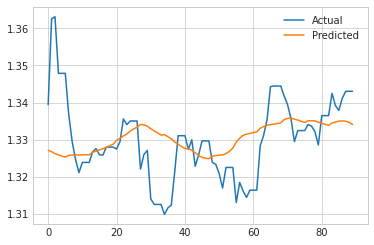

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


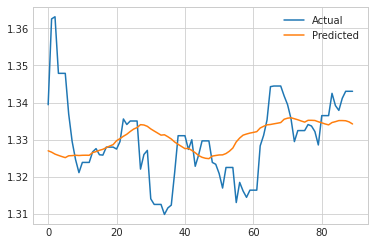

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


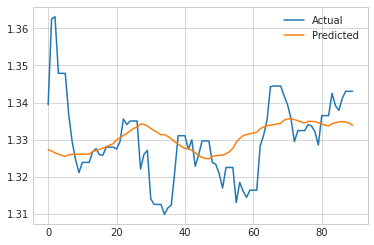

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


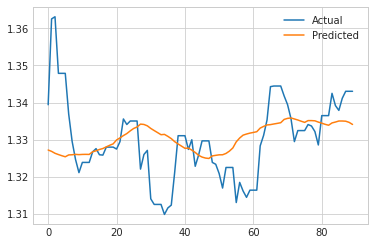

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


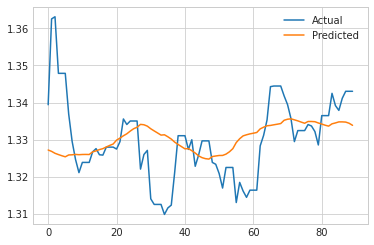

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


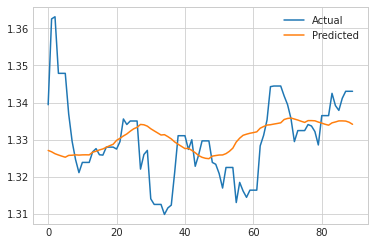

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


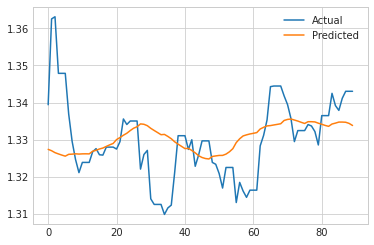

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


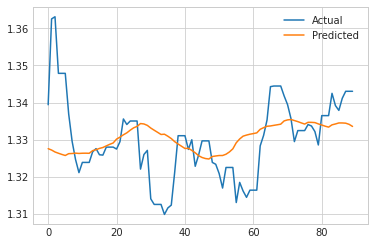

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


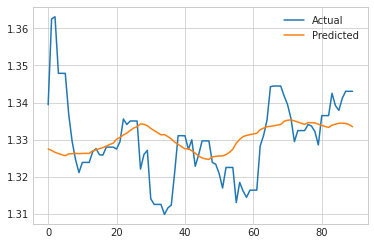

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


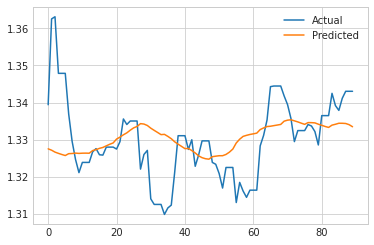

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


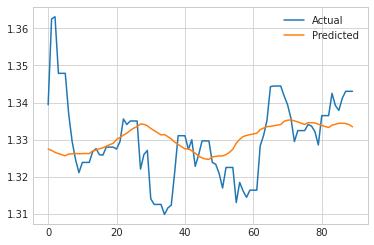

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


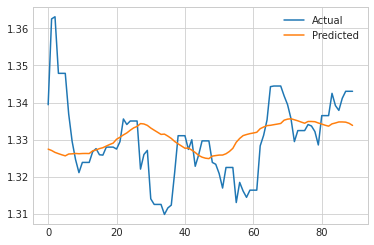

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


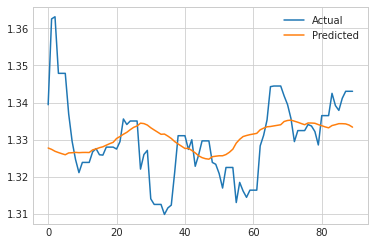

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/CAD(캐나다)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.008
MAPE: 0.006


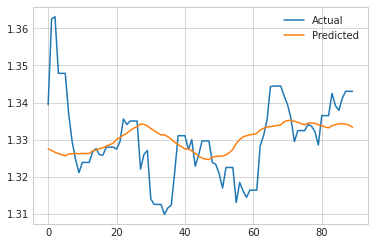

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 61.433
MAPE: 0.019


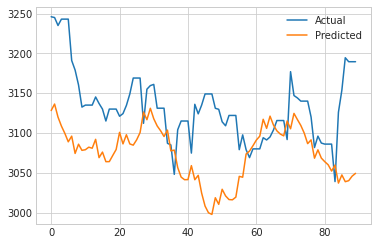

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 61.701
MAPE: 0.020


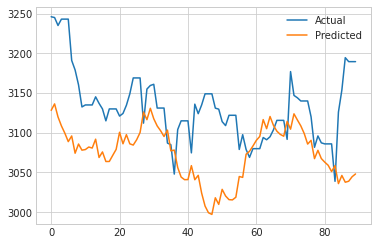

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 61.559
MAPE: 0.020


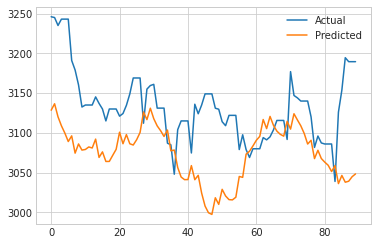

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 62.827
MAPE: 0.020


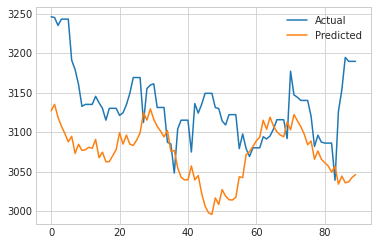

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 62.316
MAPE: 0.020


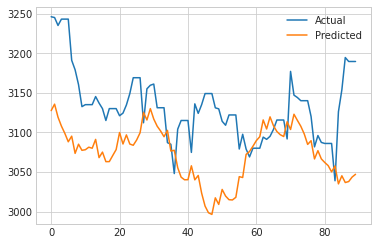

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 60.419
MAPE: 0.019


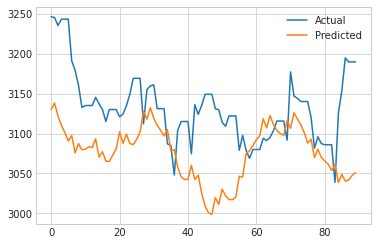

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 59.970
MAPE: 0.019


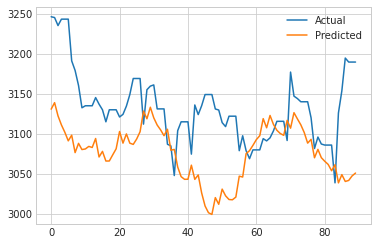

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 60.743
MAPE: 0.019


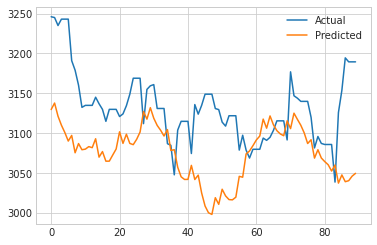

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 60.694
MAPE: 0.019


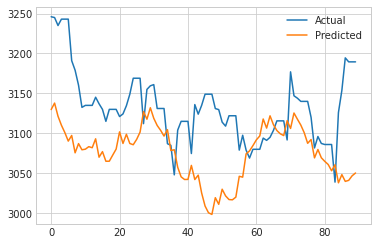

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 59.898
MAPE: 0.019


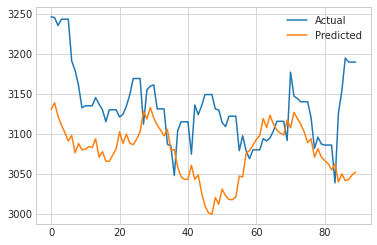

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 59.945
MAPE: 0.019


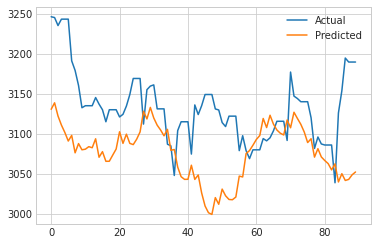

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 61.710
MAPE: 0.020


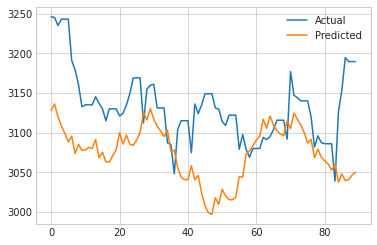

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 60.427
MAPE: 0.019


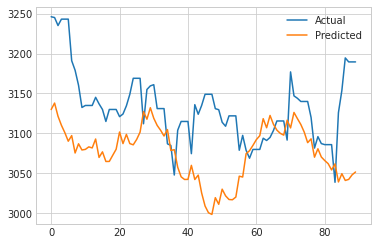

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 59.909
MAPE: 0.019


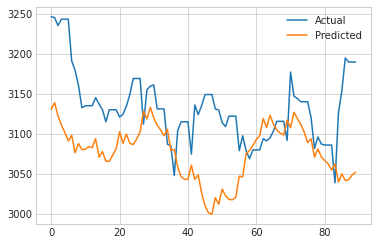

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 60.021
MAPE: 0.019


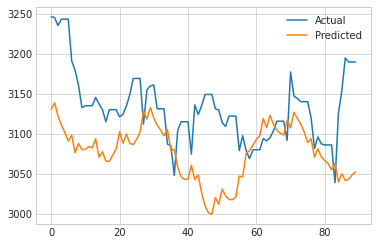

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 58.346
MAPE: 0.019


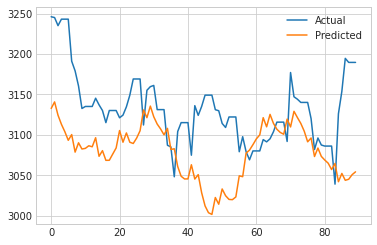

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 60.588
MAPE: 0.019


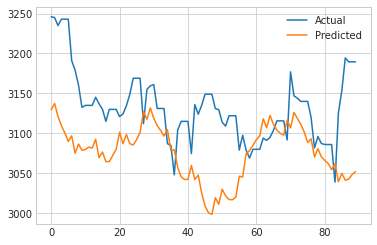

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 61.388
MAPE: 0.019


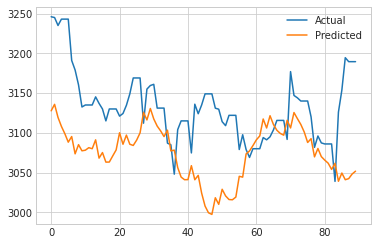

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 60.888
MAPE: 0.019


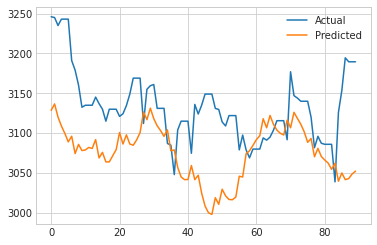

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 60.896
MAPE: 0.019


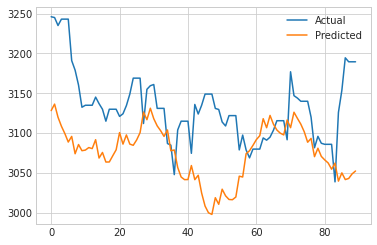

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 60.661
MAPE: 0.019


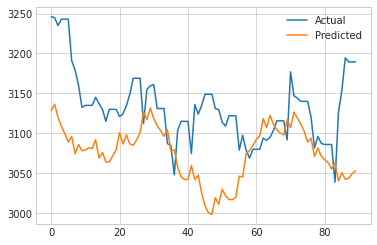

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 60.466
MAPE: 0.019


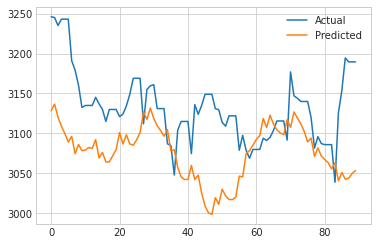

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 59.960
MAPE: 0.019


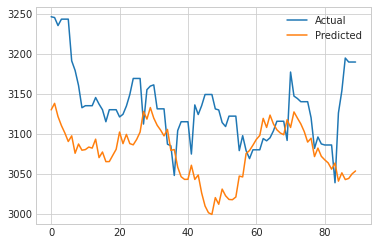

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 60.769
MAPE: 0.019


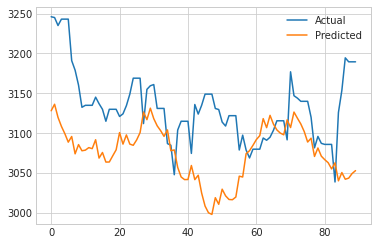

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 60.900
MAPE: 0.019


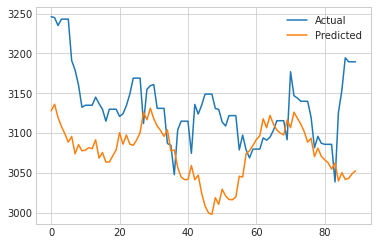

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 60.130
MAPE: 0.019


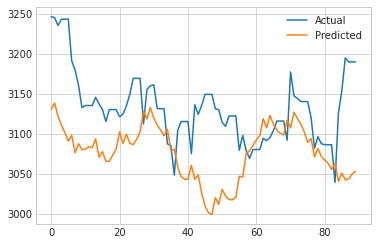

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 60.342
MAPE: 0.019


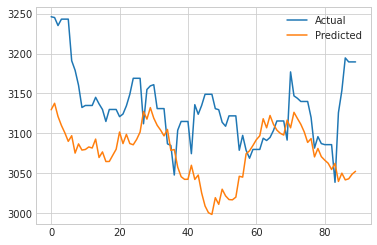

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 60.319
MAPE: 0.019


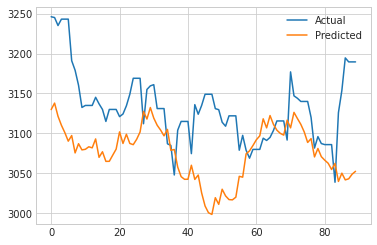

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 60.128
MAPE: 0.019


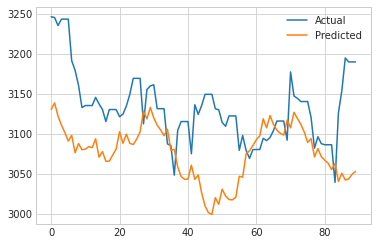

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/COP(콜롬비아)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 60.087
MAPE: 0.019


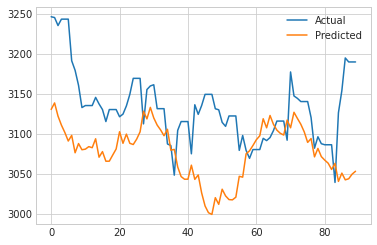

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.092
MAPE: 0.011


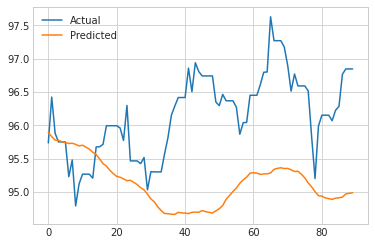

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.086
MAPE: 0.011


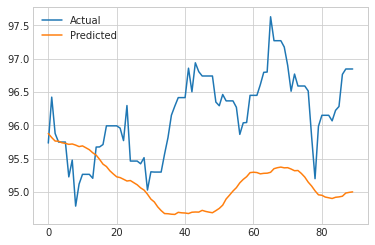

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.087
MAPE: 0.011


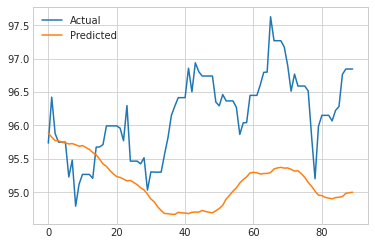

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.100
MAPE: 0.011


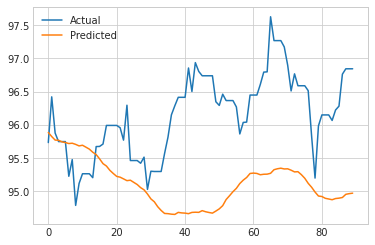

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.091
MAPE: 0.011


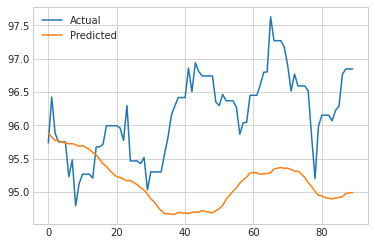

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.202
MAPE: 0.012


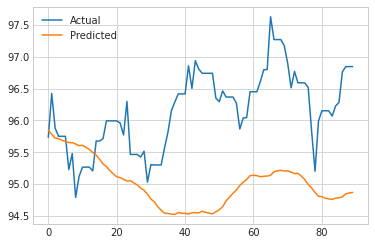

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.234
MAPE: 0.013


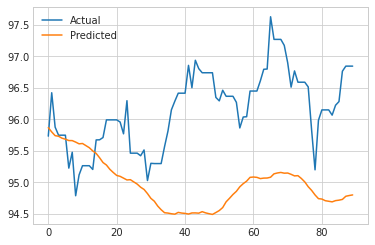

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.234
MAPE: 0.013


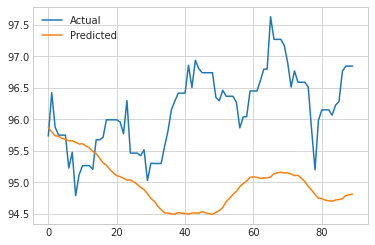

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.238
MAPE: 0.013


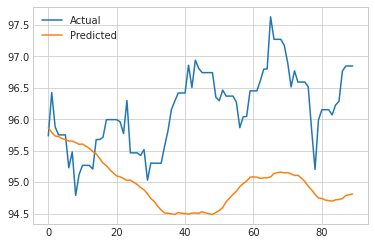

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.238
MAPE: 0.013


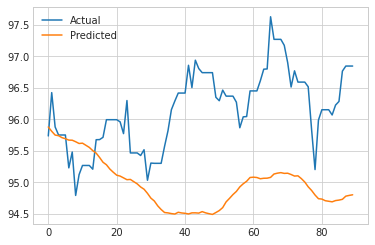

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.266
MAPE: 0.013


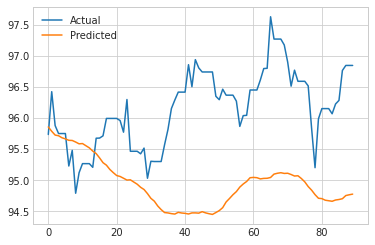

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.271
MAPE: 0.013


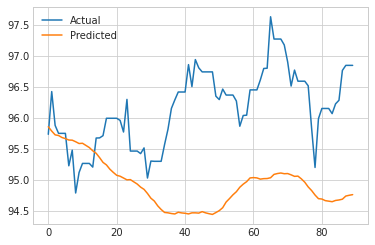

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.277
MAPE: 0.013


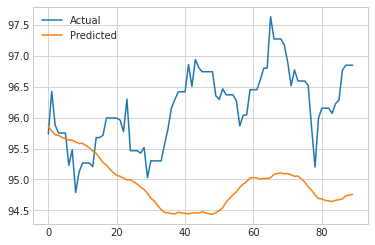

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.269
MAPE: 0.013


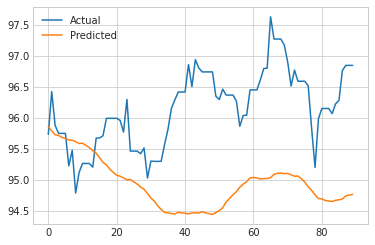

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.267
MAPE: 0.013


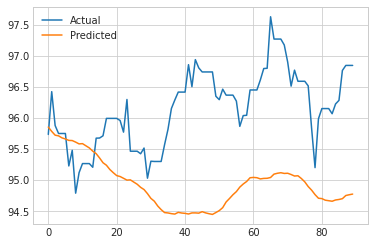

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.299
MAPE: 0.013


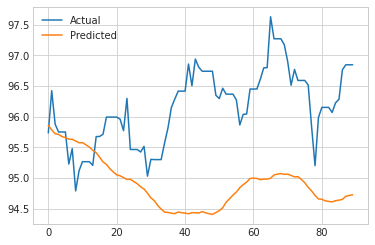

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.296
MAPE: 0.013


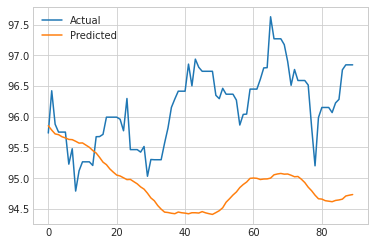

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.300
MAPE: 0.013


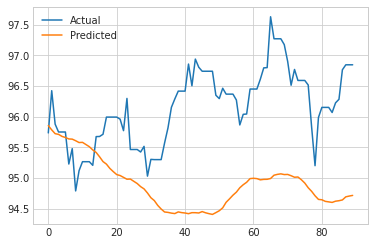

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.305
MAPE: 0.014


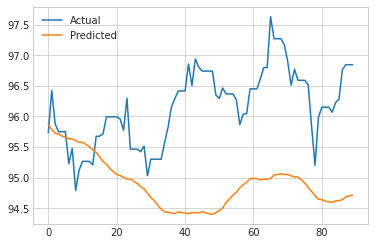

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.290
MAPE: 0.013


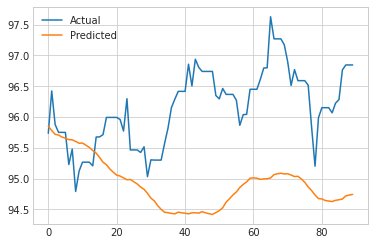

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.298
MAPE: 0.013


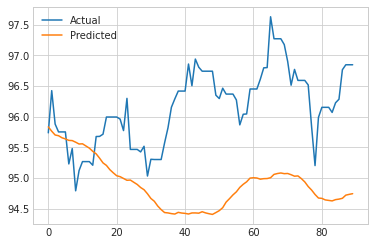

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.322
MAPE: 0.014


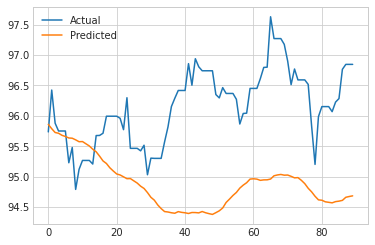

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.316
MAPE: 0.014


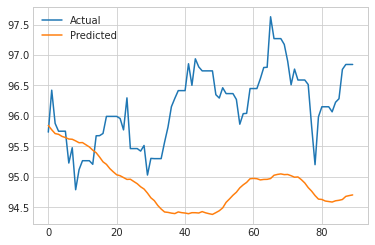

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.329
MAPE: 0.014


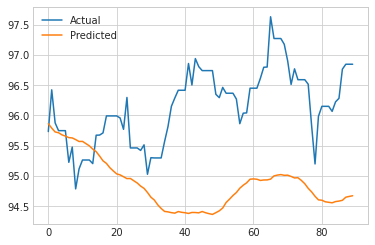

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.334
MAPE: 0.014


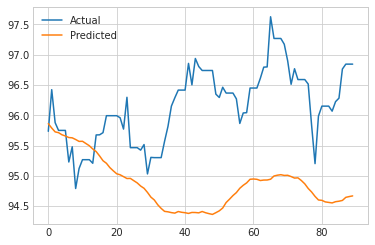

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:US 달러지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.317
MAPE: 0.014


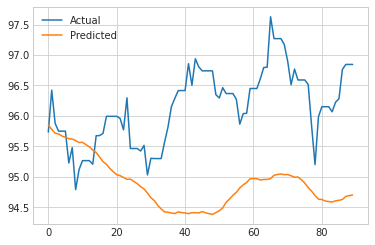

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.341
MAPE: 0.014


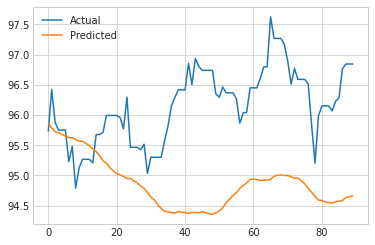

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.344
MAPE: 0.014


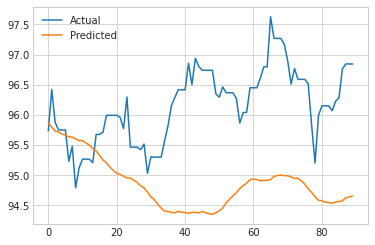

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.326
MAPE: 0.014


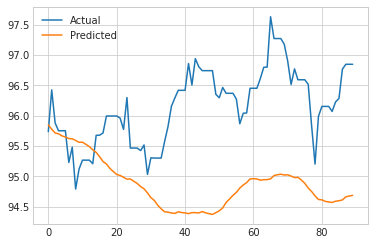

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:US 달러지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.337
MAPE: 0.014


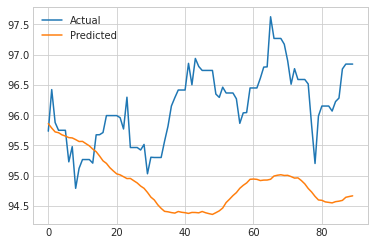

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 438.513
MAPE: 0.031


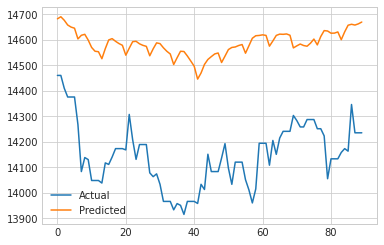

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 441.280
MAPE: 0.031


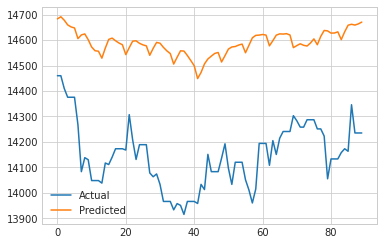

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 440.788
MAPE: 0.031


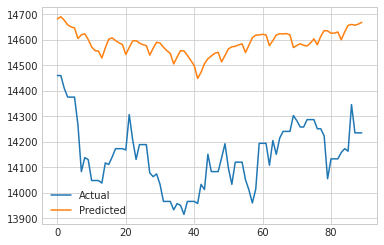

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 440.049
MAPE: 0.031


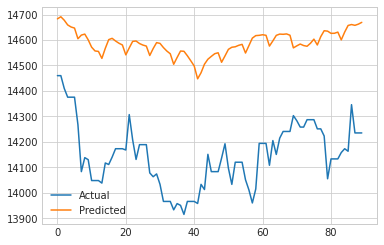

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 439.710
MAPE: 0.031


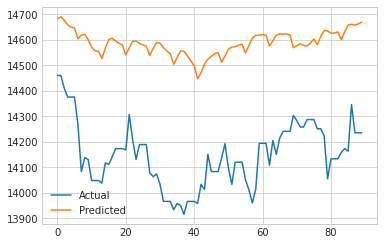

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 414.243
MAPE: 0.029


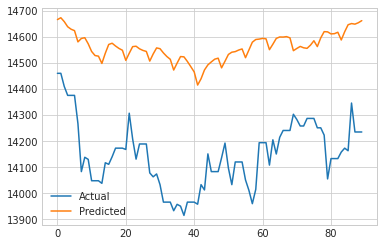

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 411.509
MAPE: 0.029


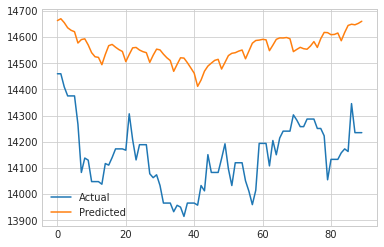

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 419.962
MAPE: 0.030


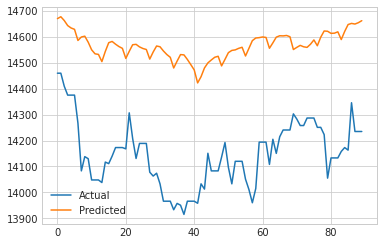

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 412.567
MAPE: 0.029


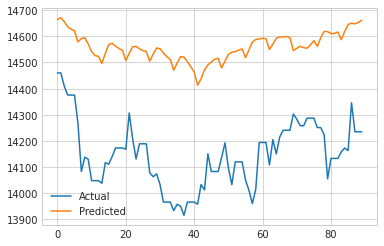

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 414.087
MAPE: 0.029


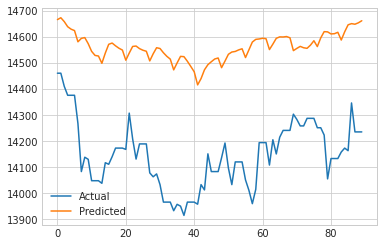

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 394.662
MAPE: 0.028


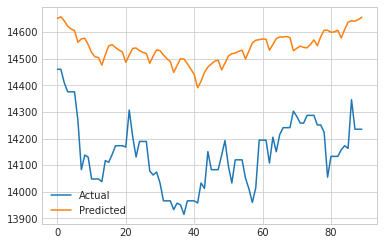

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 393.220
MAPE: 0.028


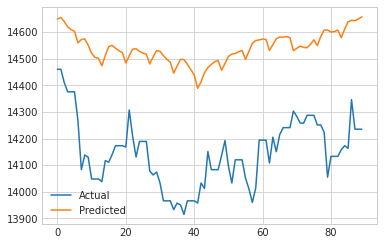

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 389.653
MAPE: 0.028


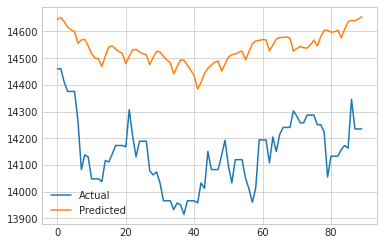

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 391.913
MAPE: 0.028


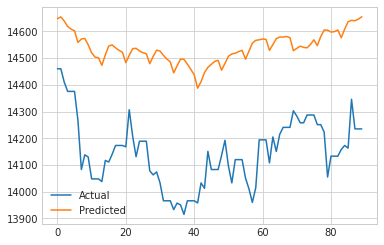

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 394.624
MAPE: 0.028


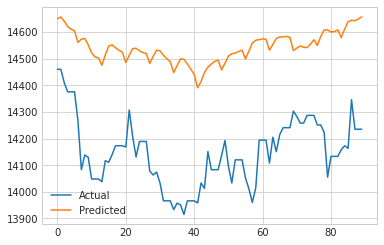

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 377.861
MAPE: 0.027


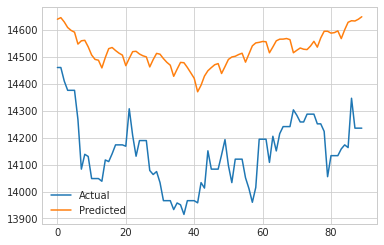

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 379.836
MAPE: 0.027


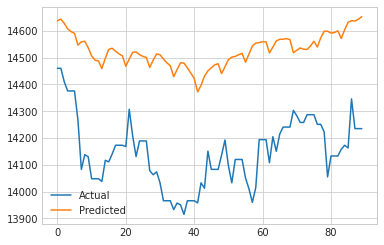

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 382.585
MAPE: 0.027


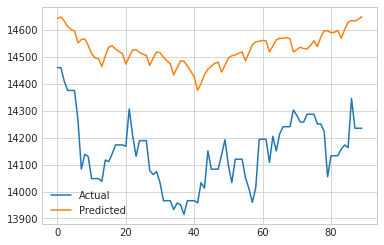

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 375.790
MAPE: 0.027


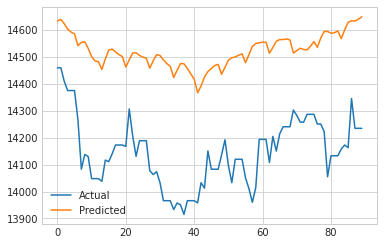

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 384.727
MAPE: 0.027


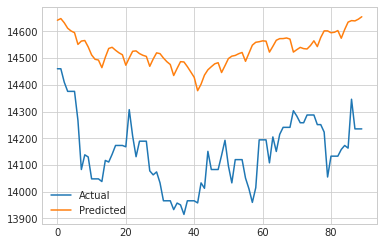

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 374.129
MAPE: 0.026


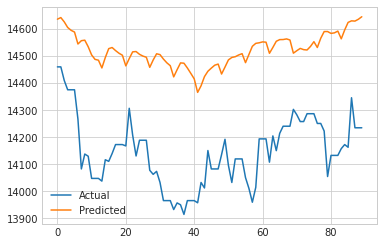

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 370.326
MAPE: 0.026


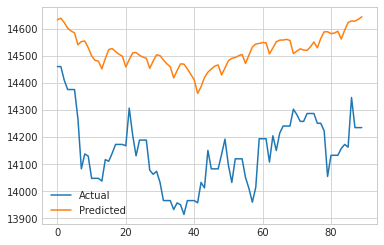

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 366.235
MAPE: 0.026


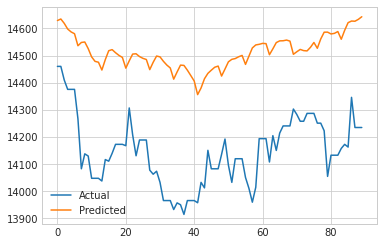

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 374.625
MAPE: 0.027


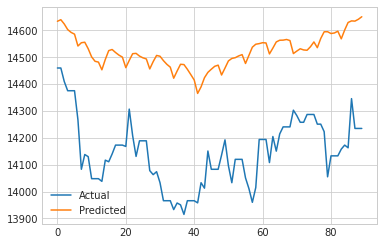

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 372.814
MAPE: 0.026


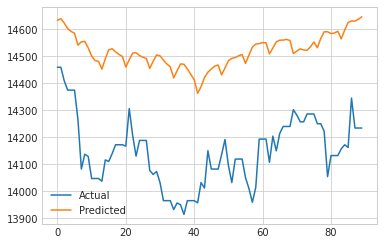

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 375.324
MAPE: 0.027


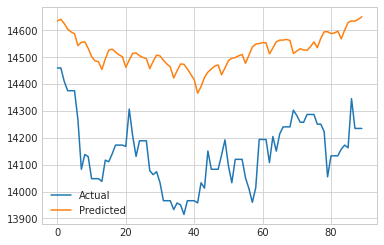

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 375.237
MAPE: 0.027


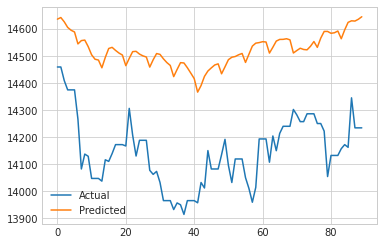

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 370.561
MAPE: 0.026


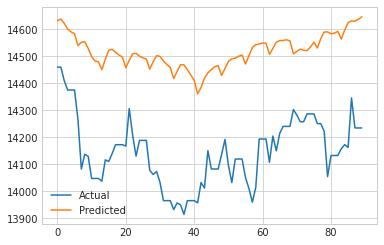

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 372.230
MAPE: 0.026


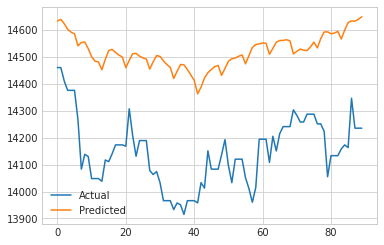

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/IDR(인도네시아)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 369.128
MAPE: 0.026


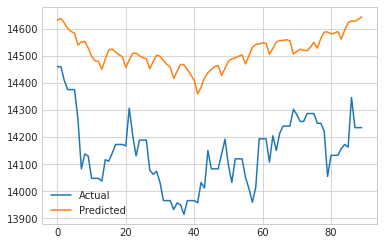

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.749
MAPE: 0.027


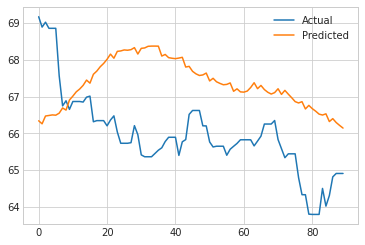

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.758
MAPE: 0.027


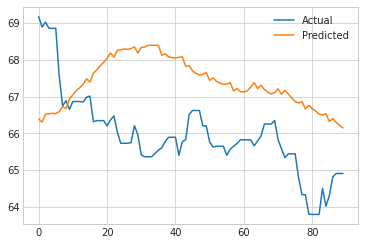

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.769
MAPE: 0.027


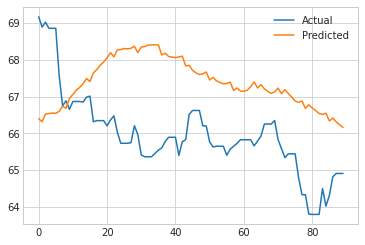

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.793
MAPE: 0.027


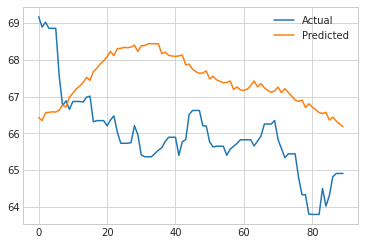

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.784
MAPE: 0.027


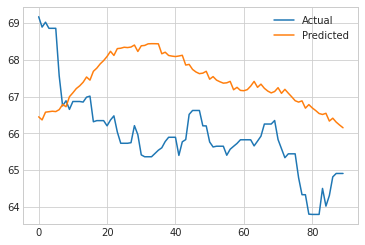

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.571
MAPE: 0.024


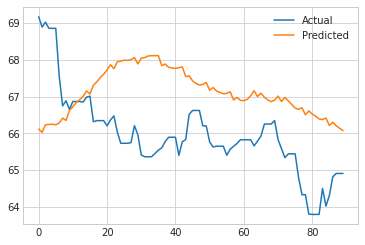

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.535
MAPE: 0.023


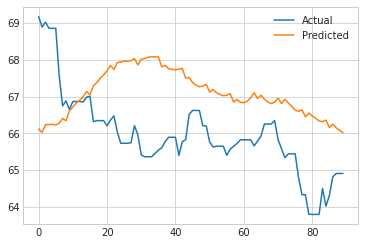

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.559
MAPE: 0.024


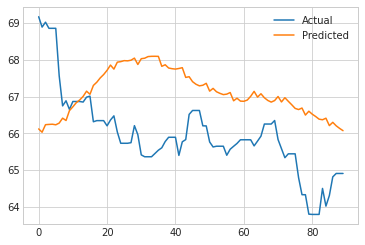

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.561
MAPE: 0.024


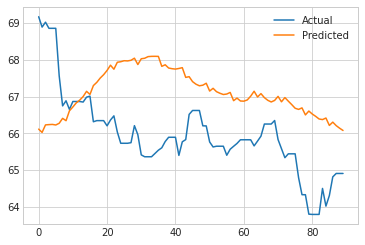

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.545
MAPE: 0.023


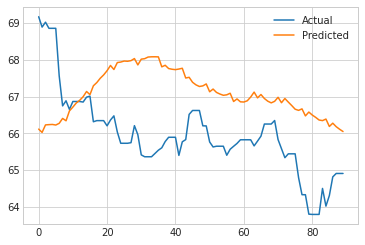

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.473
MAPE: 0.022


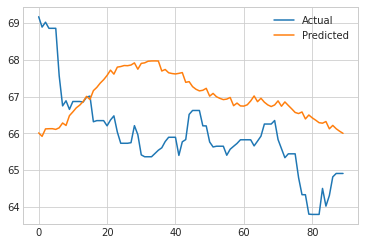

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.472
MAPE: 0.022


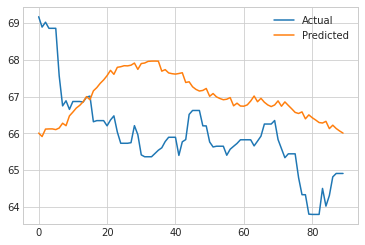

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.485
MAPE: 0.023


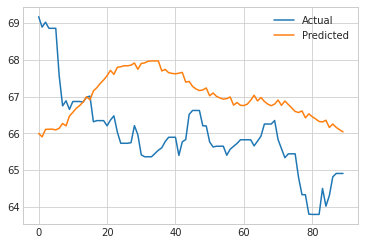

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.448
MAPE: 0.022


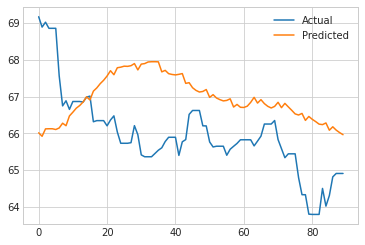

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.474
MAPE: 0.022


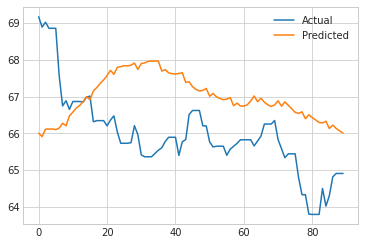

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.387
MAPE: 0.021


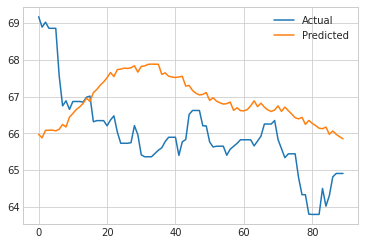

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.405
MAPE: 0.021


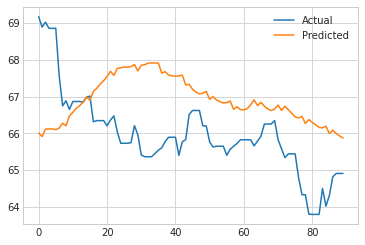

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.391
MAPE: 0.021


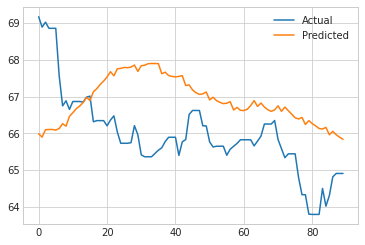

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.385
MAPE: 0.021


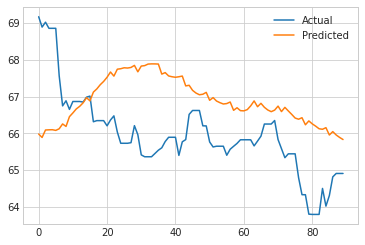

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.384
MAPE: 0.021


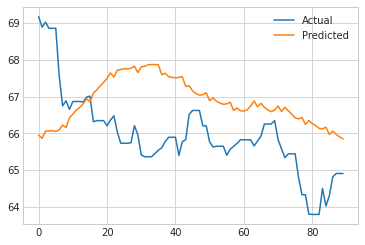

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.332
MAPE: 0.020


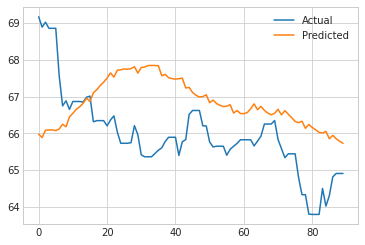

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.324
MAPE: 0.020


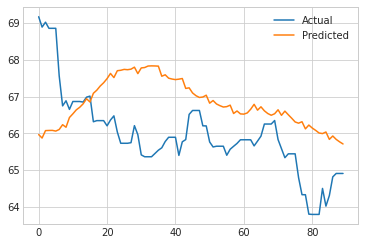

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.320
MAPE: 0.020


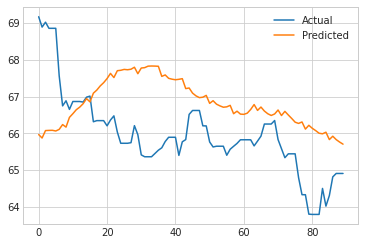

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.334
MAPE: 0.020


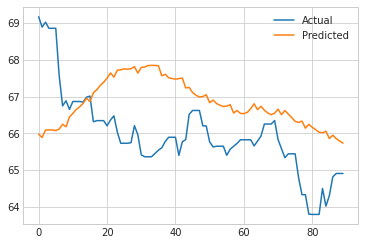

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.342
MAPE: 0.020


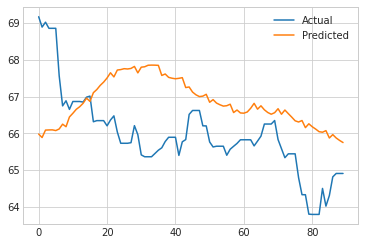

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1.284
MAPE: 0.019


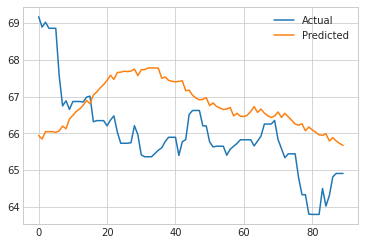

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1.288
MAPE: 0.020


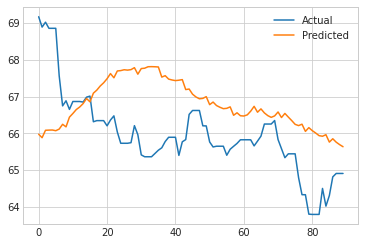

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1.280
MAPE: 0.019


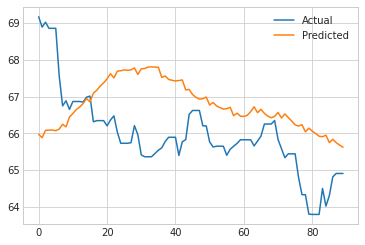

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1.307
MAPE: 0.020


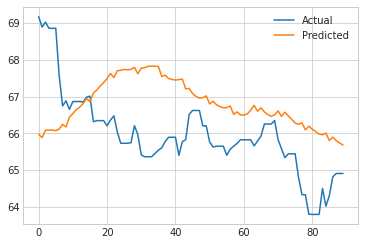

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/RUB(러시아)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1.271
MAPE: 0.019


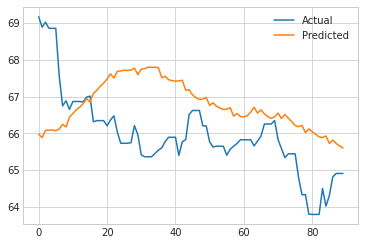

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.375
MAPE: 0.027


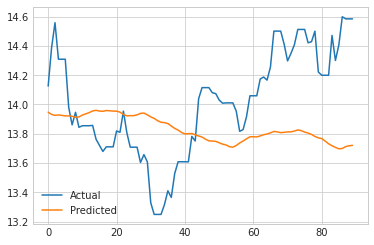

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.373
MAPE: 0.026


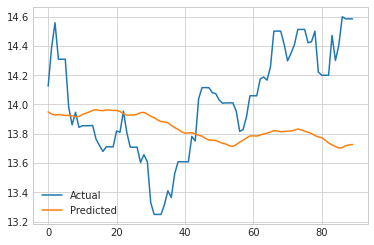

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.373
MAPE: 0.026


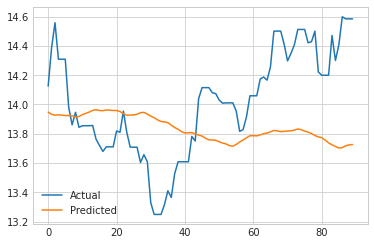

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.374
MAPE: 0.027


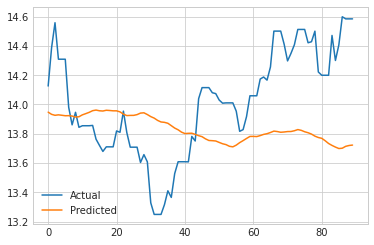

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.376
MAPE: 0.027


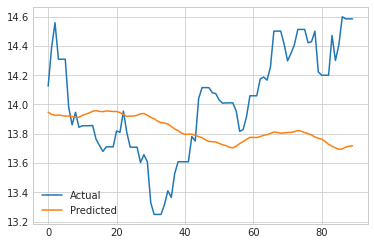

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.463
MAPE: 0.033


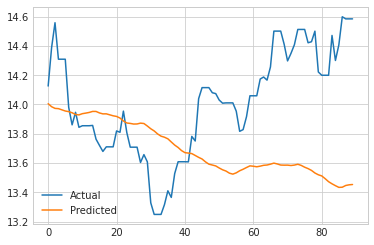

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.463
MAPE: 0.033


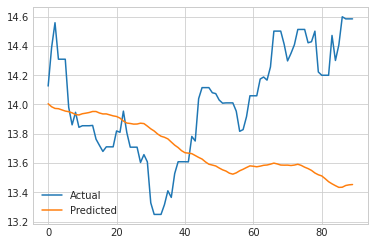

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.455
MAPE: 0.032


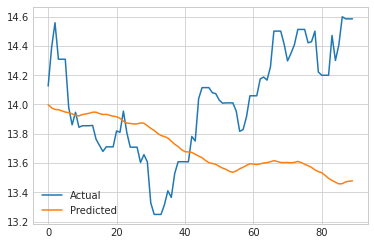

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.460
MAPE: 0.032


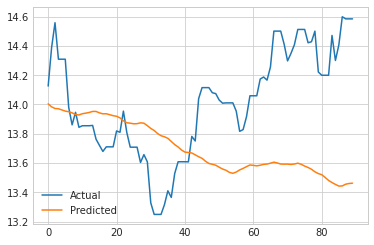

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.454
MAPE: 0.032


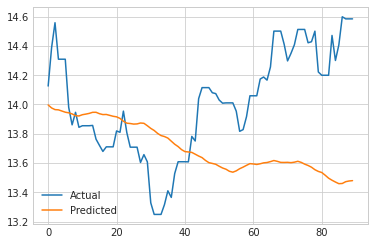

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.490
MAPE: 0.035


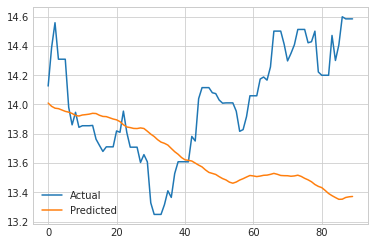

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.489
MAPE: 0.034


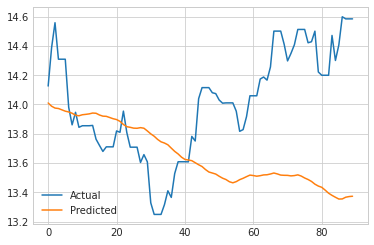

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.491
MAPE: 0.035


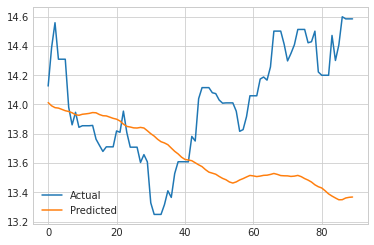

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.492
MAPE: 0.035


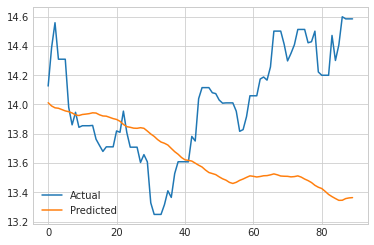

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.488
MAPE: 0.034


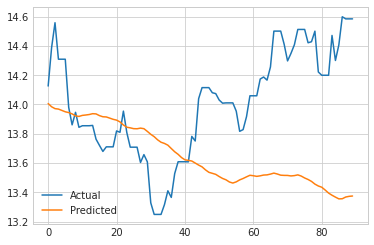

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.494
MAPE: 0.035


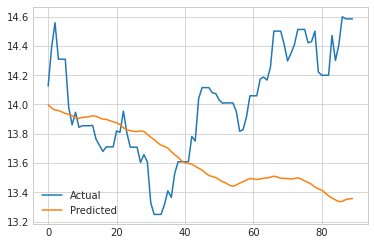

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.502
MAPE: 0.035


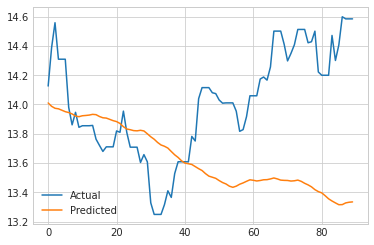

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.501
MAPE: 0.035


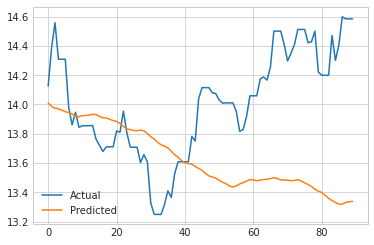

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.506
MAPE: 0.036


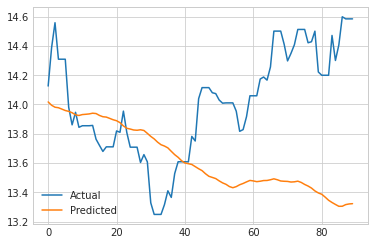

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.504
MAPE: 0.035


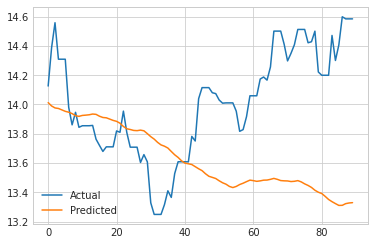

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.508
MAPE: 0.036


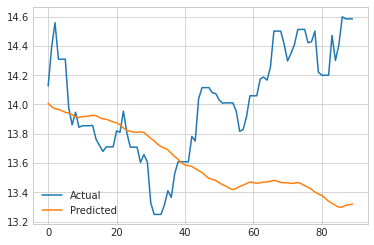

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.512
MAPE: 0.036


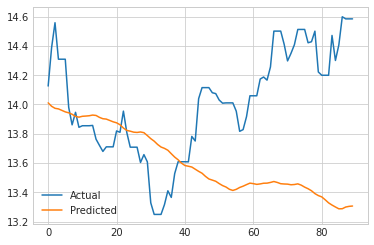

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.513
MAPE: 0.036


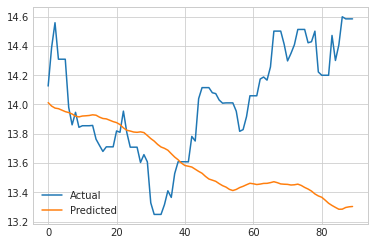

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.513
MAPE: 0.036


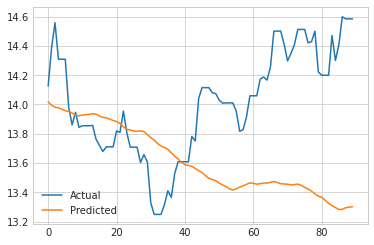

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.511
MAPE: 0.036


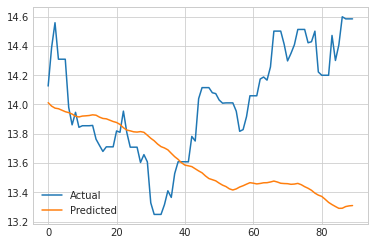

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 0.511
MAPE: 0.036


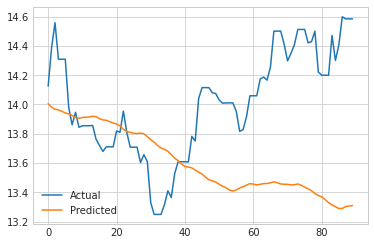

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 0.518
MAPE: 0.036


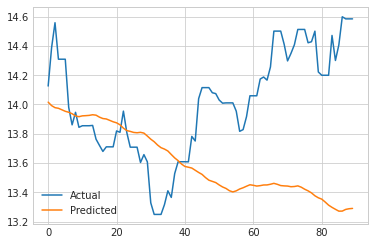

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 0.514
MAPE: 0.036


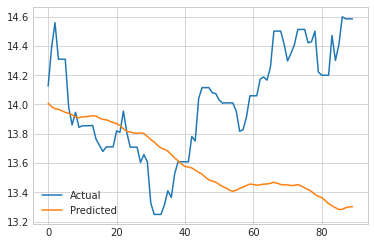

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 0.513
MAPE: 0.036


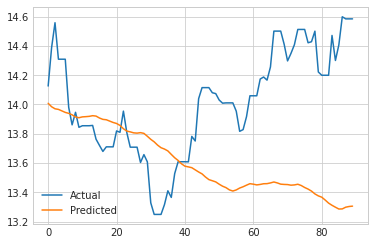

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:USD/ZAR(자메이카)    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 0.521
MAPE: 0.037


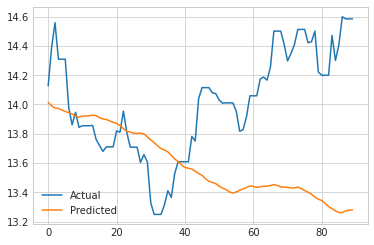

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 199.348
MAPE: 0.069


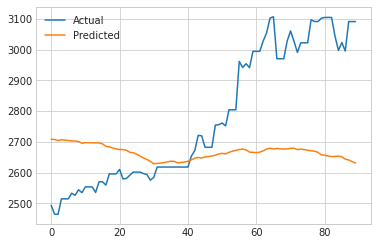

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 198.792
MAPE: 0.069


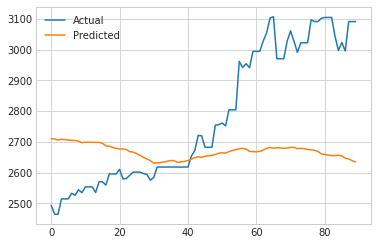

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 198.192
MAPE: 0.068


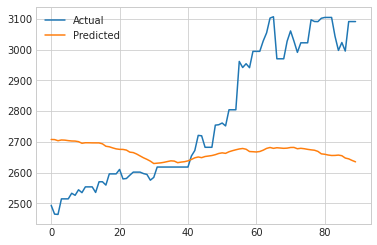

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 199.760
MAPE: 0.069


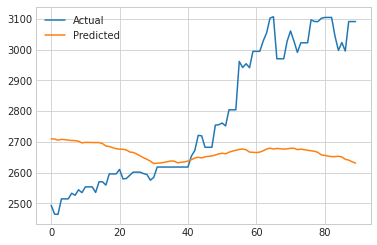

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 199.011
MAPE: 0.069


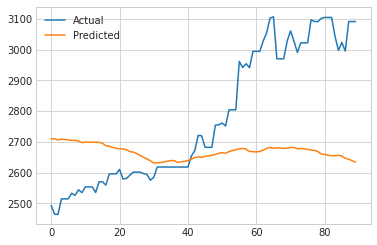

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 194.844
MAPE: 0.067


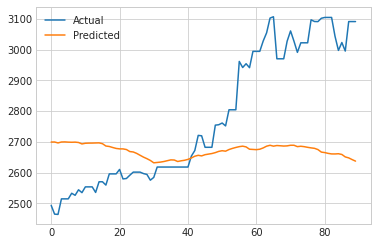

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 196.652
MAPE: 0.068


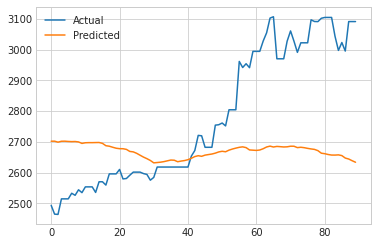

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 195.359
MAPE: 0.067


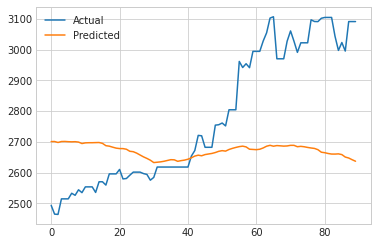

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 195.030
MAPE: 0.067


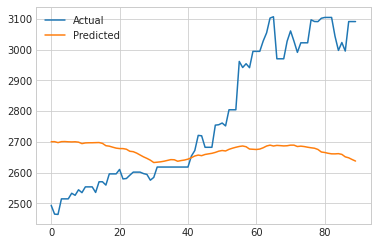

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 196.200
MAPE: 0.068


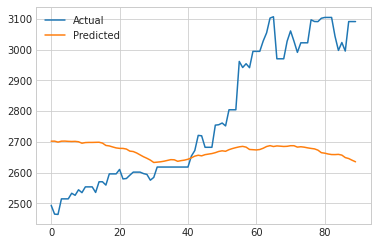

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 191.481
MAPE: 0.066


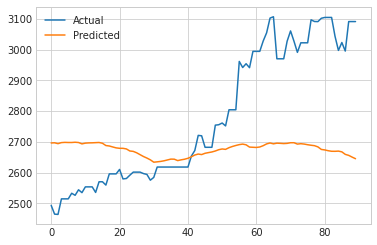

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 192.260
MAPE: 0.066


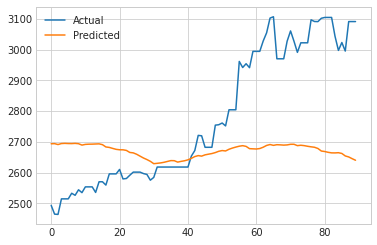

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 190.986
MAPE: 0.066


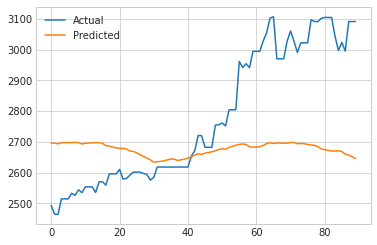

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 192.976
MAPE: 0.067


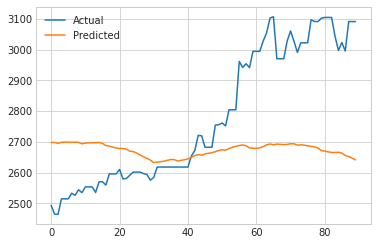

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 191.976
MAPE: 0.066


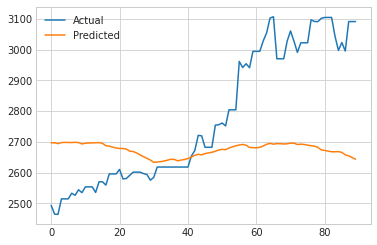

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 190.098
MAPE: 0.066


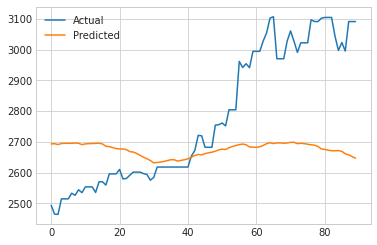

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 190.686
MAPE: 0.066


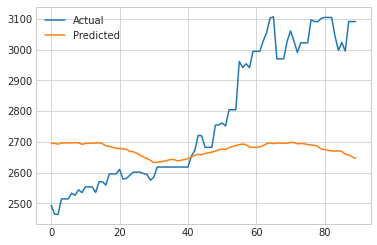

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 189.733
MAPE: 0.066


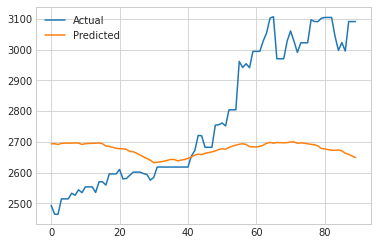

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 191.642
MAPE: 0.066


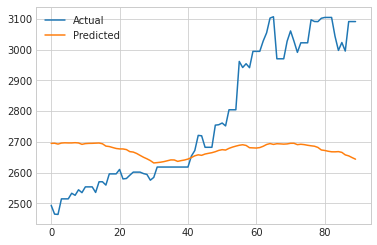

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 190.482
MAPE: 0.066


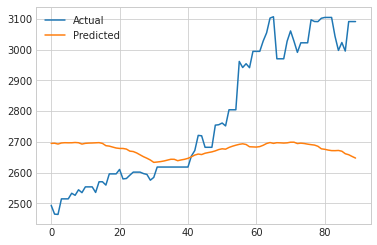

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 189.190
MAPE: 0.065


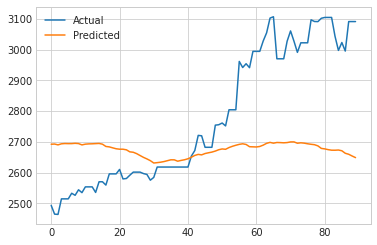

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 189.341
MAPE: 0.065


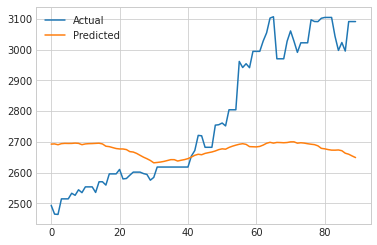

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 189.411
MAPE: 0.065


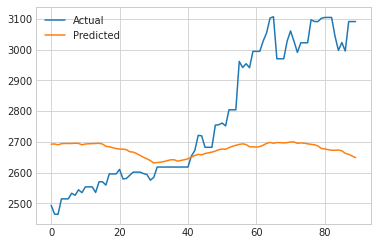

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 188.998
MAPE: 0.065


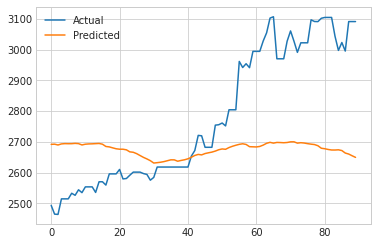

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 189.938
MAPE: 0.066


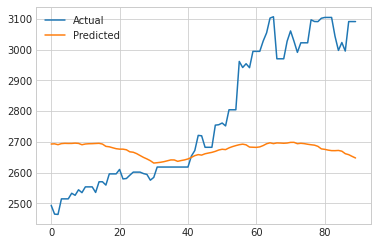

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:상하이종합지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 188.637
MAPE: 0.065


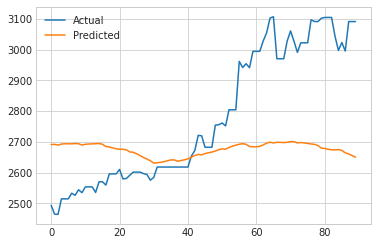

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 188.535
MAPE: 0.065


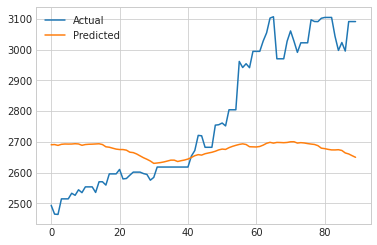

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 188.783
MAPE: 0.065


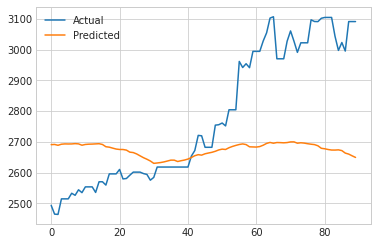

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 188.227
MAPE: 0.065


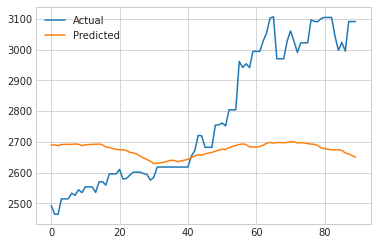

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:상하이종합지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 188.786
MAPE: 0.065


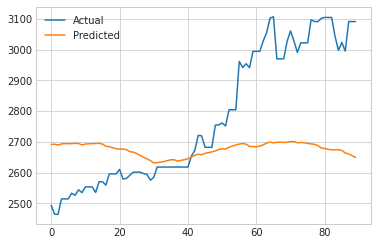

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 749.090
MAPE: 0.020


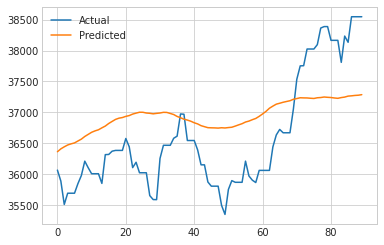

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 743.695
MAPE: 0.020


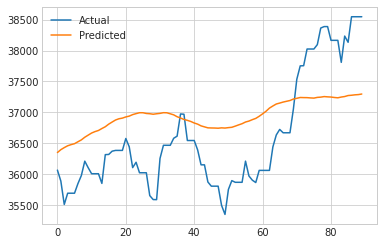

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 744.777
MAPE: 0.020


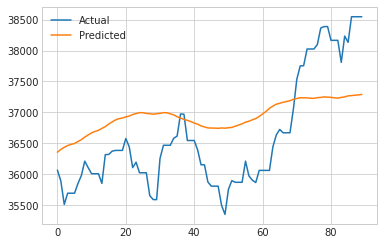

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 745.465
MAPE: 0.020


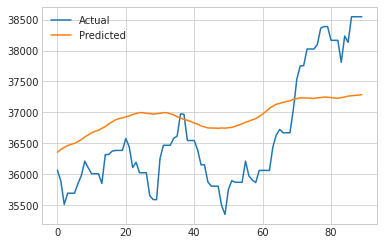

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 746.208
MAPE: 0.020


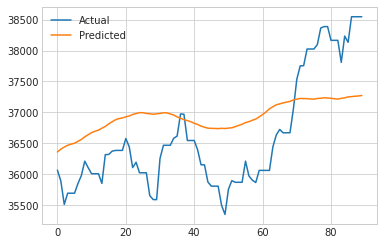

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 734.414
MAPE: 0.020


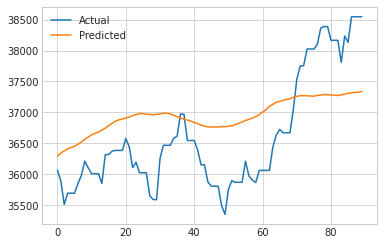

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 736.028
MAPE: 0.020


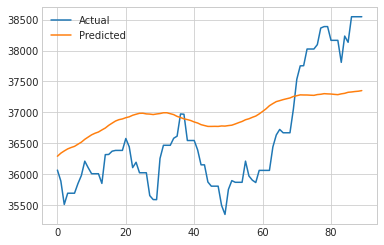

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 731.979
MAPE: 0.020


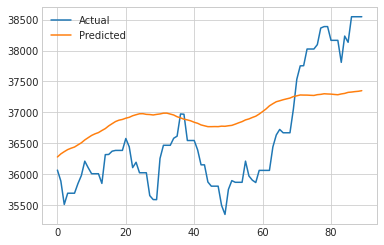

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 735.571
MAPE: 0.020


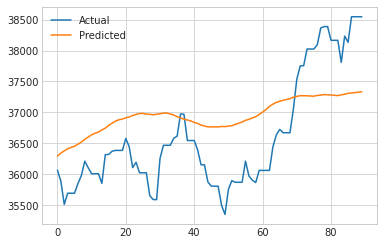

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 735.268
MAPE: 0.020


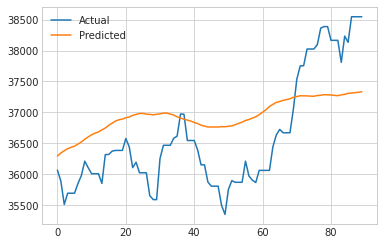

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 741.220
MAPE: 0.020


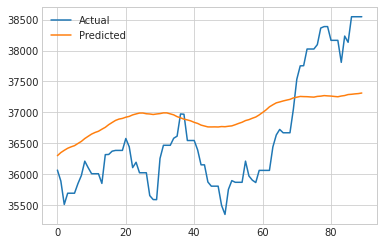

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 740.955
MAPE: 0.020


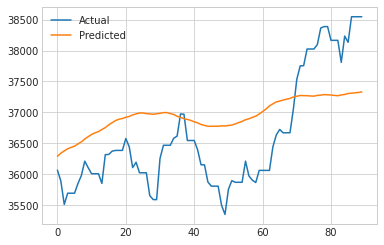

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 736.817
MAPE: 0.020


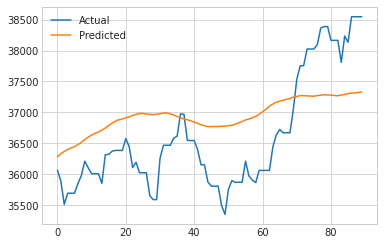

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 740.835
MAPE: 0.020


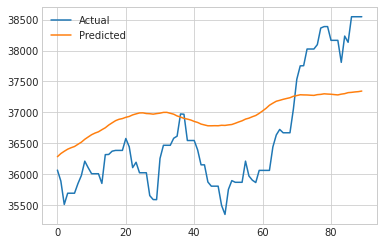

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 746.709
MAPE: 0.020


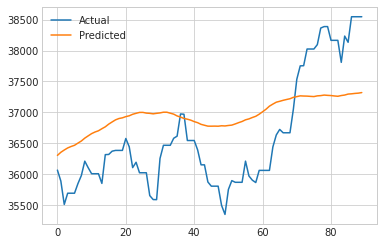

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 741.259
MAPE: 0.020


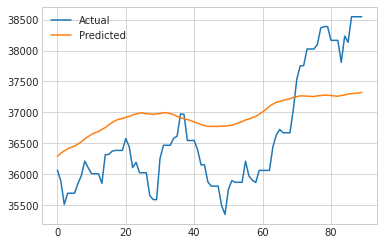

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 742.100
MAPE: 0.020


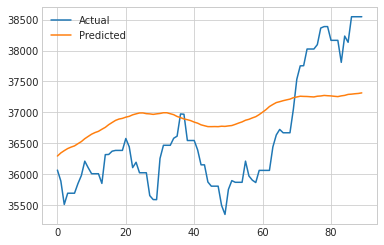

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 743.295
MAPE: 0.020


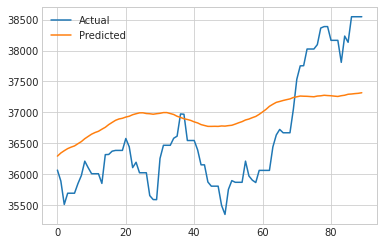

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 746.152
MAPE: 0.020


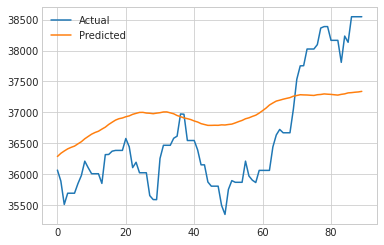

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 744.471
MAPE: 0.020


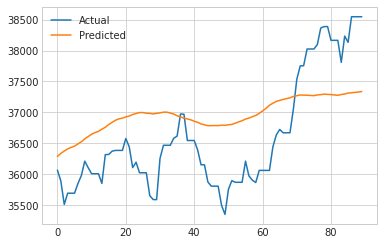

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 744.889
MAPE: 0.020


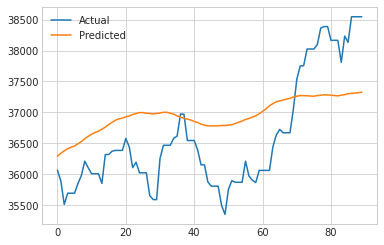

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 744.104
MAPE: 0.020


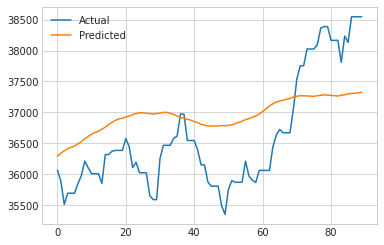

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 745.974
MAPE: 0.020


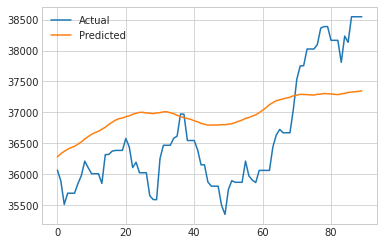

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 746.158
MAPE: 0.020


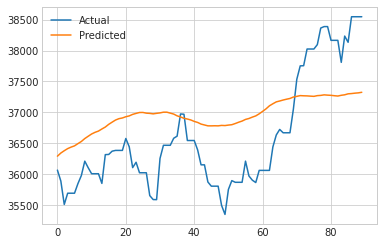

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 748.324
MAPE: 0.020


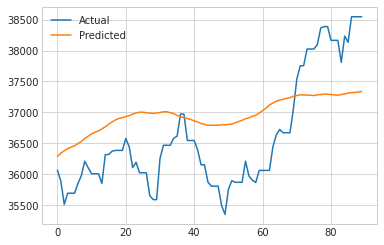

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:인도지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 748.679
MAPE: 0.020


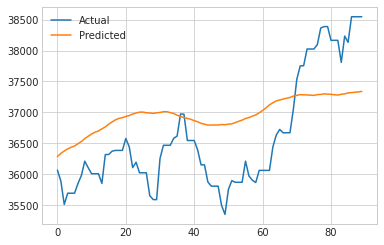

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 744.914
MAPE: 0.020


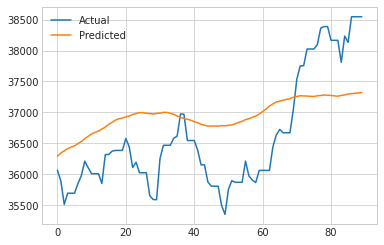

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 749.336
MAPE: 0.020


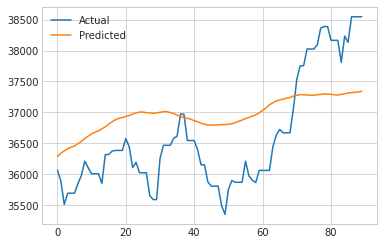

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 748.628
MAPE: 0.020


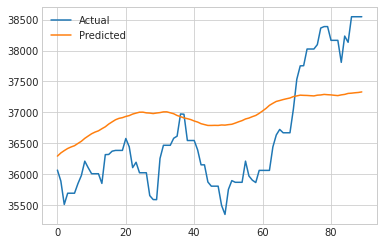

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:인도지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 748.029
MAPE: 0.020


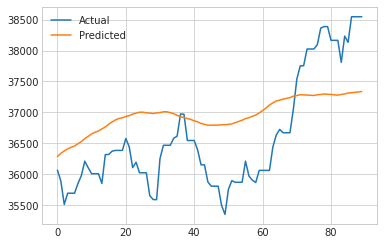

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 3131.763
MAPE: 0.032


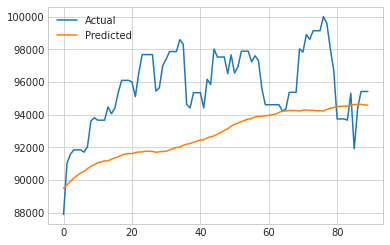

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 3131.469
MAPE: 0.032


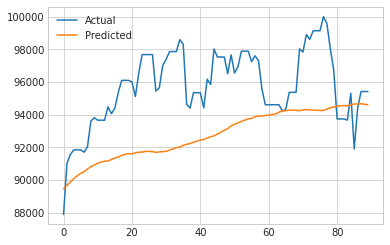

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 3139.498
MAPE: 0.032


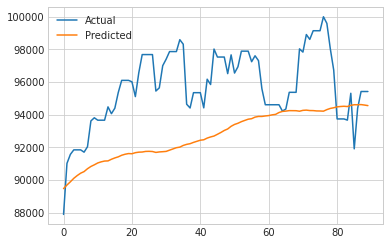

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 3131.325
MAPE: 0.032


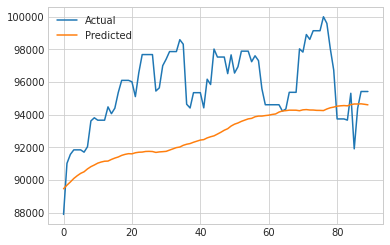

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 3150.316
MAPE: 0.033


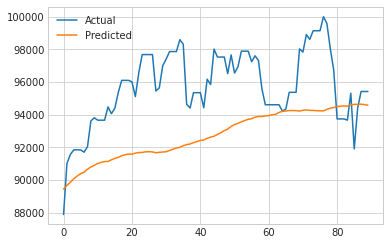

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 2641.829
MAPE: 0.027


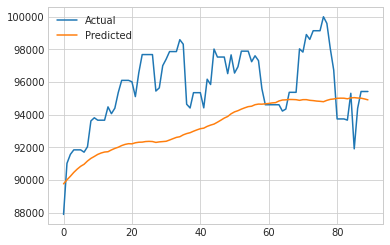

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 2671.037
MAPE: 0.028


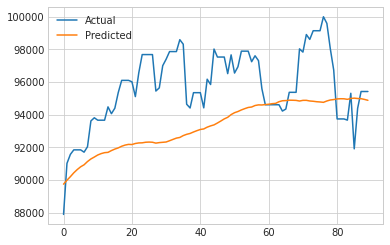

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 2686.311
MAPE: 0.028


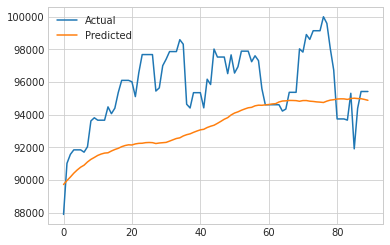

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 2664.865
MAPE: 0.028


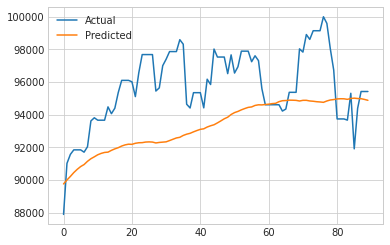

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 2647.230
MAPE: 0.027


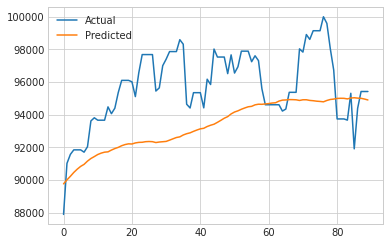

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 2530.257
MAPE: 0.026


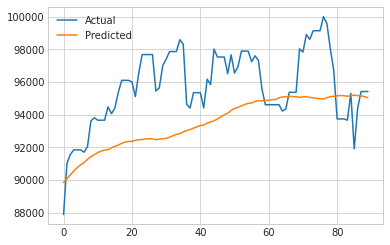

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 2522.445
MAPE: 0.026


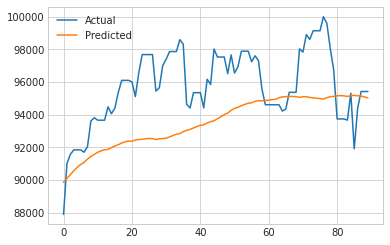

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 2506.234
MAPE: 0.026


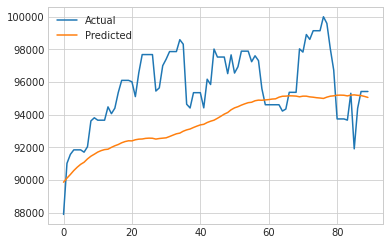

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 2517.141
MAPE: 0.026


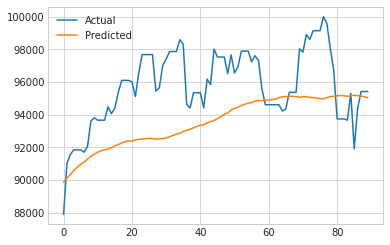

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 2497.801
MAPE: 0.026


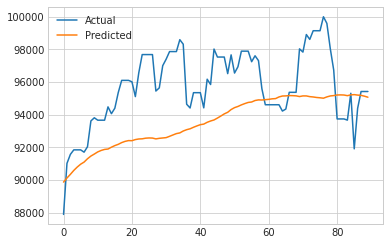

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 2422.022
MAPE: 0.025


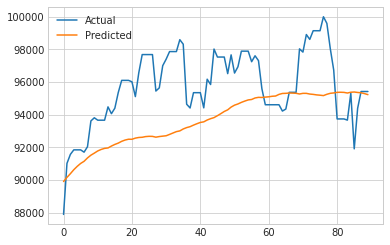

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 2446.252
MAPE: 0.025


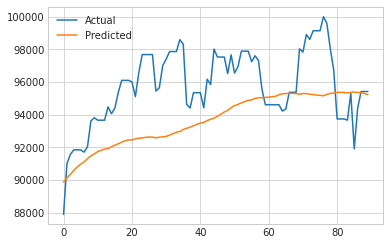

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 2441.508
MAPE: 0.025


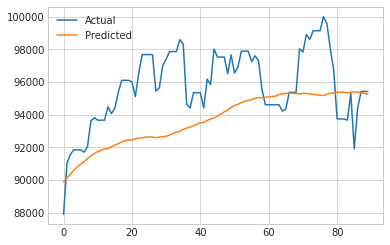

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 2447.620
MAPE: 0.025


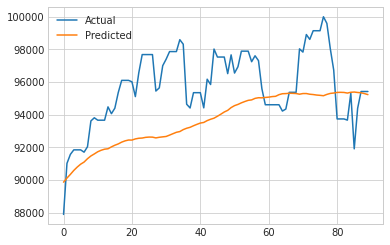

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 2442.349
MAPE: 0.025


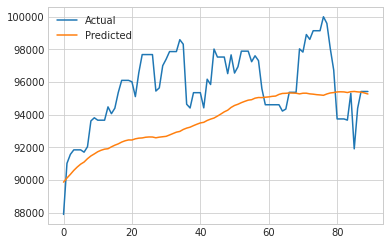

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 2421.155
MAPE: 0.025


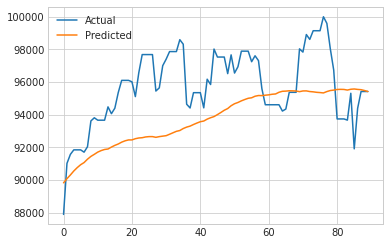

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 2415.512
MAPE: 0.025


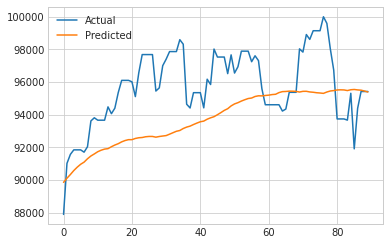

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 2396.785
MAPE: 0.025


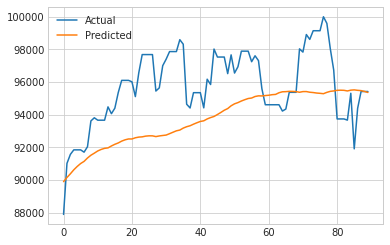

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 2384.031
MAPE: 0.025


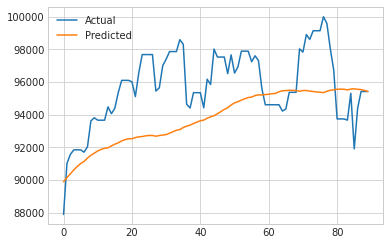

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 2401.273
MAPE: 0.025


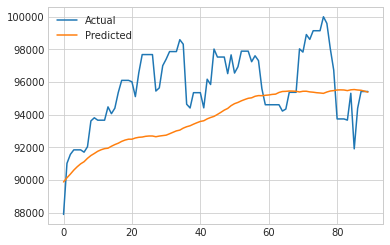

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:브라질지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 2395.981
MAPE: 0.025


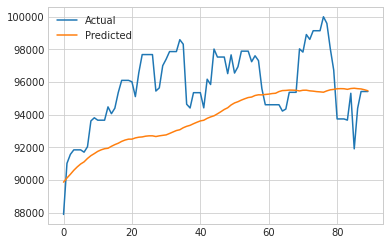

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 2399.235
MAPE: 0.025


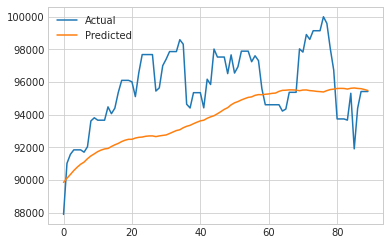

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 2414.633
MAPE: 0.025


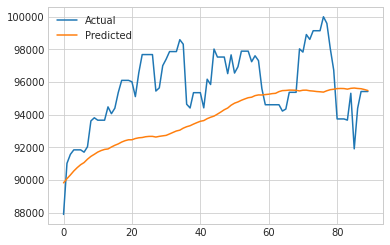

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 2422.809
MAPE: 0.025


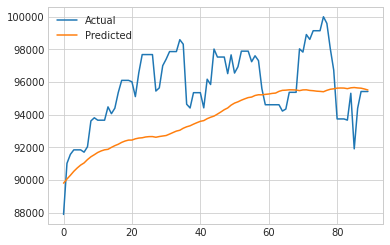

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:브라질지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 2358.949
MAPE: 0.024


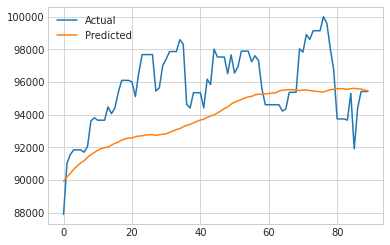

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 788.869
MAPE: 0.032


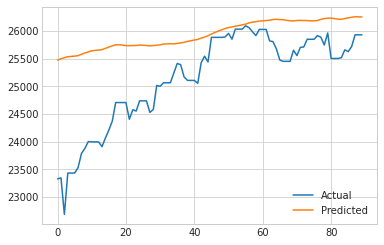

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 792.390
MAPE: 0.032


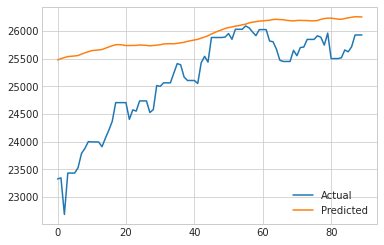

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 788.951
MAPE: 0.032


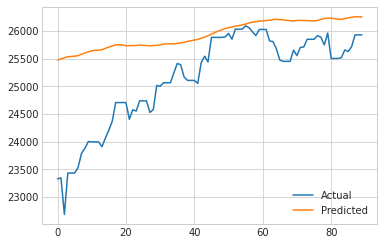

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 792.754
MAPE: 0.032


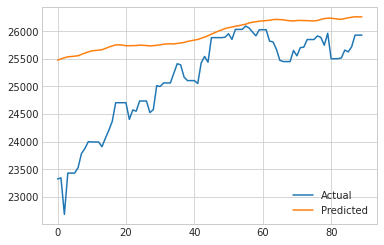

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 793.774
MAPE: 0.032


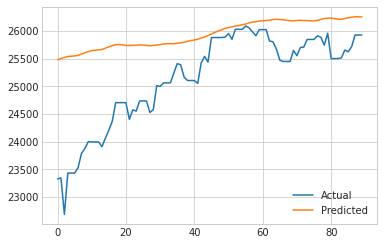

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 759.857
MAPE: 0.031


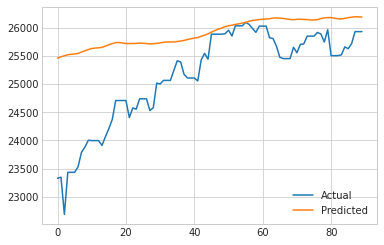

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 765.940
MAPE: 0.031


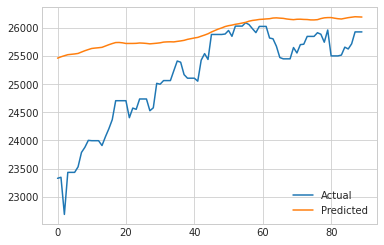

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 762.435
MAPE: 0.031


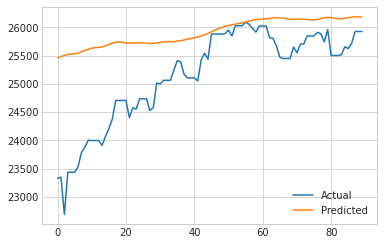

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 765.561
MAPE: 0.031


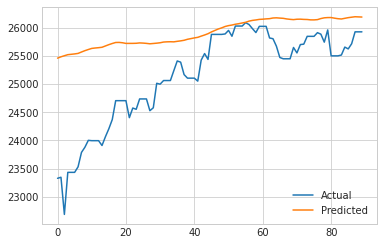

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 768.902
MAPE: 0.031


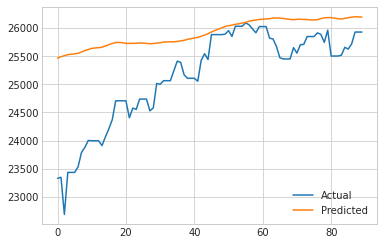

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 754.550
MAPE: 0.031


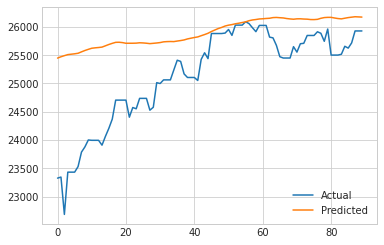

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 753.600
MAPE: 0.031


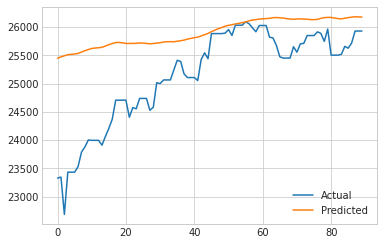

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 751.152
MAPE: 0.031


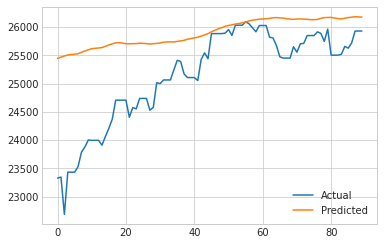

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 750.978
MAPE: 0.031


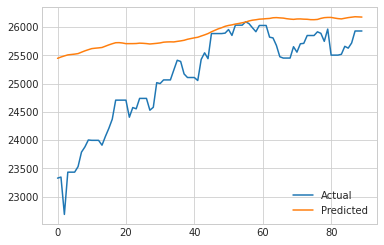

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 754.359
MAPE: 0.031


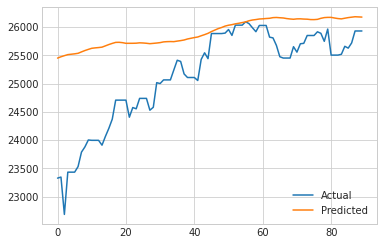

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 742.265
MAPE: 0.030


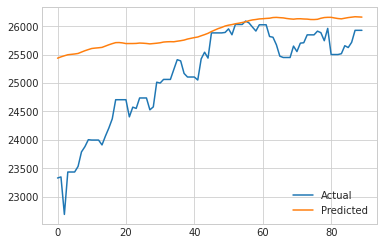

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 746.719
MAPE: 0.031


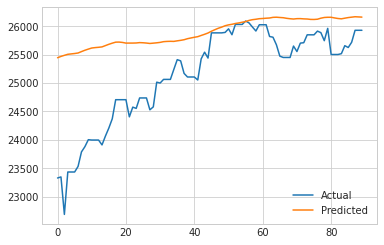

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 745.441
MAPE: 0.031


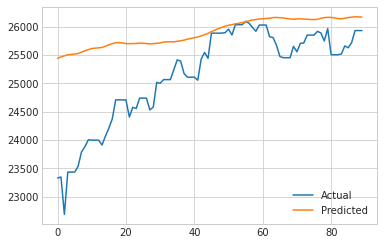

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 745.744
MAPE: 0.031


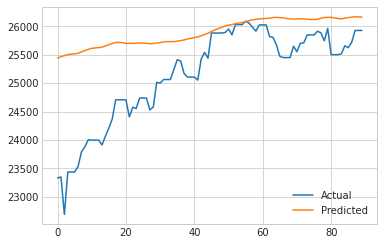

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 747.622
MAPE: 0.031


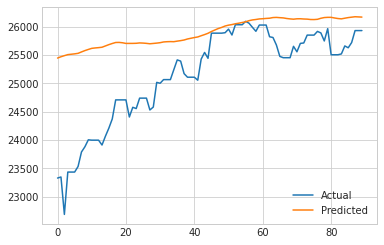

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 736.607
MAPE: 0.030


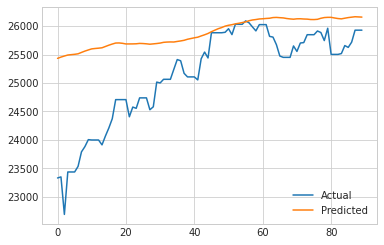

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 742.281
MAPE: 0.030


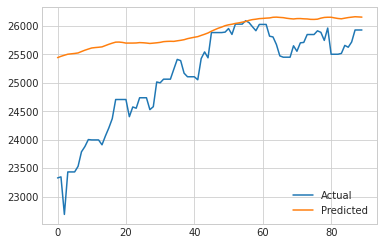

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 738.225
MAPE: 0.030


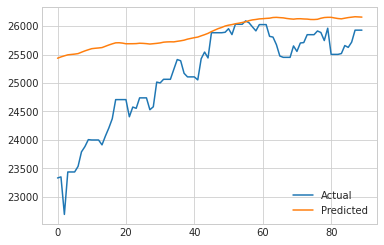

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 739.694
MAPE: 0.030


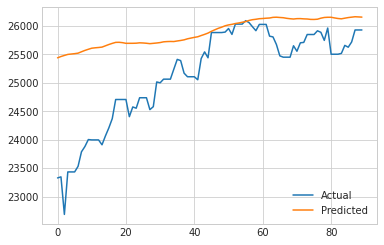

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 741.320
MAPE: 0.030


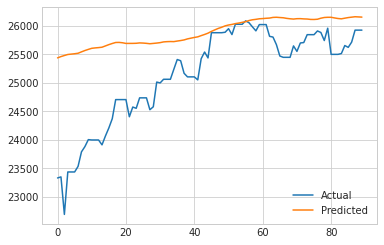

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:다우존스지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 736.162
MAPE: 0.030


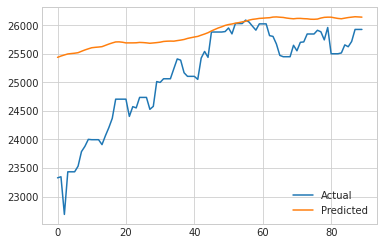

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 739.466
MAPE: 0.030


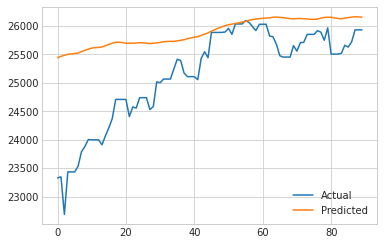

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 739.141
MAPE: 0.030


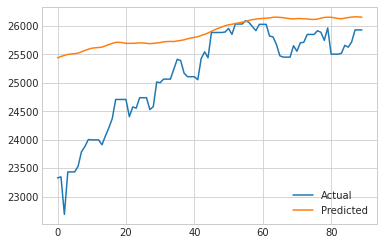

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 739.740
MAPE: 0.030


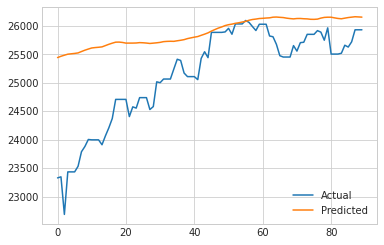

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:다우존스지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 733.243
MAPE: 0.030


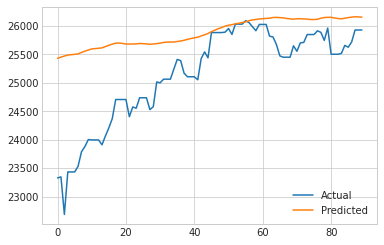

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 152.434
MAPE: 0.031


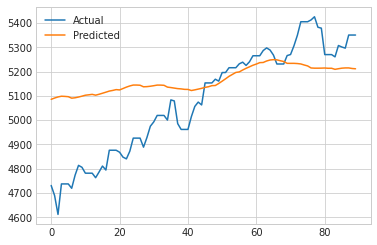

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 153.115
MAPE: 0.031


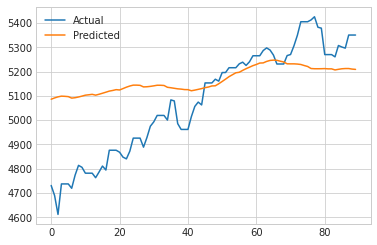

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 152.475
MAPE: 0.031


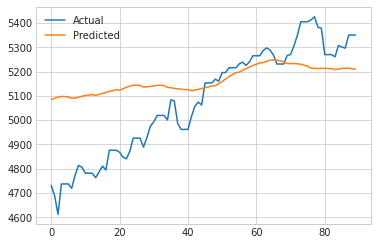

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 153.048
MAPE: 0.031


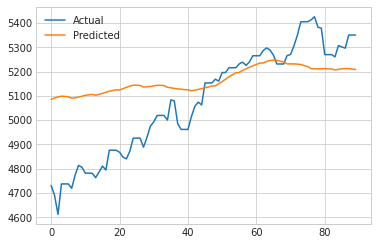

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 152.388
MAPE: 0.031


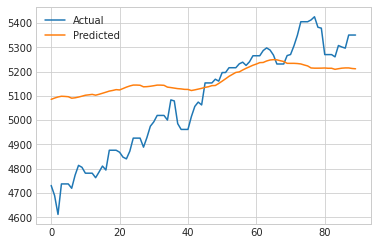

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 152.385
MAPE: 0.031


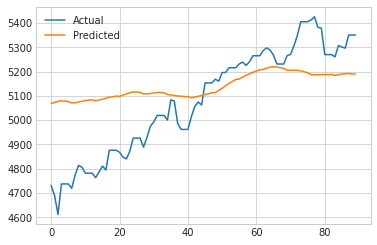

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 151.807
MAPE: 0.031


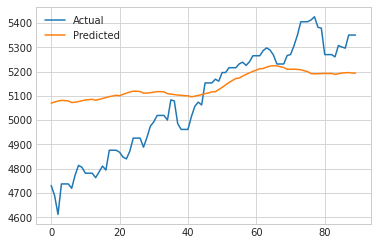

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 151.272
MAPE: 0.030


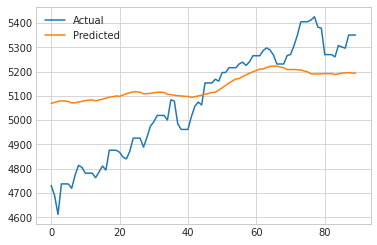

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 151.820
MAPE: 0.031


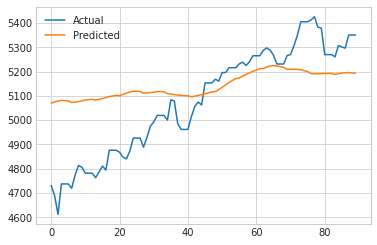

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 151.307
MAPE: 0.030


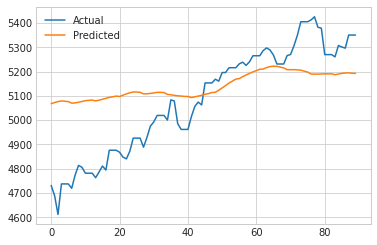

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 148.218
MAPE: 0.030


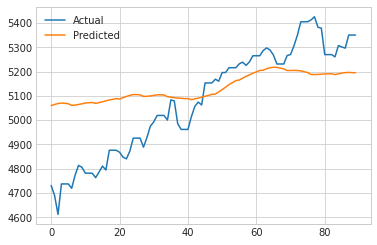

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 148.056
MAPE: 0.030


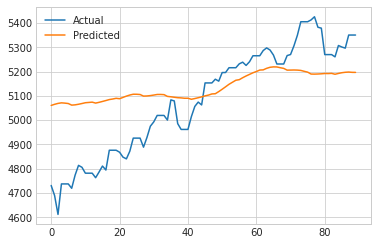

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 148.043
MAPE: 0.030


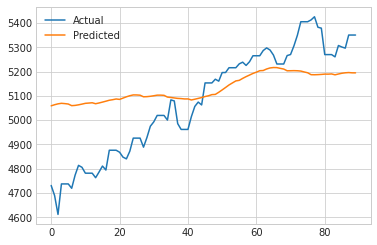

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 148.328
MAPE: 0.030


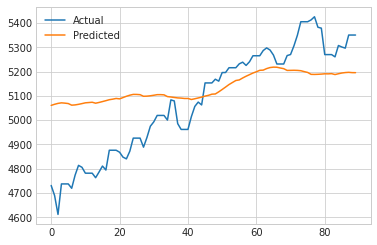

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 148.559
MAPE: 0.030


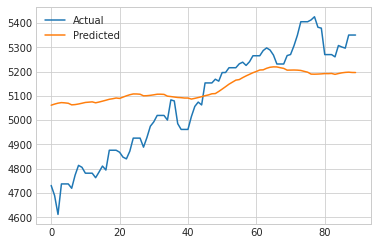

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 144.781
MAPE: 0.029


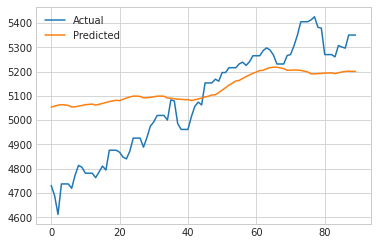

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 144.588
MAPE: 0.029


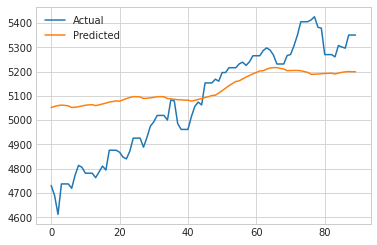

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 145.963
MAPE: 0.029


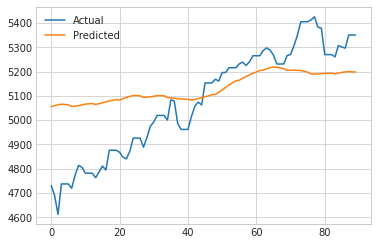

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 144.804
MAPE: 0.029


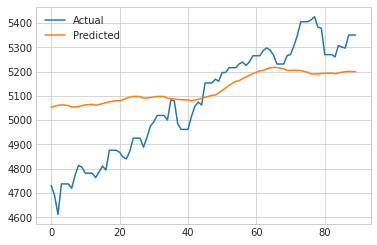

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 144.031
MAPE: 0.029


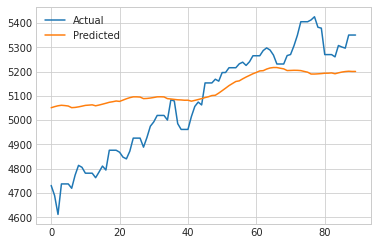

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 141.024
MAPE: 0.028


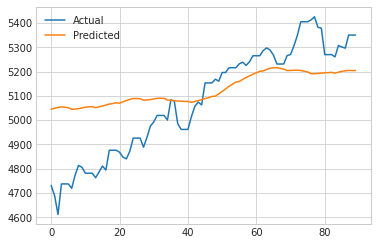

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 140.762
MAPE: 0.028


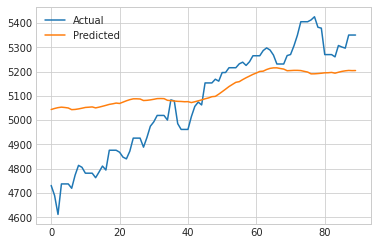

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 142.867
MAPE: 0.029


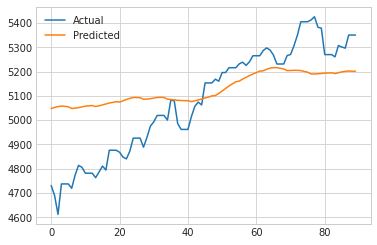

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 142.670
MAPE: 0.029


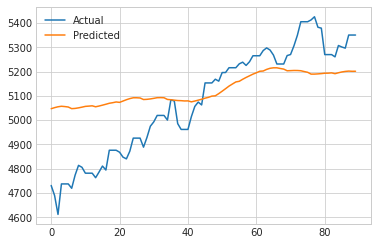

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 142.839
MAPE: 0.029


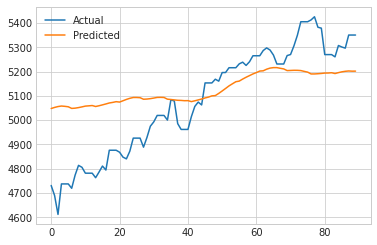

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:프랑스지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 142.199
MAPE: 0.029


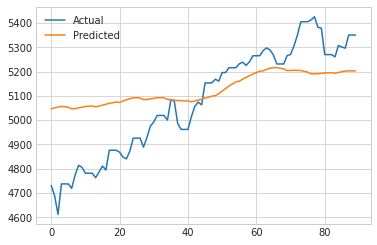

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 140.982
MAPE: 0.028


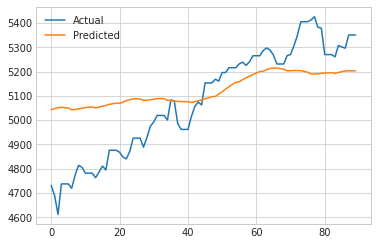

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 141.862
MAPE: 0.029


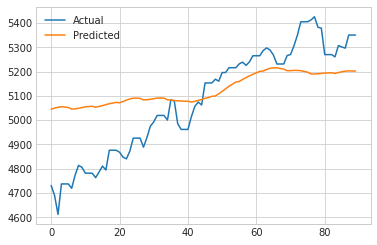

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 140.311
MAPE: 0.028


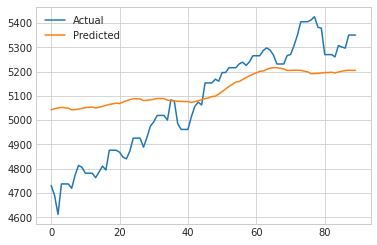

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:프랑스지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 140.385
MAPE: 0.028


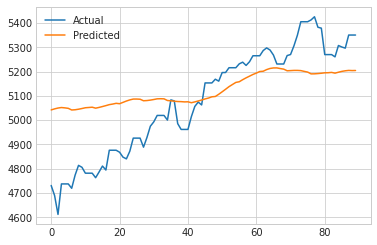

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 147.108
MAPE: 0.021


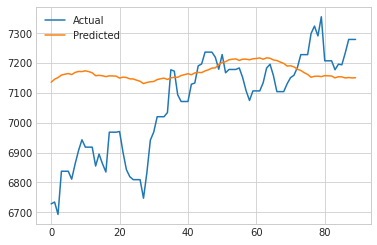

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 147.478
MAPE: 0.021


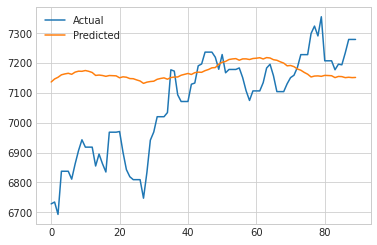

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 146.527
MAPE: 0.021


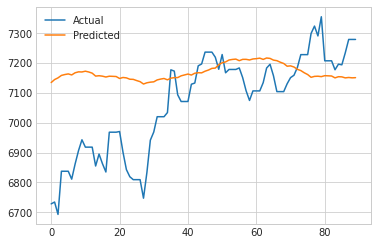

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 147.361
MAPE: 0.021


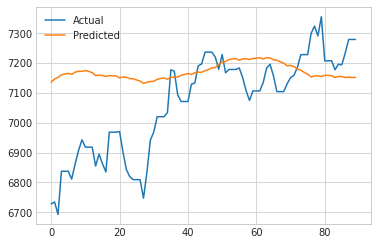

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 148.053
MAPE: 0.021


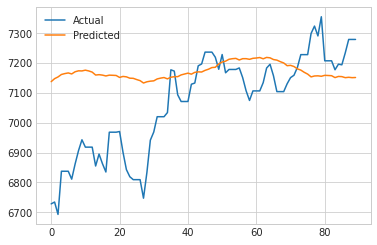

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 136.935
MAPE: 0.020


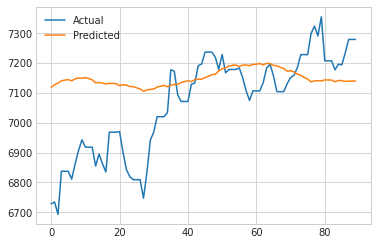

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 137.035
MAPE: 0.020


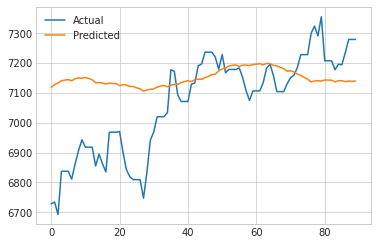

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 136.767
MAPE: 0.020


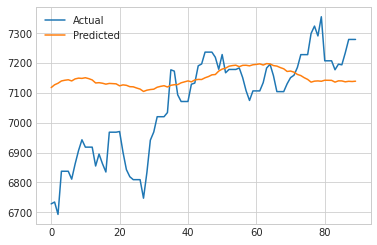

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 137.271
MAPE: 0.020


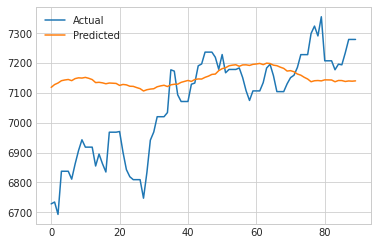

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 136.372
MAPE: 0.020


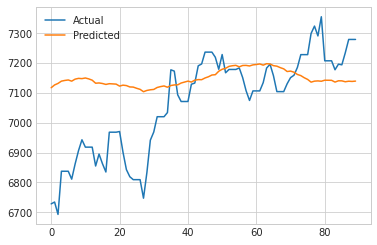

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 133.011
MAPE: 0.019


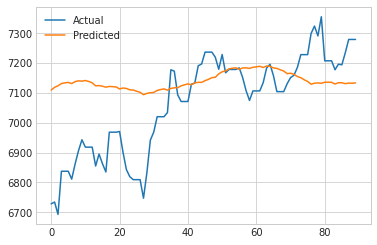

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 131.583
MAPE: 0.019


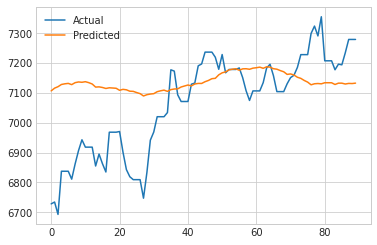

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 131.283
MAPE: 0.019


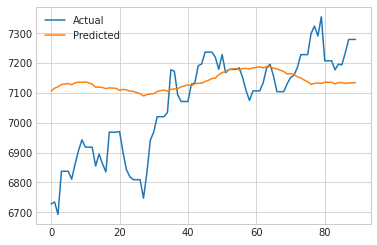

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 132.615
MAPE: 0.019


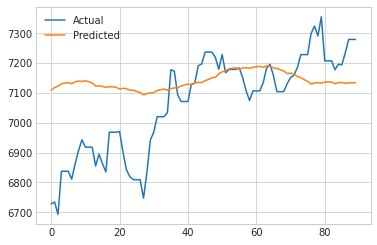

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 131.181
MAPE: 0.019


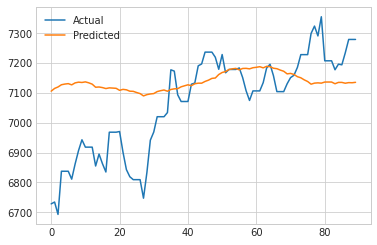

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 128.006
MAPE: 0.018


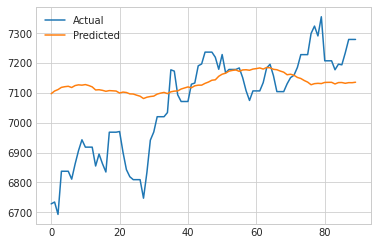

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 126.625
MAPE: 0.018


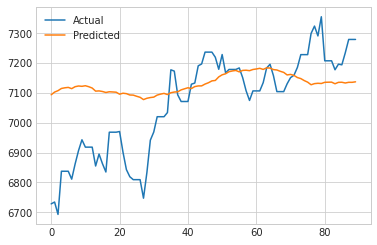

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 128.973
MAPE: 0.019


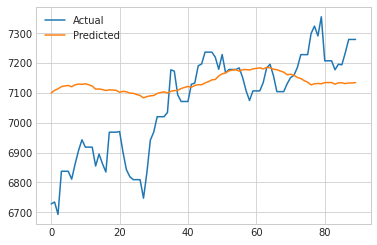

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 128.480
MAPE: 0.018


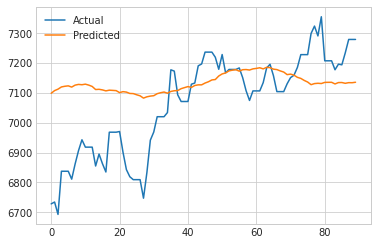

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 128.394
MAPE: 0.018


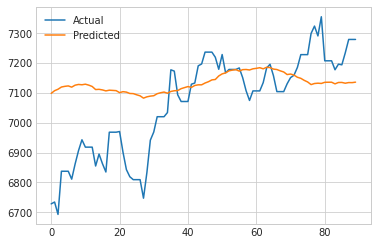

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 126.244
MAPE: 0.018


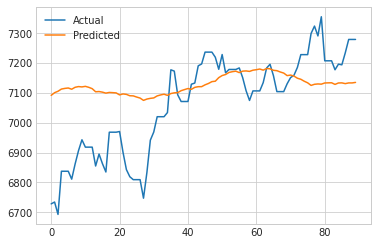

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 127.049
MAPE: 0.018


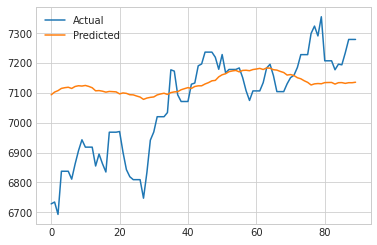

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 125.468
MAPE: 0.018


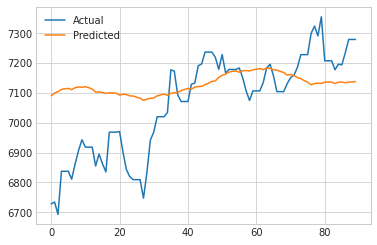

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 125.804
MAPE: 0.018


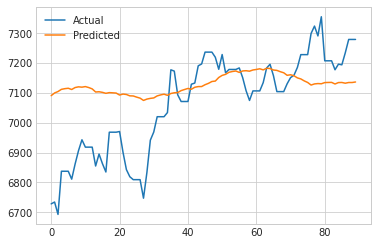

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 127.241
MAPE: 0.018


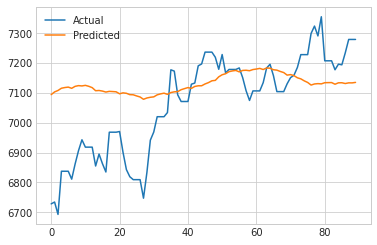

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:영국지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 125.912
MAPE: 0.018


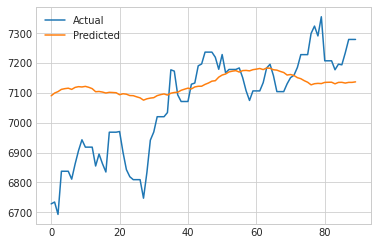

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 126.428
MAPE: 0.018


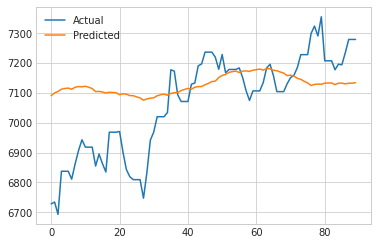

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 123.394
MAPE: 0.018


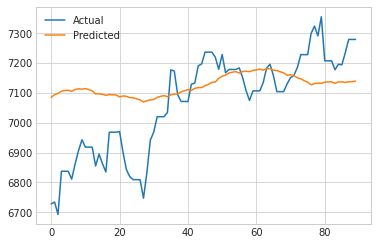

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 123.612
MAPE: 0.018


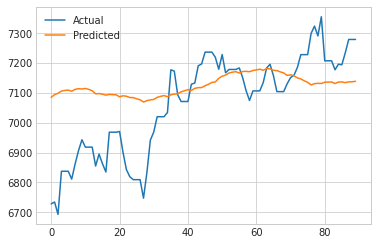

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:영국지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 126.532
MAPE: 0.018


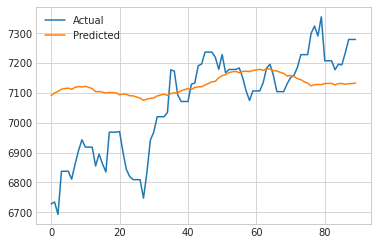

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 315.137
MAPE: 0.029


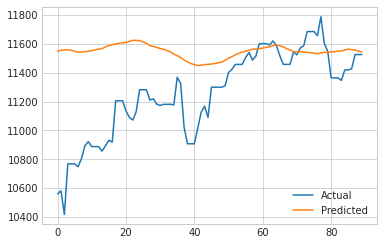

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 314.946
MAPE: 0.029


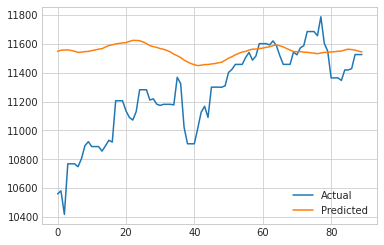

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 314.548
MAPE: 0.029


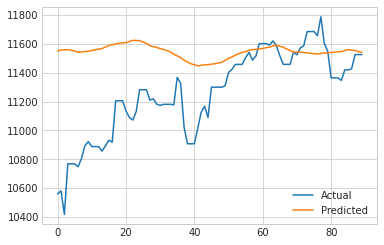

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 314.326
MAPE: 0.029


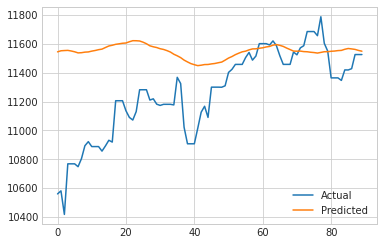

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 314.532
MAPE: 0.029


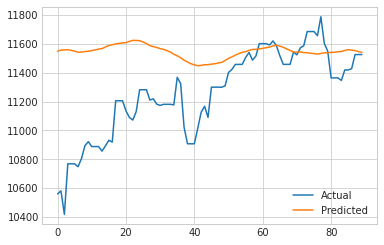

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 303.434
MAPE: 0.028


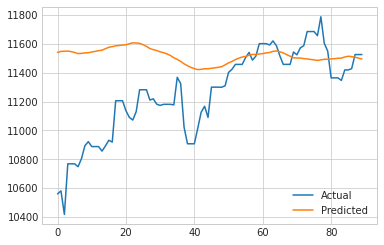

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 301.902
MAPE: 0.027


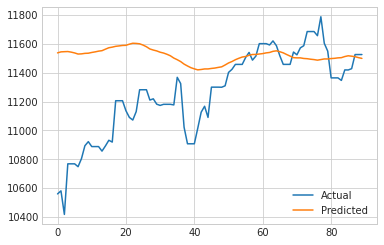

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 302.904
MAPE: 0.028


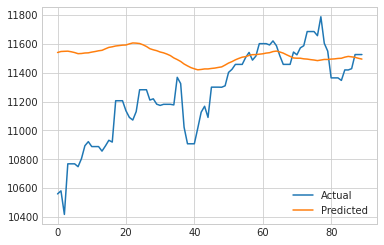

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 303.519
MAPE: 0.028


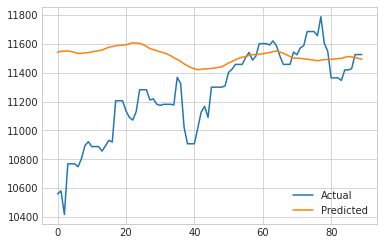

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 302.366
MAPE: 0.027


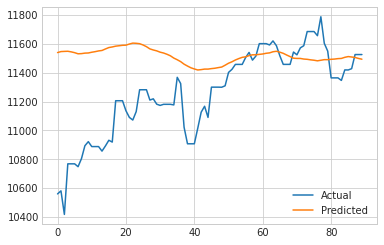

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 290.016
MAPE: 0.026


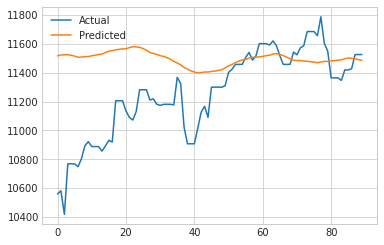

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 291.192
MAPE: 0.026


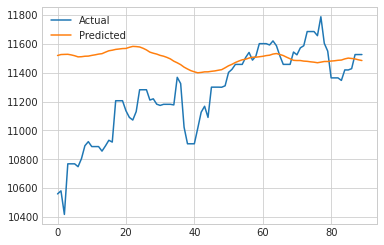

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 290.731
MAPE: 0.026


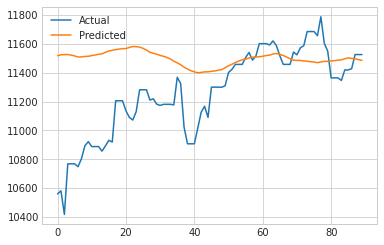

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 290.256
MAPE: 0.026


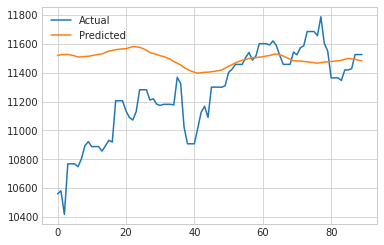

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 290.598
MAPE: 0.026


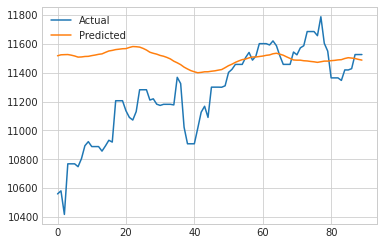

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 283.845
MAPE: 0.026


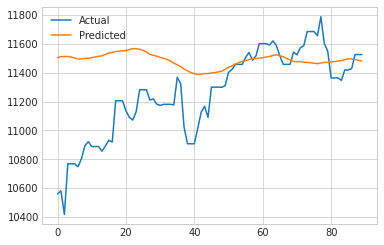

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 281.167
MAPE: 0.026


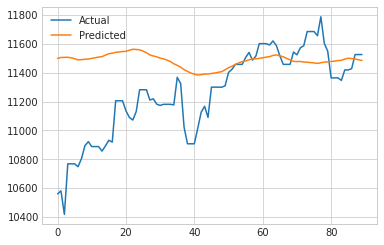

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 283.927
MAPE: 0.026


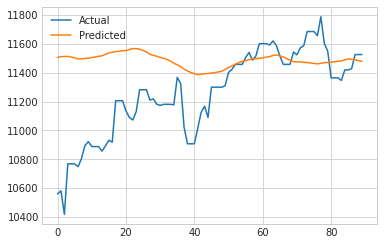

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 283.862
MAPE: 0.026


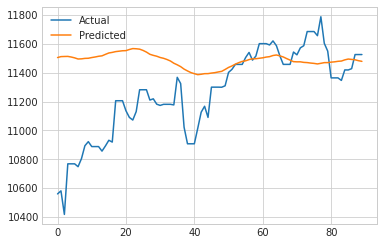

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 284.316
MAPE: 0.026


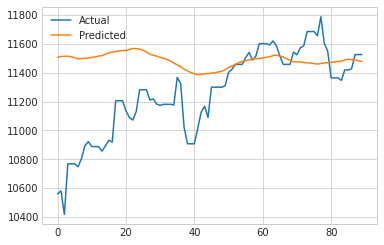

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 279.653
MAPE: 0.025


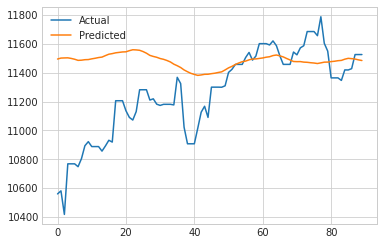

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 279.080
MAPE: 0.025


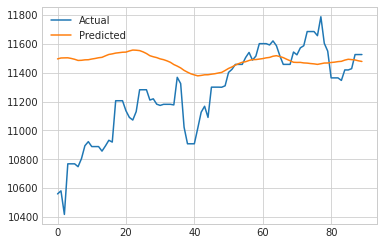

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 279.183
MAPE: 0.025


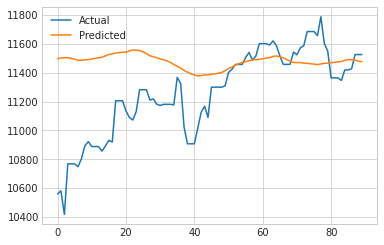

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 275.470
MAPE: 0.025


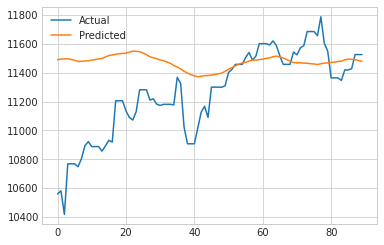

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 279.299
MAPE: 0.025


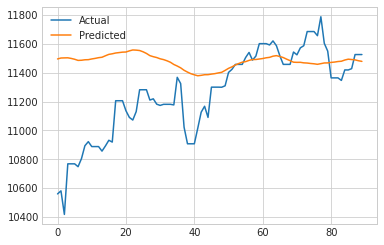

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:독일지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 275.083
MAPE: 0.025


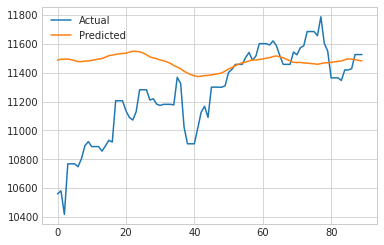

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 274.585
MAPE: 0.025


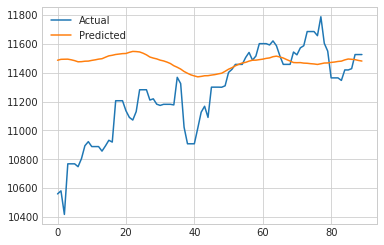

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 274.513
MAPE: 0.025


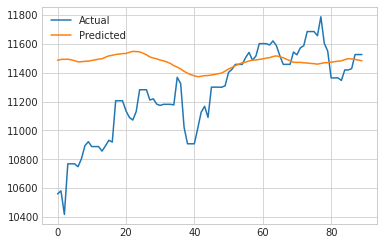

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 274.226
MAPE: 0.025


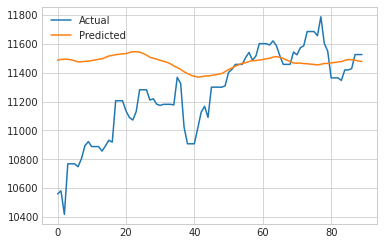

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:독일지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 274.317
MAPE: 0.025


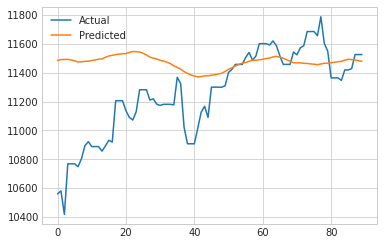

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 84.752
MAPE: 0.032


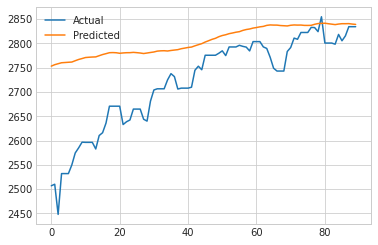

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 84.078
MAPE: 0.032


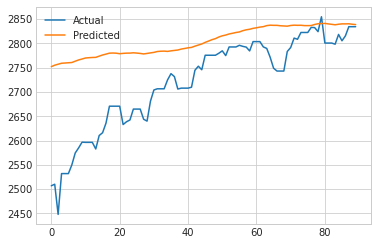

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 83.598
MAPE: 0.032


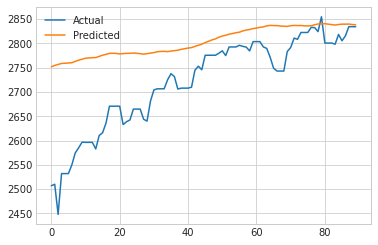

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 84.159
MAPE: 0.032


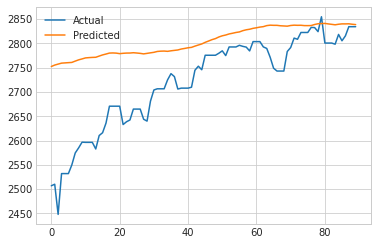

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 84.651
MAPE: 0.032


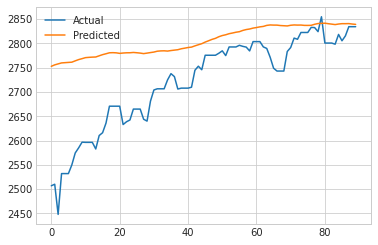

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 79.668
MAPE: 0.030


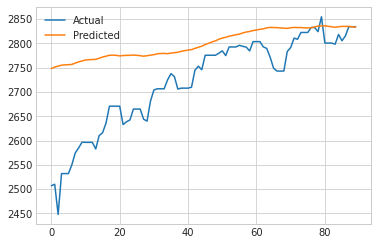

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 79.318
MAPE: 0.030


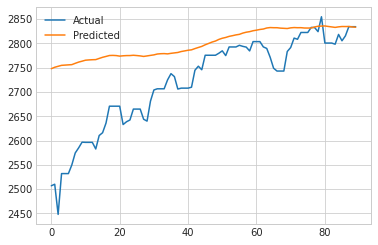

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 80.312
MAPE: 0.030


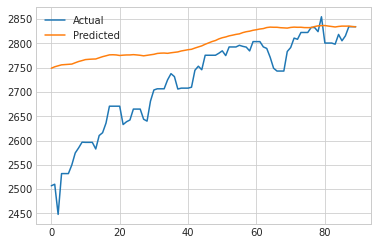

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 79.406
MAPE: 0.030


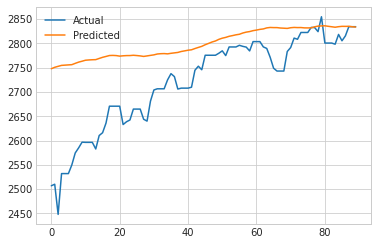

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 79.595
MAPE: 0.030


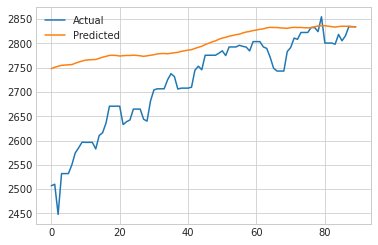

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 77.415
MAPE: 0.029


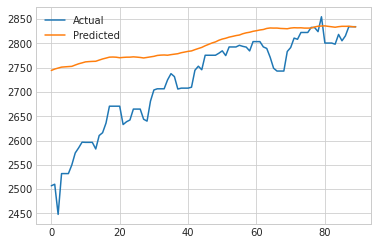

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 78.970
MAPE: 0.030


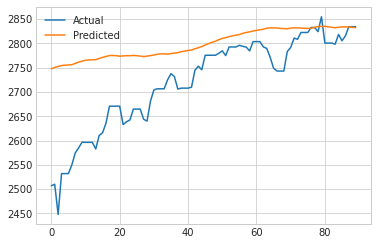

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 77.386
MAPE: 0.029


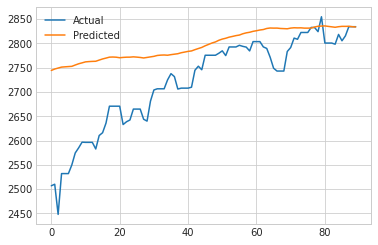

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 77.267
MAPE: 0.029


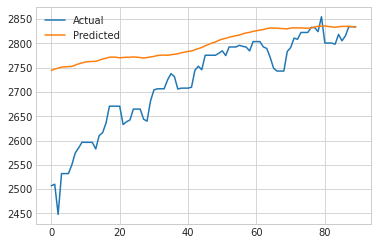

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 78.008
MAPE: 0.030


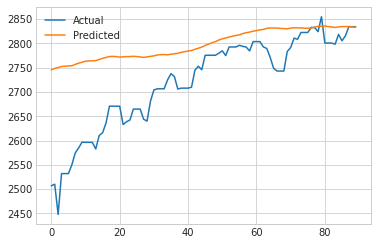

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 76.162
MAPE: 0.029


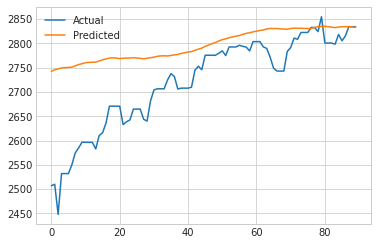

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 76.310
MAPE: 0.029


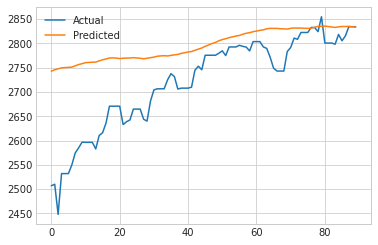

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 76.704
MAPE: 0.029


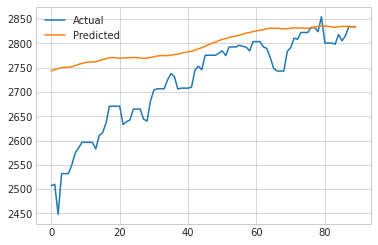

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 77.056
MAPE: 0.029


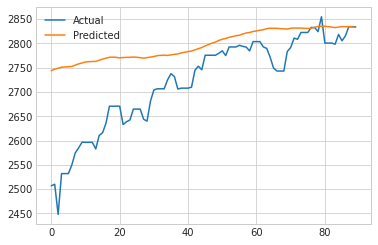

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 76.850
MAPE: 0.029


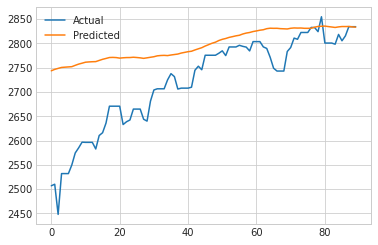

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 75.484
MAPE: 0.029


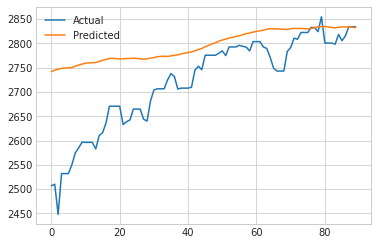

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 75.143
MAPE: 0.029


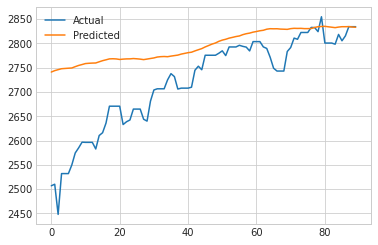

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 75.803
MAPE: 0.029


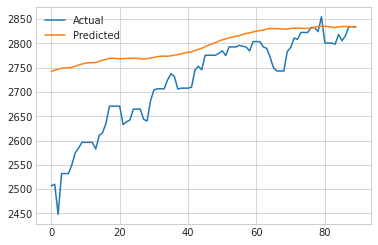

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 75.779
MAPE: 0.029


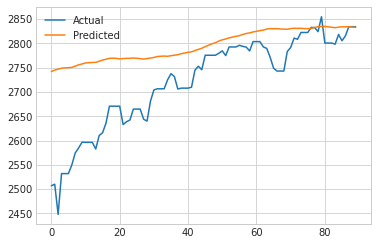

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 75.816
MAPE: 0.029


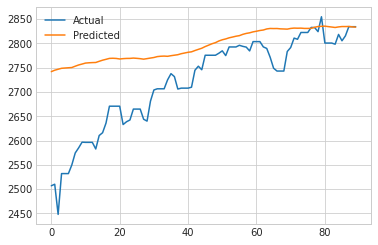

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:S&P500지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 75.417
MAPE: 0.029


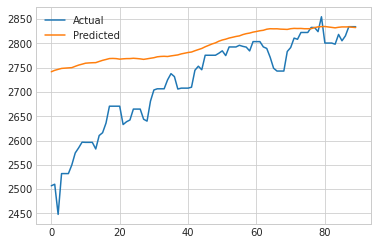

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 75.024
MAPE: 0.028


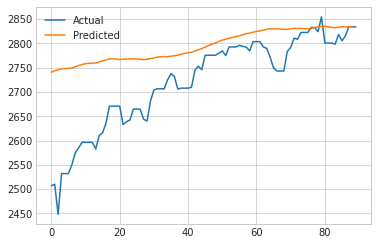

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 74.891
MAPE: 0.028


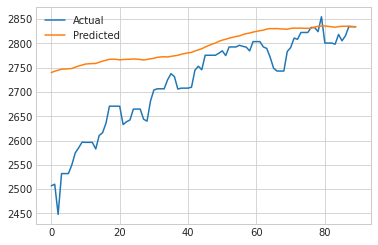

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 74.921
MAPE: 0.028


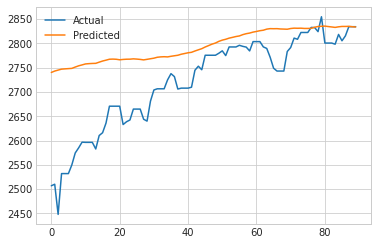

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:S&P500지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 74.310
MAPE: 0.028


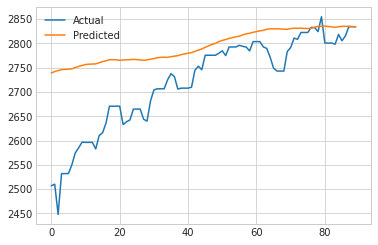

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 791.022
MAPE: 0.029


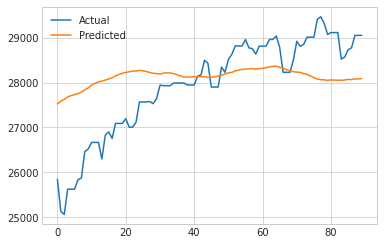

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 787.184
MAPE: 0.029


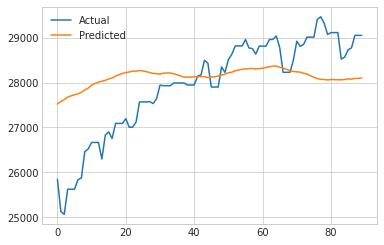

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 756.950
MAPE: 0.028


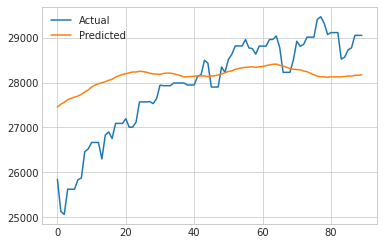

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 788.479
MAPE: 0.029


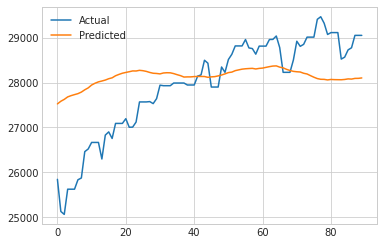

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 782.220
MAPE: 0.029


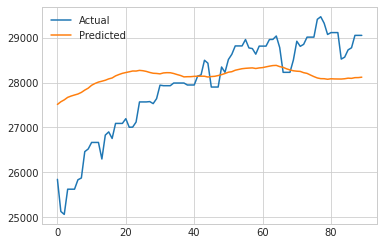

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 719.488
MAPE: 0.027


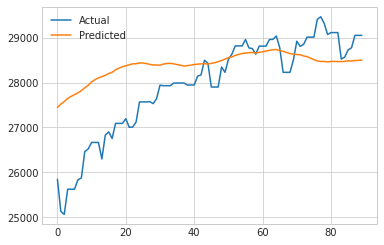

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 718.214
MAPE: 0.027


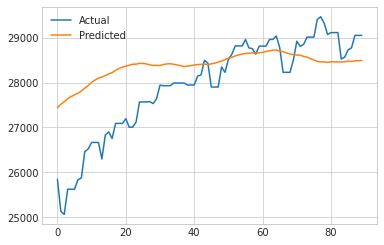

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 718.589
MAPE: 0.027


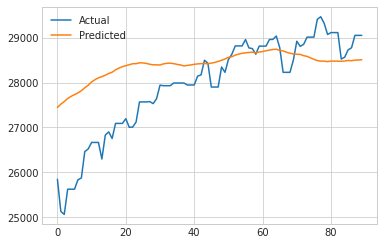

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 720.556
MAPE: 0.027


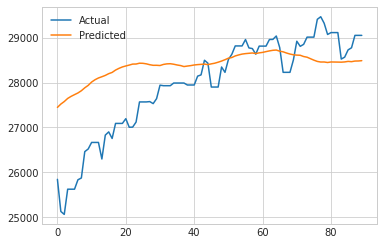

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 714.632
MAPE: 0.026


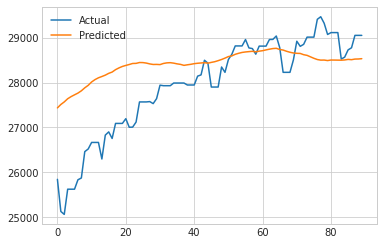

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 703.193
MAPE: 0.026


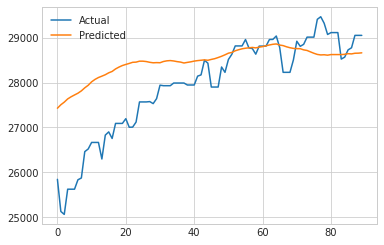

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 704.105
MAPE: 0.026


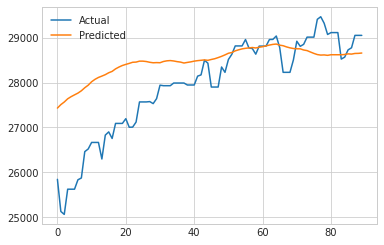

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 705.506
MAPE: 0.026


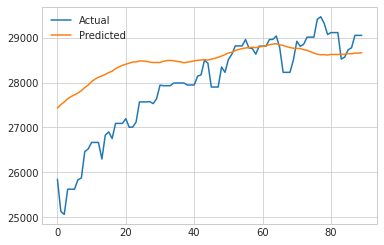

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 705.619
MAPE: 0.026


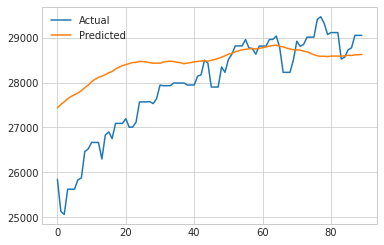

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 704.829
MAPE: 0.026


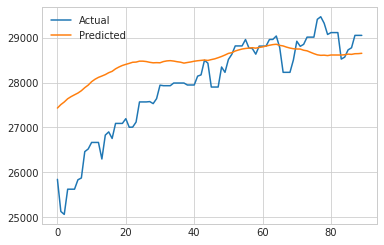

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 702.010
MAPE: 0.026


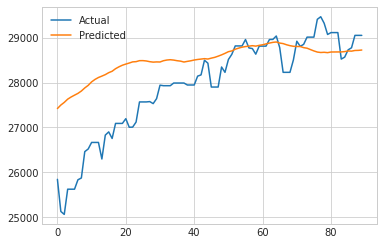

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 701.954
MAPE: 0.026


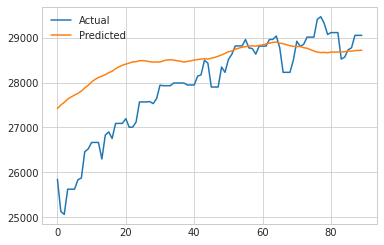

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 699.558
MAPE: 0.026


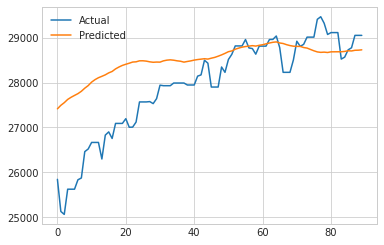

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 698.517
MAPE: 0.026


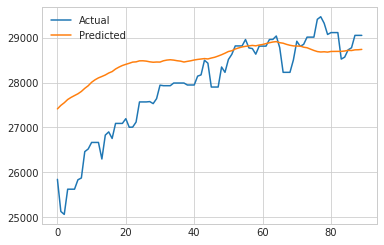

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 700.035
MAPE: 0.026


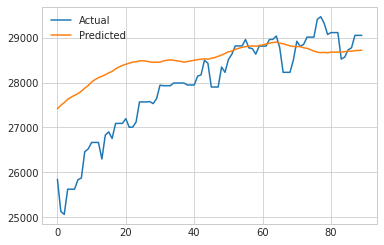

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 694.669
MAPE: 0.026


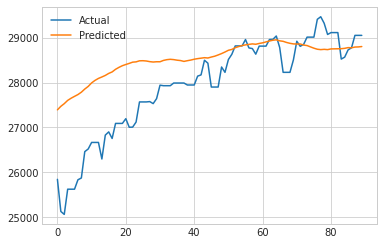

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 696.537
MAPE: 0.026


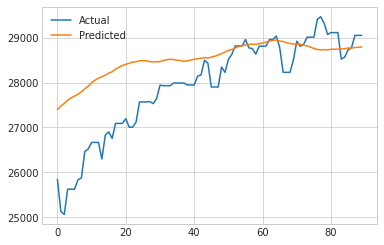

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 694.786
MAPE: 0.026


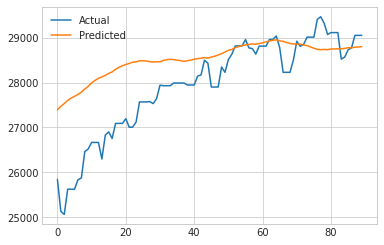

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 697.205
MAPE: 0.026


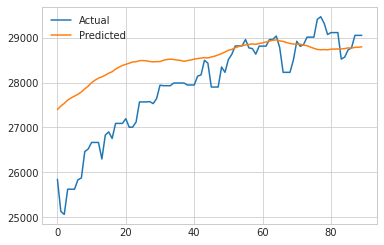

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 694.614
MAPE: 0.026


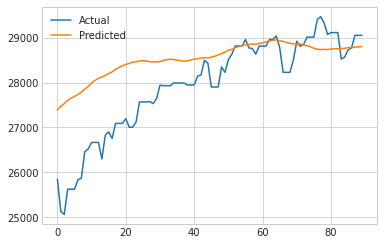

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:항셍지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 696.077
MAPE: 0.026


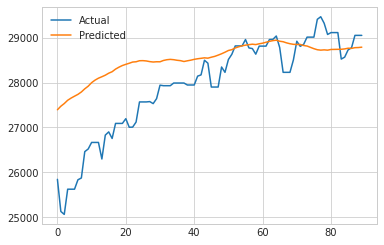

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 693.853
MAPE: 0.026


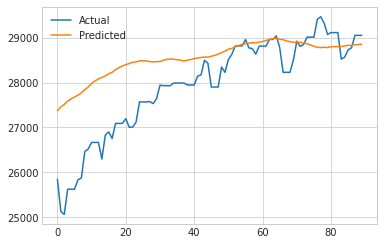

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 696.089
MAPE: 0.026


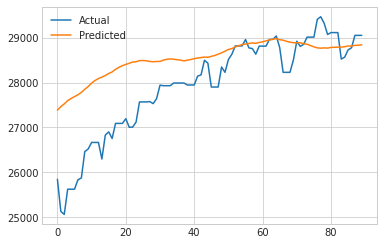

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 696.318
MAPE: 0.026


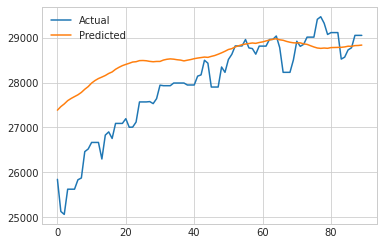

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:항셍지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 696.419
MAPE: 0.026


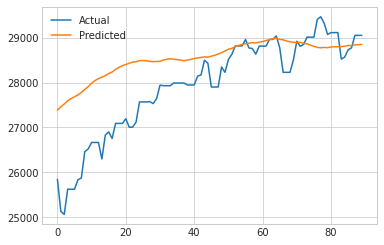

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 337.452
MAPE: 0.047


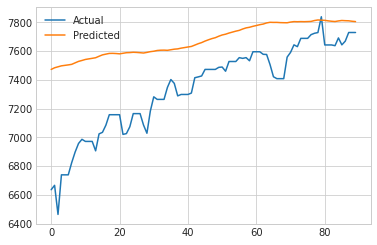

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 337.058
MAPE: 0.047


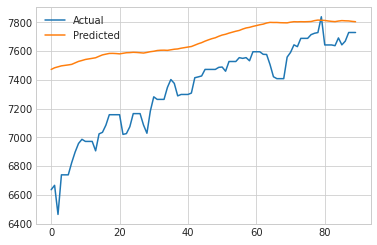

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 336.785
MAPE: 0.047


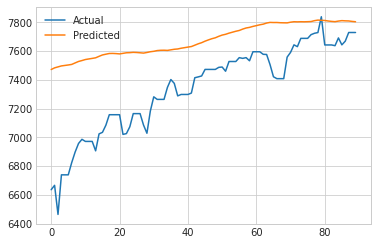

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 336.566
MAPE: 0.047


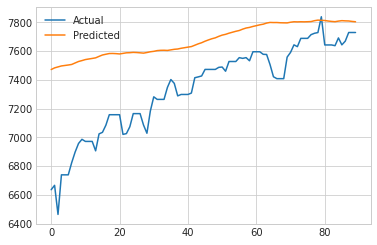

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 335.715
MAPE: 0.047


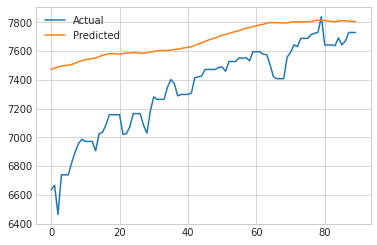

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 318.100
MAPE: 0.045


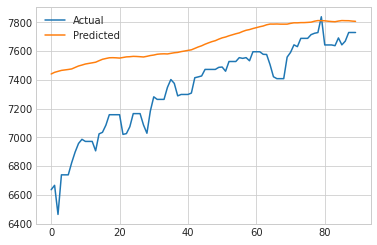

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 317.990
MAPE: 0.045


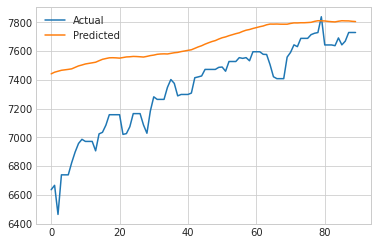

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 318.059
MAPE: 0.045


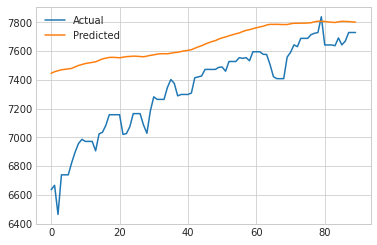

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 318.853
MAPE: 0.045


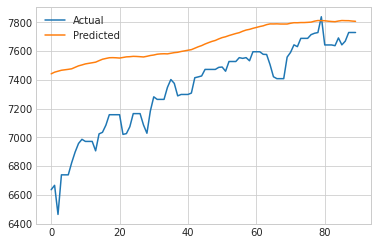

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 317.416
MAPE: 0.044


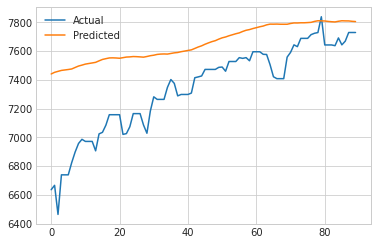

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 310.119
MAPE: 0.043


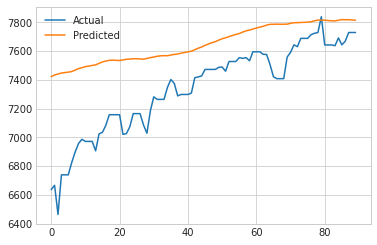

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 310.678
MAPE: 0.043


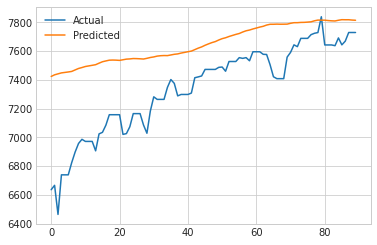

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 310.834
MAPE: 0.044


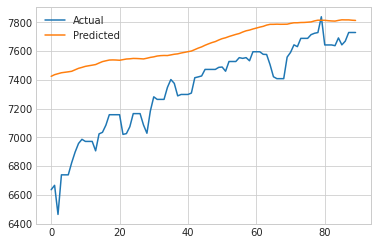

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 311.759
MAPE: 0.044


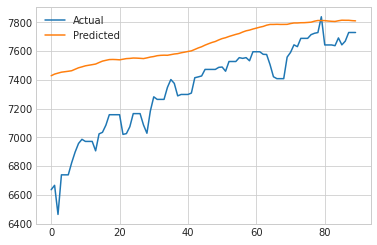

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 311.488
MAPE: 0.044


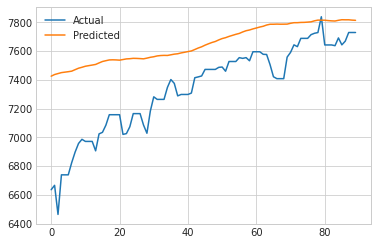

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 303.838
MAPE: 0.043


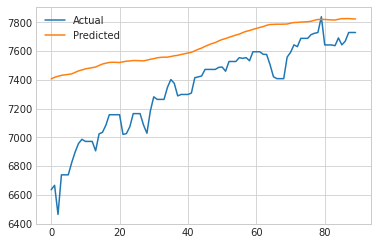

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 304.319
MAPE: 0.043


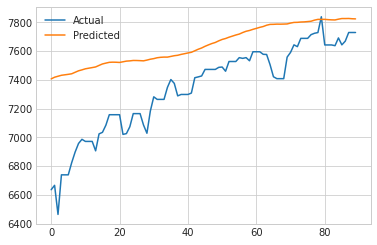

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 303.841
MAPE: 0.043


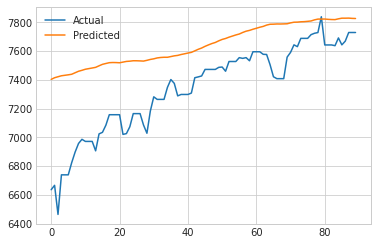

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 304.861
MAPE: 0.043


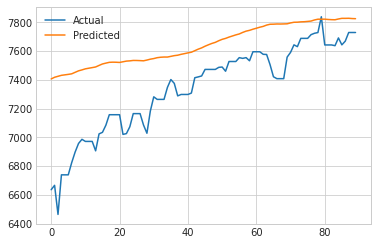

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 301.888
MAPE: 0.042


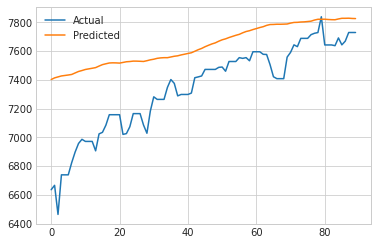

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 299.618
MAPE: 0.042


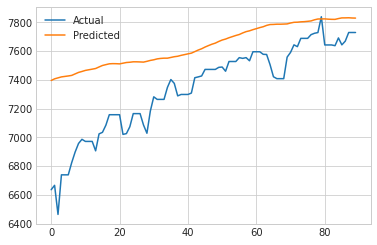

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 301.587
MAPE: 0.042


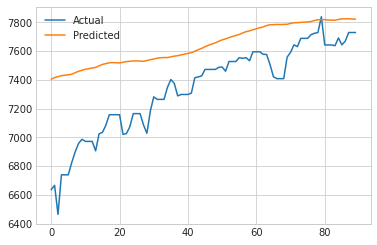

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 298.008
MAPE: 0.042


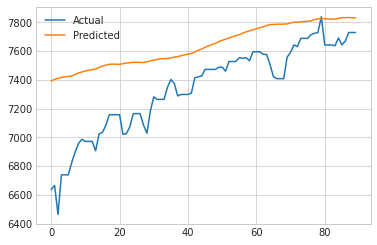

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 299.979
MAPE: 0.042


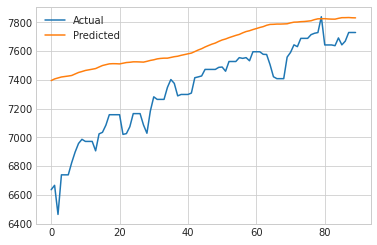

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 299.575
MAPE: 0.042


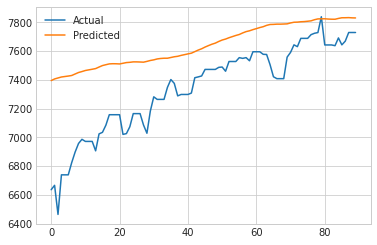

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:나스닥지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 297.856
MAPE: 0.042


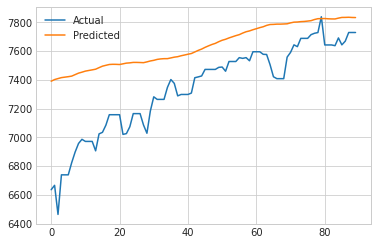

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 295.945
MAPE: 0.041


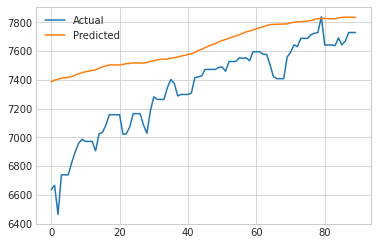

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 295.114
MAPE: 0.041


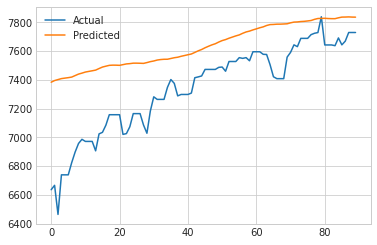

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 294.516
MAPE: 0.041


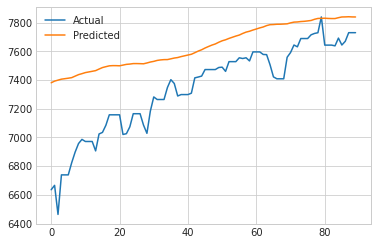

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:나스닥지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 296.436
MAPE: 0.041


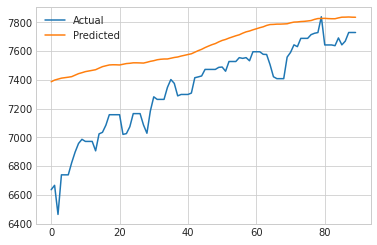

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 46.655
MAPE: 0.022


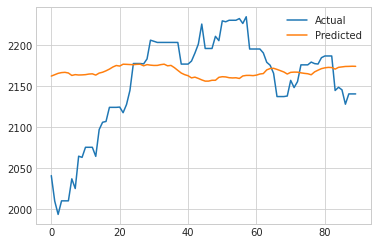

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 46.745
MAPE: 0.022


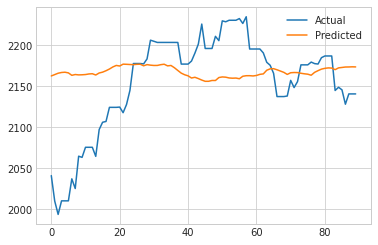

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 46.757
MAPE: 0.022


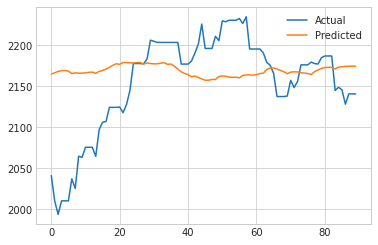

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 46.700
MAPE: 0.022


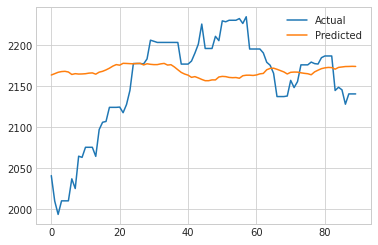

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 46.751
MAPE: 0.022


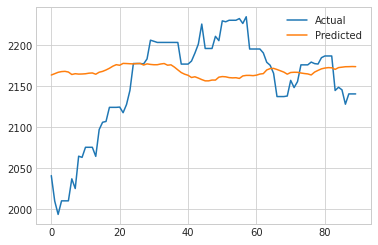

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 45.338
MAPE: 0.021


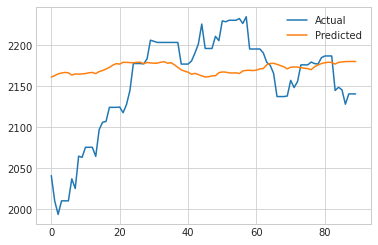

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 45.190
MAPE: 0.021


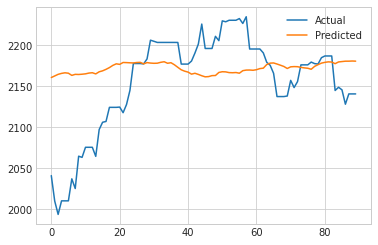

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 45.105
MAPE: 0.021


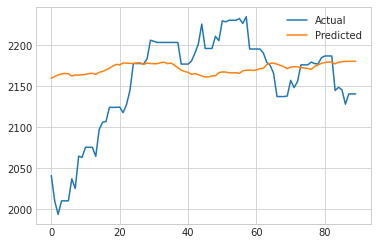

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 45.165
MAPE: 0.021


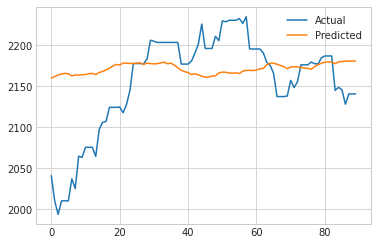

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 45.263
MAPE: 0.021


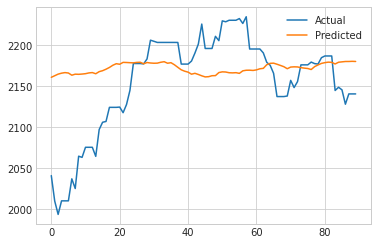

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 44.402
MAPE: 0.021


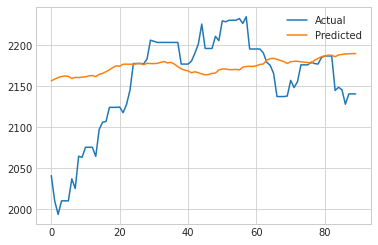

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 44.560
MAPE: 0.021


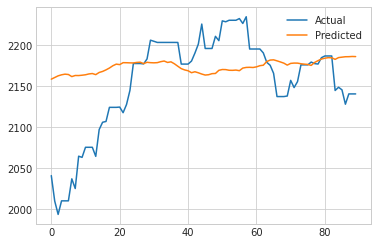

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 44.437
MAPE: 0.021


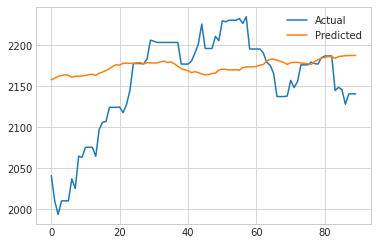

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 44.413
MAPE: 0.021


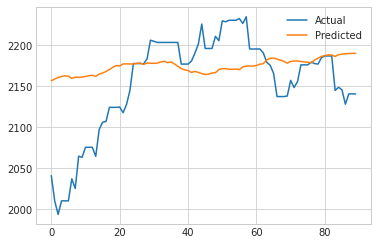

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 44.400
MAPE: 0.021


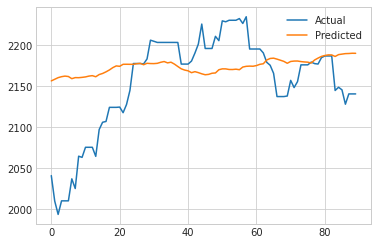

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 44.790
MAPE: 0.021


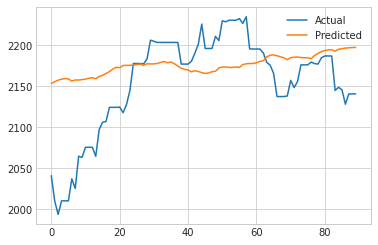

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 44.772
MAPE: 0.021


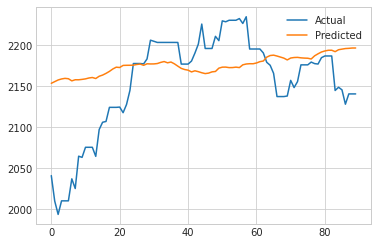

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 44.813
MAPE: 0.021


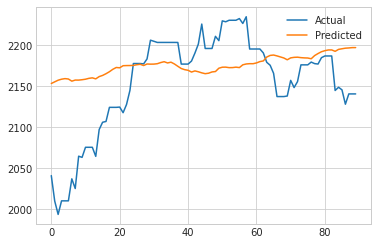

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 44.783
MAPE: 0.021


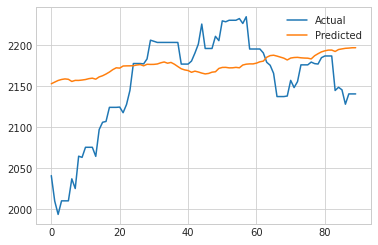

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 44.920
MAPE: 0.021


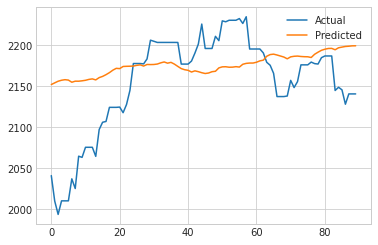

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 45.127
MAPE: 0.021


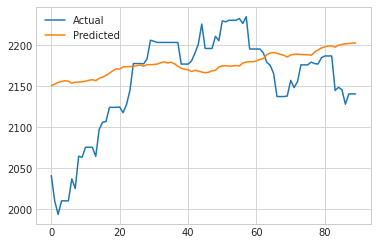

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 45.002
MAPE: 0.021


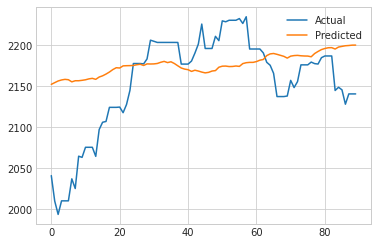

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 45.129
MAPE: 0.021


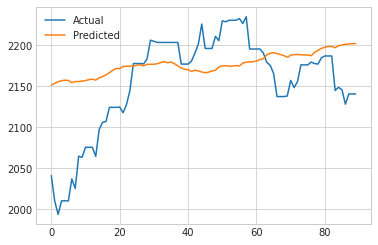

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 44.977
MAPE: 0.021


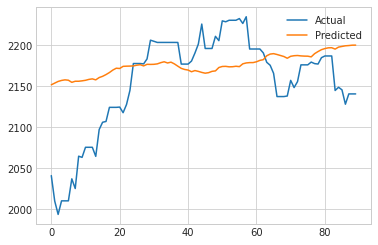

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 44.986
MAPE: 0.021


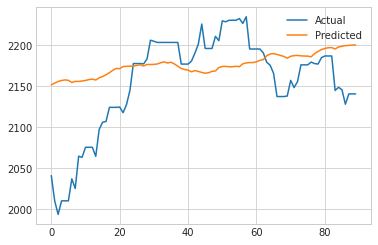

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:코스피지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 45.268
MAPE: 0.021


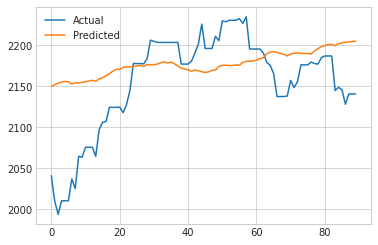

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 45.220
MAPE: 0.021


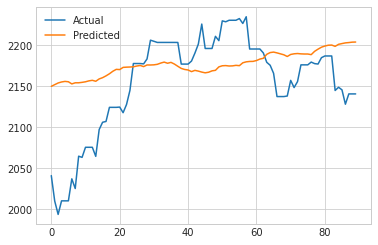

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 45.043
MAPE: 0.021


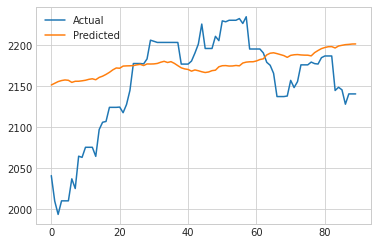

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 45.140
MAPE: 0.021


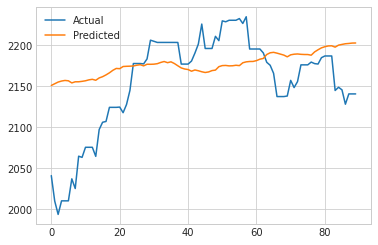

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:코스피지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 45.137
MAPE: 0.021


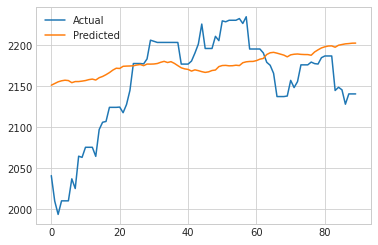

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1236.858
MAPE: 0.060


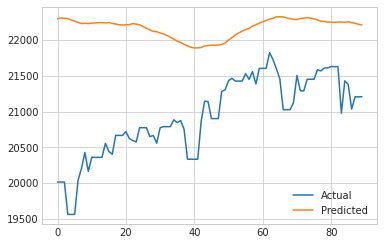

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1243.417
MAPE: 0.060


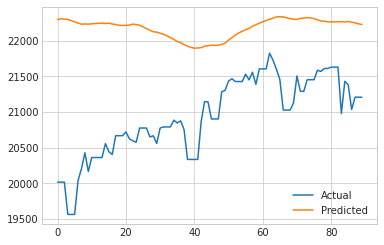

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1243.576
MAPE: 0.060


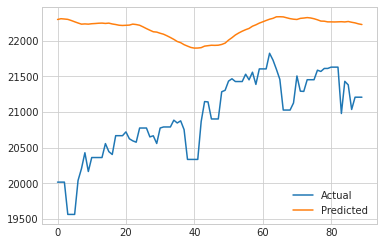

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1243.004
MAPE: 0.060


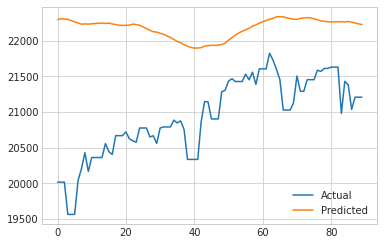

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1243.856
MAPE: 0.060


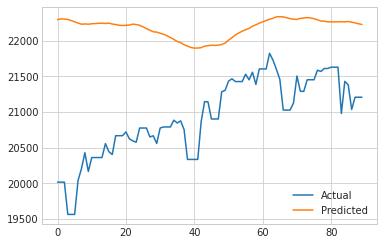

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1191.277
MAPE: 0.058


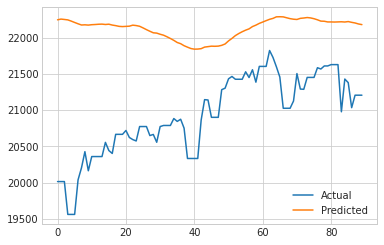

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1193.151
MAPE: 0.058


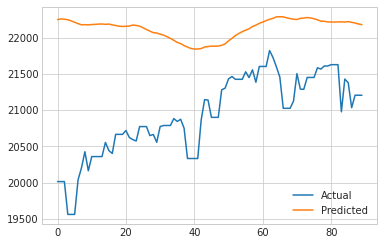

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1193.686
MAPE: 0.058


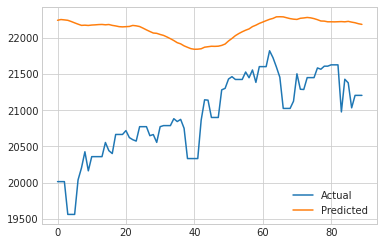

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1191.788
MAPE: 0.058


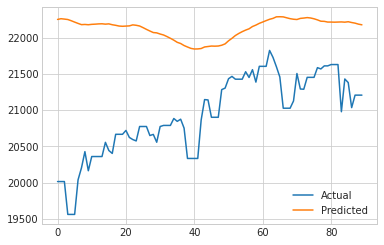

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1194.663
MAPE: 0.058


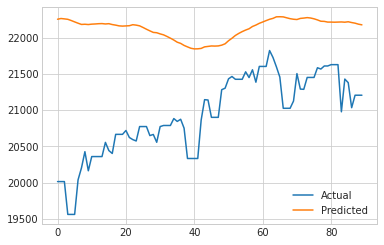

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1165.902
MAPE: 0.056


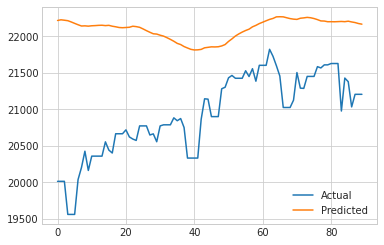

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1165.651
MAPE: 0.056


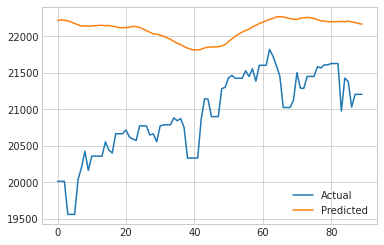

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1166.673
MAPE: 0.056


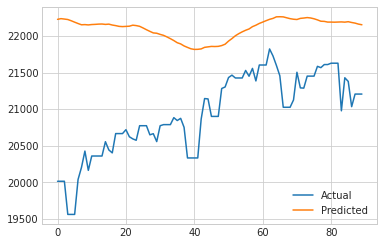

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1168.224
MAPE: 0.056


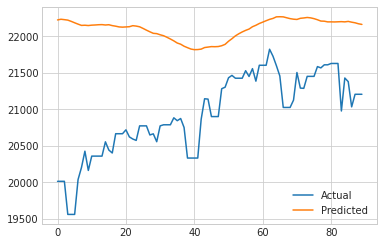

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1167.583
MAPE: 0.056


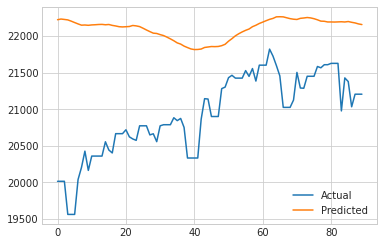

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1137.563
MAPE: 0.055


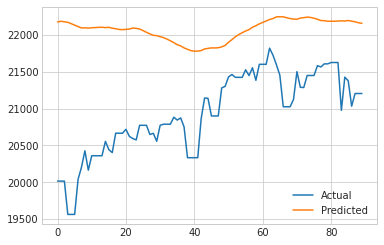

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1140.812
MAPE: 0.055


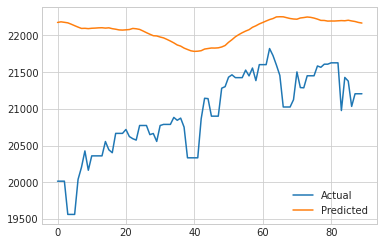

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1138.986
MAPE: 0.055


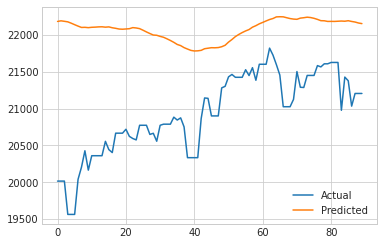

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1139.885
MAPE: 0.055


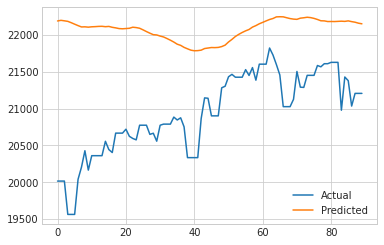

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1142.745
MAPE: 0.055


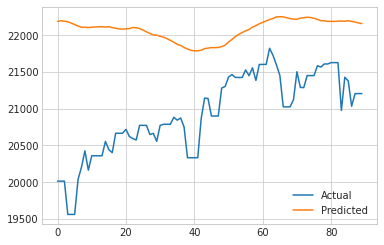

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1122.513
MAPE: 0.054


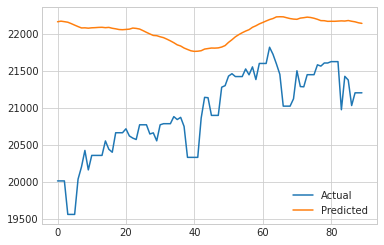

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1122.024
MAPE: 0.054


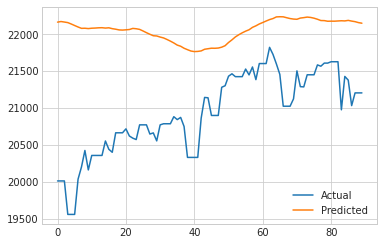

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1117.335
MAPE: 0.054


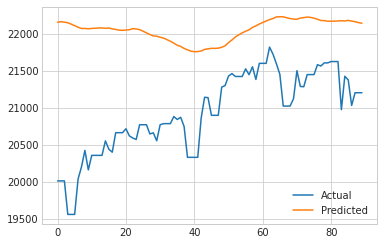

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1128.445
MAPE: 0.055


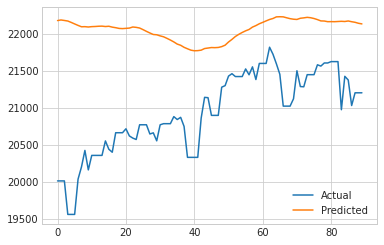

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1126.003
MAPE: 0.054


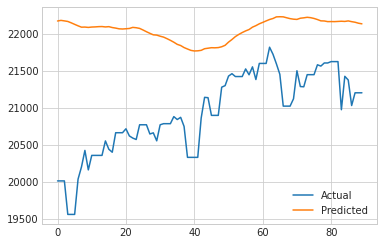

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:니케이225지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 1108.170
MAPE: 0.054


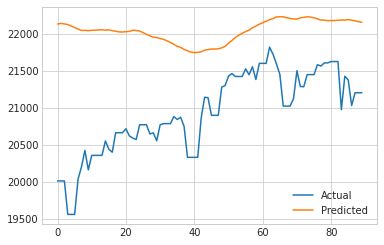

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 1108.364
MAPE: 0.054


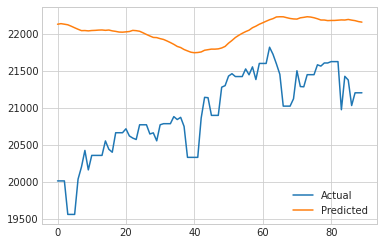

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 1108.027
MAPE: 0.054


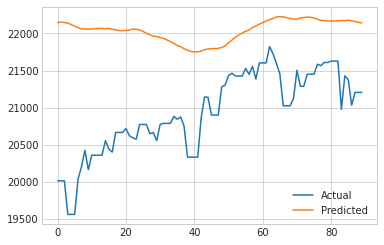

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 1110.957
MAPE: 0.054


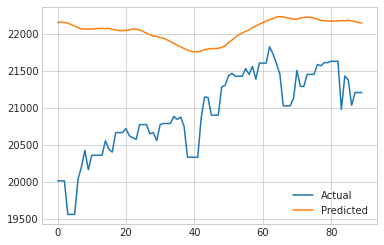

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:니케이225지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 1109.111
MAPE: 0.054


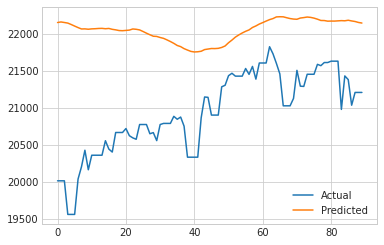

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 87.462
MAPE: 0.028


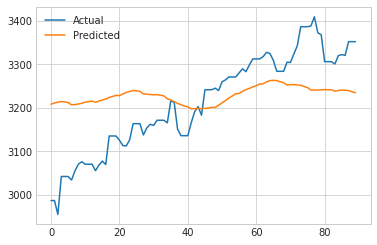

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 87.160
MAPE: 0.027


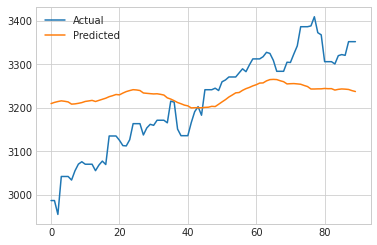

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 86.942
MAPE: 0.027


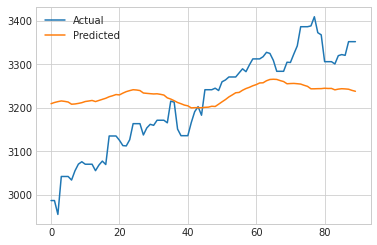

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 87.529
MAPE: 0.028


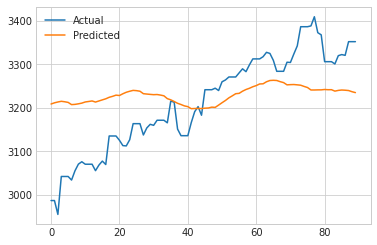

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 86.982
MAPE: 0.027


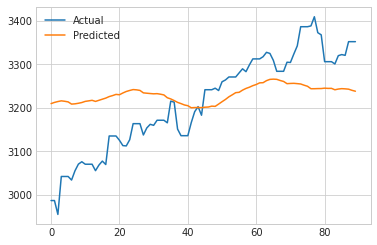

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 90.106
MAPE: 0.028


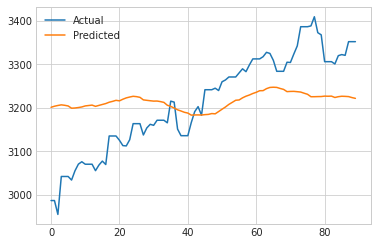

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 90.508
MAPE: 0.028


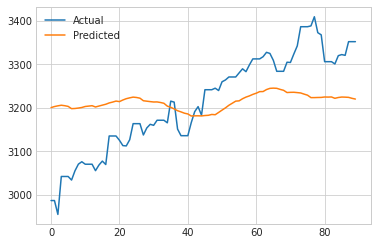

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 89.975
MAPE: 0.028


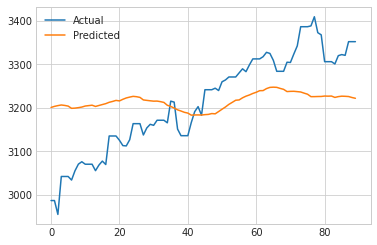

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 89.122
MAPE: 0.028


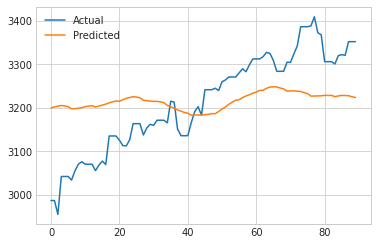

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 89.976
MAPE: 0.028


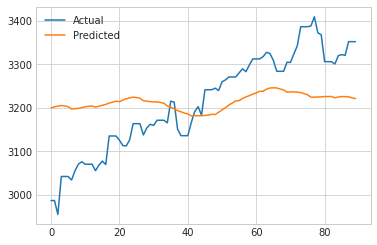

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 88.932
MAPE: 0.028


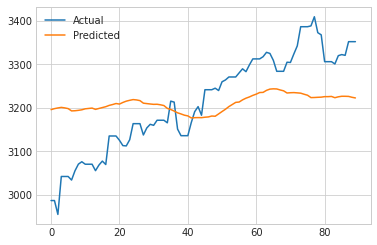

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 88.825
MAPE: 0.028


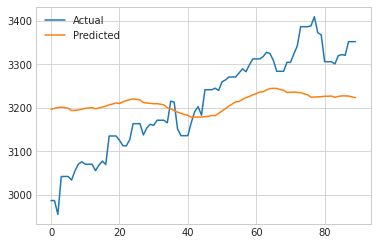

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 88.911
MAPE: 0.028


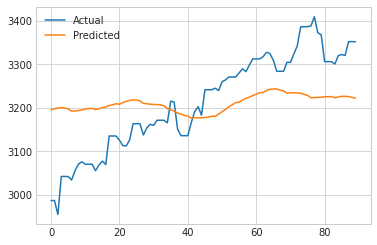

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 88.191
MAPE: 0.028


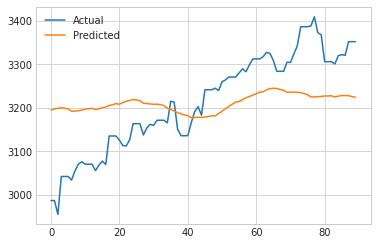

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 88.750
MAPE: 0.028


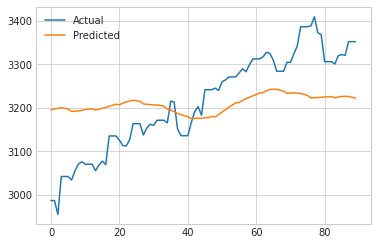

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 87.918
MAPE: 0.027


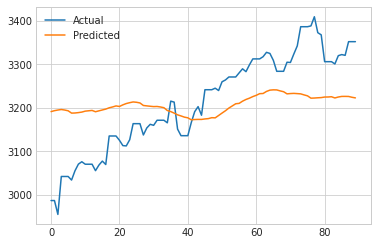

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 87.399
MAPE: 0.027


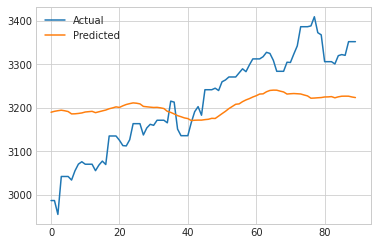

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 87.806
MAPE: 0.027


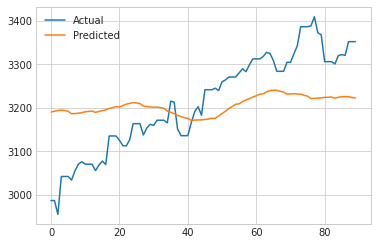

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 87.739
MAPE: 0.027


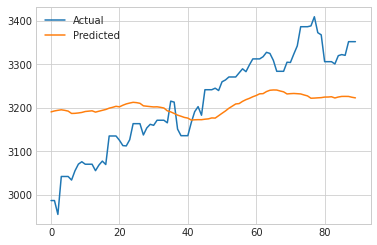

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 87.868
MAPE: 0.027


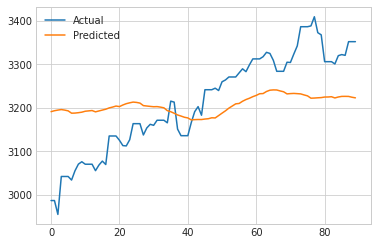

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 87.437
MAPE: 0.027


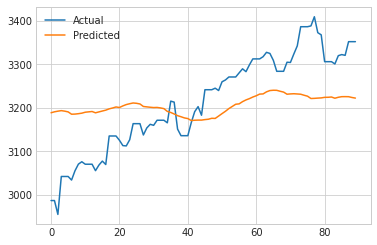

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 87.347
MAPE: 0.027


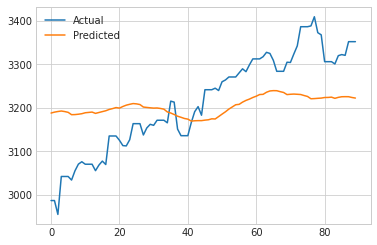

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 87.315
MAPE: 0.027


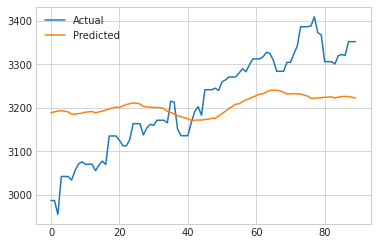

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 87.364
MAPE: 0.027


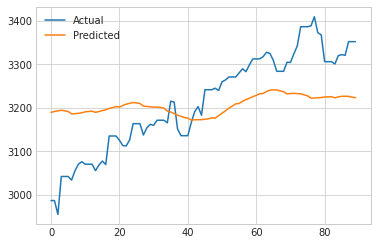

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 87.042
MAPE: 0.027


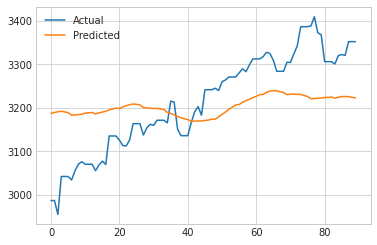

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:유로스톡스50지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 86.827
MAPE: 0.027


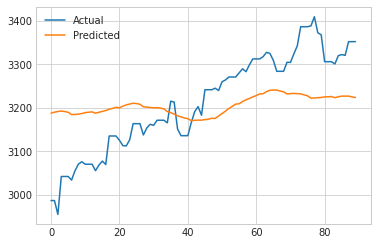

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 86.676
MAPE: 0.027


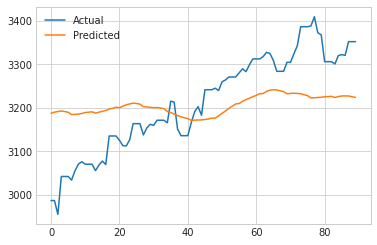

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 86.576
MAPE: 0.027


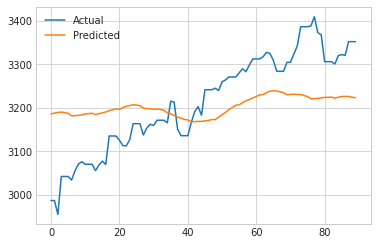

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 86.885
MAPE: 0.027


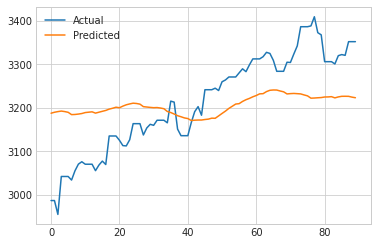

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:유로스톡스50지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 86.400
MAPE: 0.027


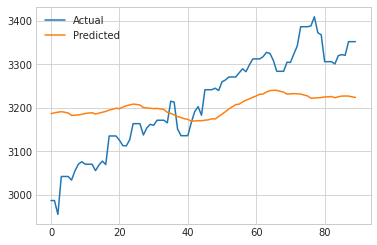

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 100.486
MAPE: 0.017


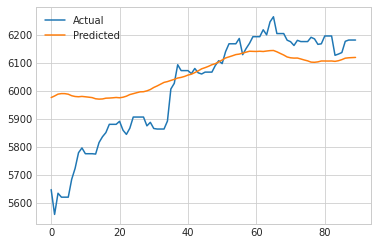

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 100.805
MAPE: 0.017


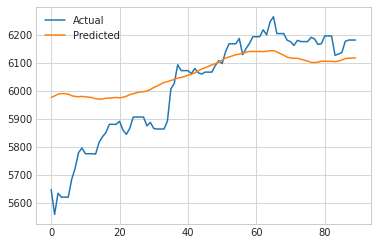

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 100.425
MAPE: 0.017


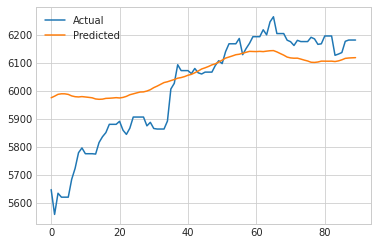

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 100.537
MAPE: 0.017


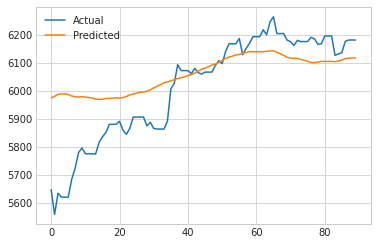

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 100.410
MAPE: 0.017


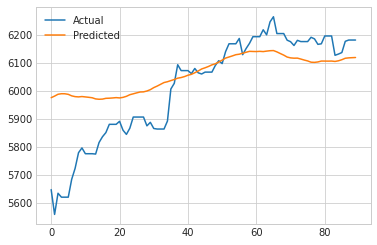

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 100.323
MAPE: 0.017


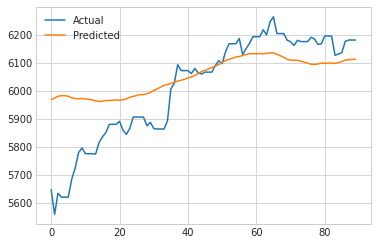

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 100.556
MAPE: 0.017


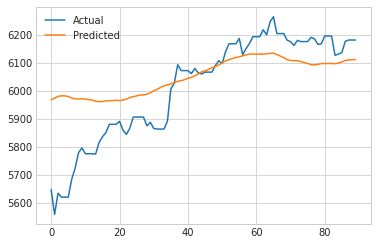

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 100.642
MAPE: 0.017


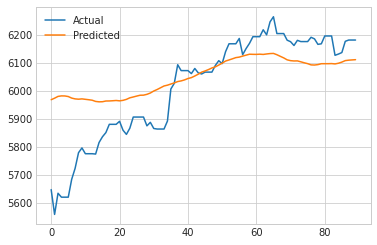

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 100.872
MAPE: 0.017


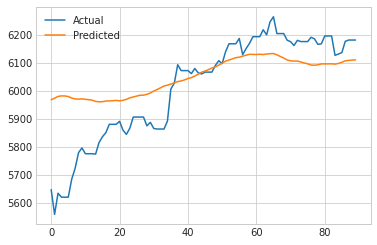

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 100.608
MAPE: 0.017


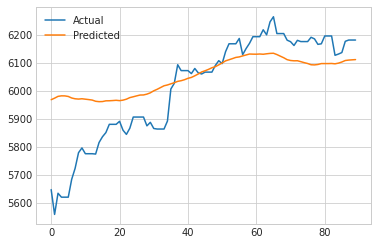

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 101.417
MAPE: 0.017


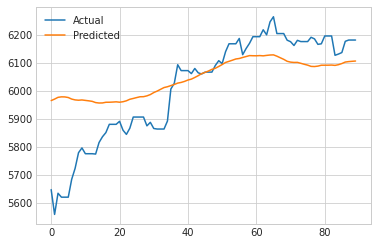

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 101.256
MAPE: 0.017


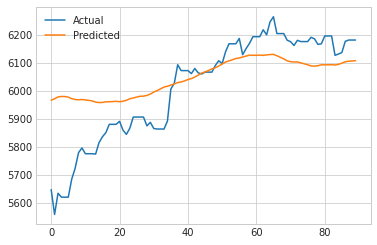

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 101.194
MAPE: 0.017


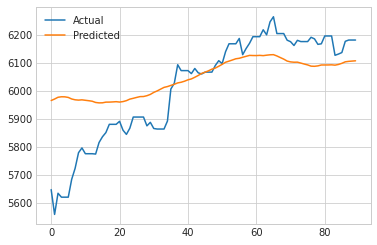

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 101.391
MAPE: 0.017


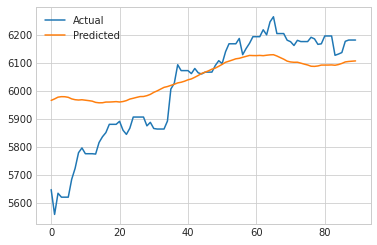

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 101.266
MAPE: 0.017


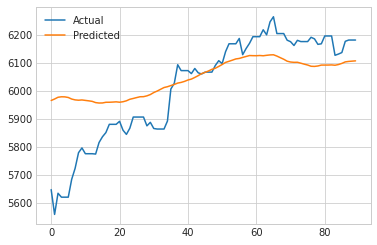

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 100.348
MAPE: 0.017


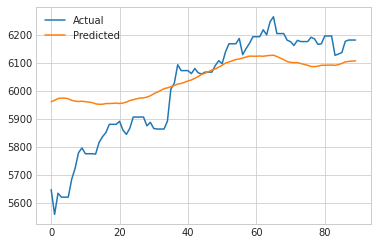

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 100.430
MAPE: 0.017


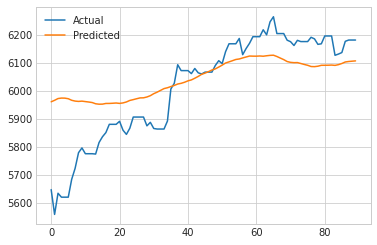

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 100.260
MAPE: 0.017


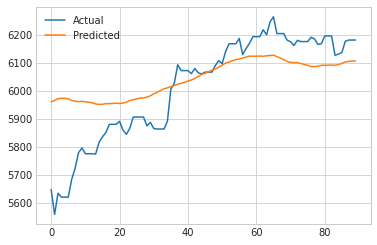

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 100.295
MAPE: 0.017


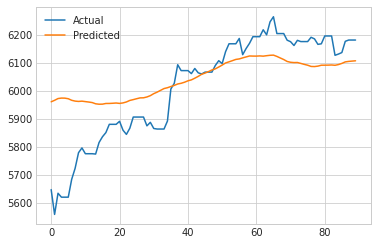

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 100.169
MAPE: 0.017


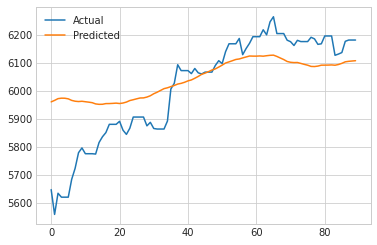

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 99.703
MAPE: 0.017


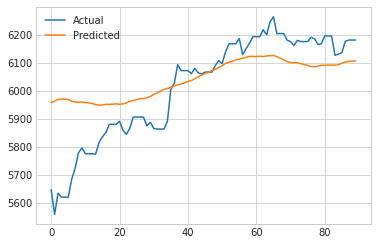

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 99.710
MAPE: 0.017


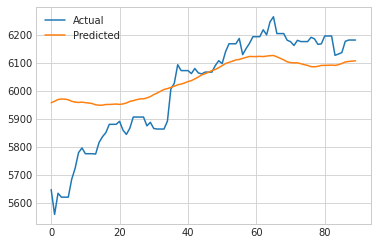

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 99.915
MAPE: 0.017


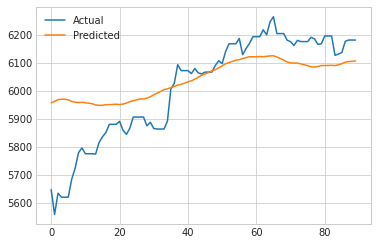

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 100.110
MAPE: 0.017


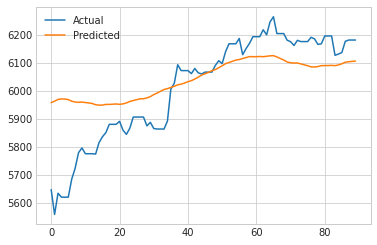

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 99.837
MAPE: 0.017


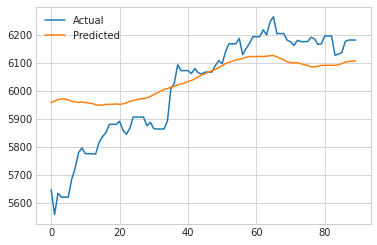

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:호주지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 99.390
MAPE: 0.017


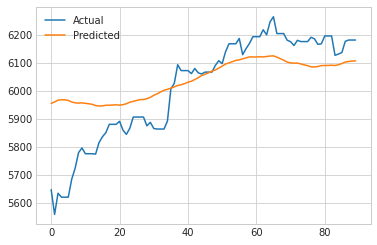

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 99.195
MAPE: 0.017


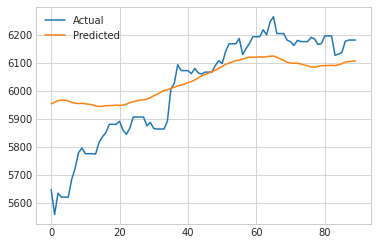

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 98.863
MAPE: 0.017


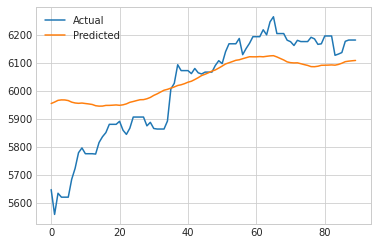

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 99.348
MAPE: 0.017


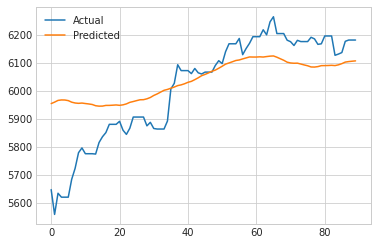

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:호주지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 99.134
MAPE: 0.017


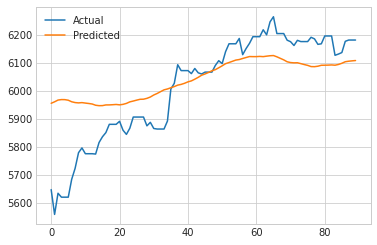

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 1
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 321.448
MAPE: 0.021


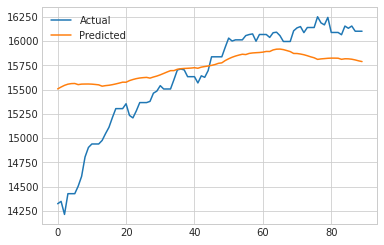

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 1
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 317.040
MAPE: 0.021


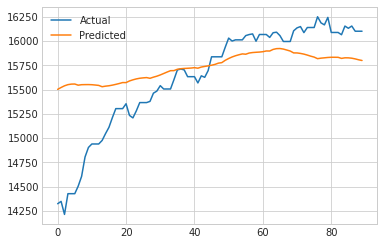

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 1
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 319.419
MAPE: 0.021


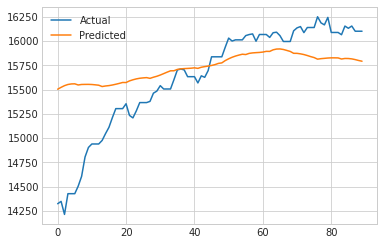

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 1
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 318.368
MAPE: 0.021


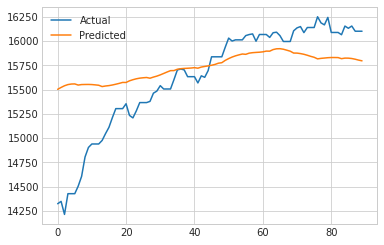

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 1
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 317.735
MAPE: 0.021


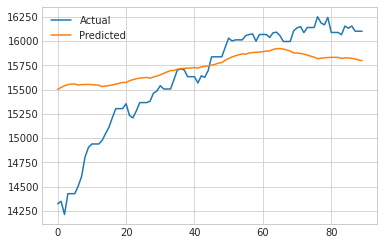

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 2
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 323.839
MAPE: 0.021


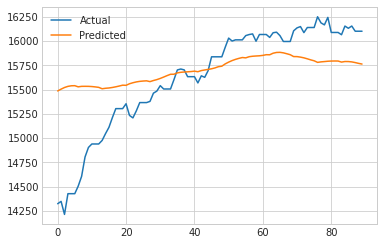

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 2
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 326.043
MAPE: 0.021


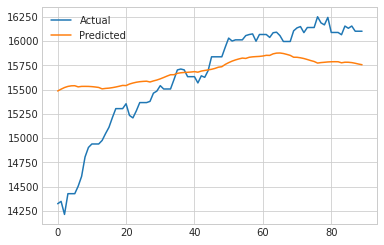

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 2
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 321.527
MAPE: 0.021


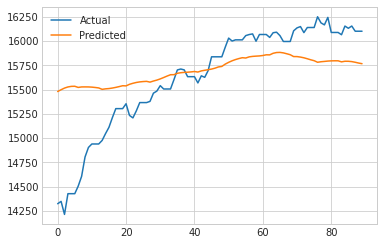

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 2
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 325.333
MAPE: 0.021


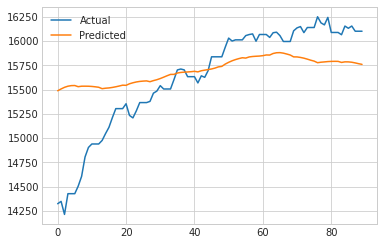

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 2
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 324.729
MAPE: 0.021


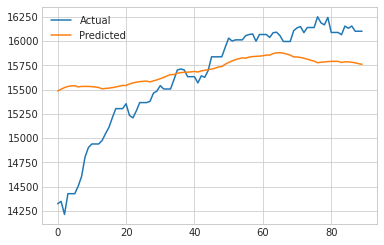

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 3
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 319.248
MAPE: 0.021


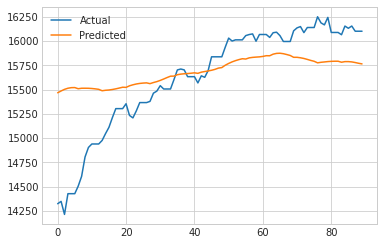

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 3
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 319.256
MAPE: 0.021


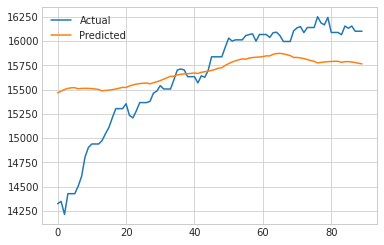

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 3
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 318.512
MAPE: 0.021


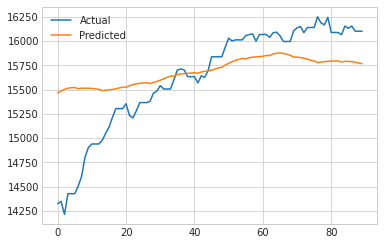

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 3
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 320.948
MAPE: 0.021


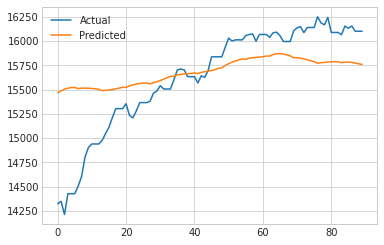

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 3
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 319.369
MAPE: 0.021


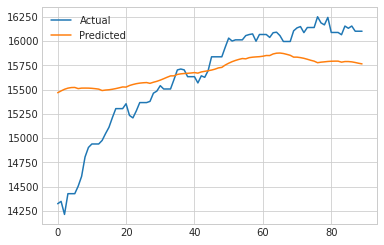

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 4
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 317.841
MAPE: 0.021


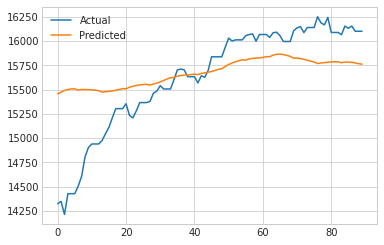

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 4
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 317.420
MAPE: 0.021


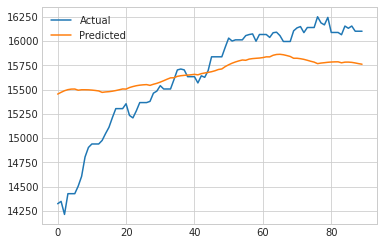

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 4
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 317.246
MAPE: 0.021


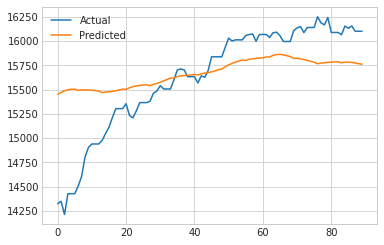

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 4
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 317.719
MAPE: 0.021


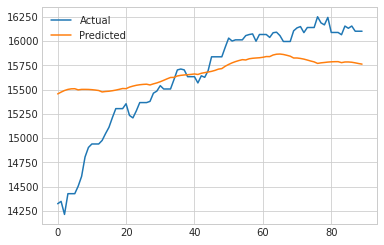

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 4
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 317.745
MAPE: 0.021


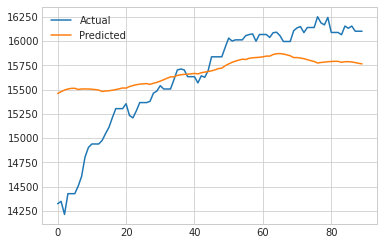

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 5
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 315.699
MAPE: 0.021


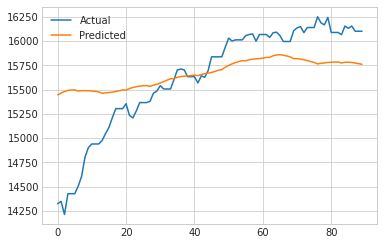

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 5
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 316.315
MAPE: 0.021


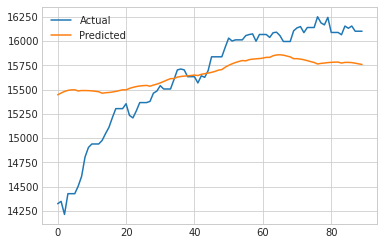

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 5
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 316.714
MAPE: 0.021


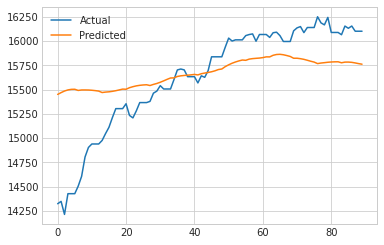

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 5
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 315.891
MAPE: 0.021


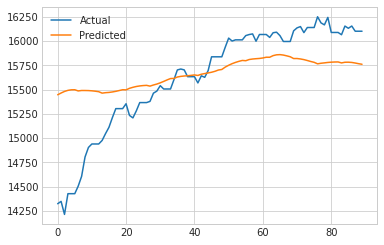

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 5
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 316.971
MAPE: 0.021


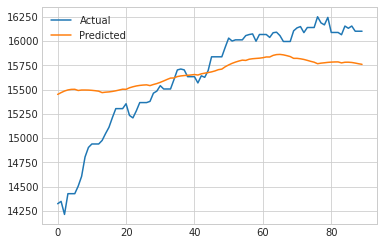

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
i번째 feature:캐나다지수    changepoint prior scale: 6
seasonality_prior_scale: 10    holidays_prior_scale10    fourier_order: 4
MAE: 315.745
MAPE: 0.021


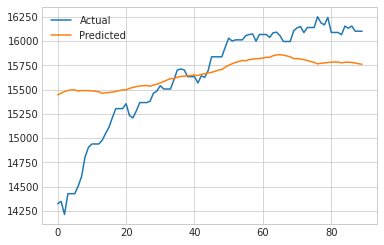

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 6
seasonality_prior_scale: 15    holidays_prior_scale10    fourier_order: 4
MAE: 315.525
MAPE: 0.021


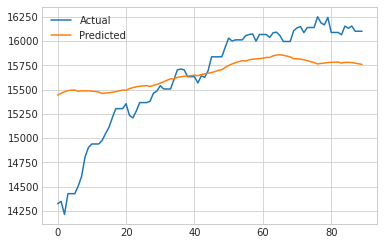

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 6
seasonality_prior_scale: 20    holidays_prior_scale10    fourier_order: 4
MAE: 315.248
MAPE: 0.021


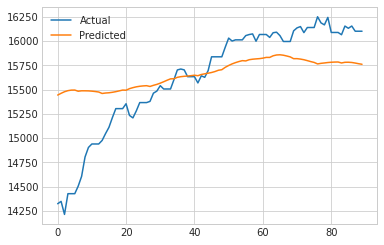

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 6
seasonality_prior_scale: 25    holidays_prior_scale10    fourier_order: 4
MAE: 315.343
MAPE: 0.021


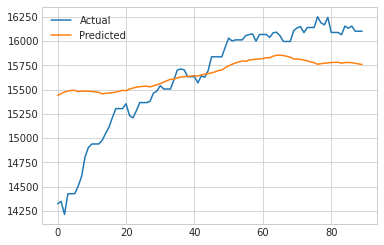

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


--------------------------------------------------------------------------------------------------------------
i번째 feature:캐나다지수    changepoint prior scale: 6
seasonality_prior_scale: 30    holidays_prior_scale10    fourier_order: 4
MAE: 315.694
MAPE: 0.021


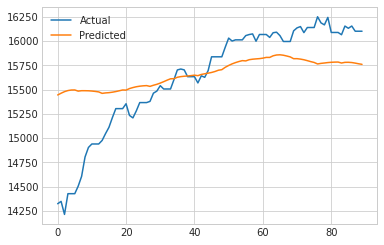

--------------------------------------------------------------------------------------------------------------
------b parameter is completed------
------a parameter is completed------


In [77]:

df_1= df.T
for i in range(4,31):
  for a in range(1,7):
    for b in range(10,35,5):
      for c in range(10,11):
        for d in range(4,5):


          y_tt = prophetm(df, i, 12, 90, 0.05*a, b ,c,30.5, d)
          y_tt = pd.DataFrame(y_tt)
          y_tt = y_tt.T
          y_tt = y_tt.rename(columns ={0:'y_pred',1:'ds'})

          y_tr = prophety(df, i, 90)
          y_tr = pd.DataFrame(y_tr)
          y_tr = y_tr.T
          y_tr = y_tr.rename(columns ={0:'y_true',1:'ds'})

          y_pred = y_tt['y_pred'].values
          y_true = y_tr['y_true'].values
          mae = mean_absolute_error(y_true, y_pred)
          mape = mean_absolute_percentage_error(y_true, y_pred)
          print('i번째 feature:'+str(df_1.index[i])+'    changepoint prior scale: '+str(a))
          print('seasonality_prior_scale: '+str(b)+'    holidays_prior_scale'+str(c)+'    fourier_order: '+str(d))
          print('MAE: %.3f' % mae)
          print('MAPE: %.3f' % mape)
          plt.plot(y_true, label='Actual')
          plt.plot(y_pred, label='Predicted')
          plt.legend()
          plt.show()
          print('--------------------------------------------------------------------------------------------------------------')
    print('------b parameter is completed------')   
  print('------a parameter is completed------')